<a href="https://colab.research.google.com/github/Putri1106/Deteksi-Plat-Nomor/blob/main/Kel4_Transportasi_DeteksiPlat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [22]:
!pip install roboflow # Menginstal pustaka Roboflow untuk manajemen dataset dan model computer vision.

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.5/81.5 kB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 5.2 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [23]:
!pip install pytesseract # Menginstal pustaka Python untuk mengakses Tesseract OCR.
!sudo apt install tesseract-ocr # Menginstal aplikasi Tesseract OCR di sistem berbasis Linux.

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 49 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 2s (3,207 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

In [24]:
# Mengimpor library yang diperlukan
import os  # Untuk bekerja dengan file dan direktori
import glob  # Untuk pencarian file dengan pola tertentu
from roboflow import Roboflow  # Untuk mengunduh dataset dari Roboflow
from PIL import Image  # Untuk manipulasi gambar
import cv2  # Untuk membaca dan memproses gambar
import numpy as np  # Untuk manipulasi array dan data numerik
import matplotlib.pyplot as plt  # Untuk visualisasi data
import pandas as pd  # Untuk manipulasi data tabular
import pytesseract  # Untuk Optical Character Recognition (OCR)

# Inisialisasi roboflow untuk mengunduh dataset baru
rf = Roboflow(api_key="rNTIZ0w8wQufXvTb9bXp")  # Menggunakan API key Roboflow
project = rf.workspace("parkets").project("anpr-test-py7gr")  # Akses proyek di Roboflow
version = project.version(2)  # Memilih versi dataset
dataset = version.download("yolov11")  # Mengunduh dataset ke lokasi lokal

# Menampilkan lokasi direktori dataset yang diunduh
print(f"Dataset lokasi diunduh: {dataset.location}")

# Menentukan direktori gambar yang ada di dalam dataset
img_dir = dataset.location

# Menentukan ukuran gambar yang akan diproses
IMAGE_SIZE = 224  # Ukuran gambar diubah menjadi 224x224 piksel

# Mencari semua gambar dengan ekstensi .jpg, .png, .jpeg
files = []
for dirname, _, filenames in os.walk(img_dir):  # Melintasi direktori dataset
    for filename in filenames:
        if filename.endswith(('.jpg', '.jpeg', '.png')):  # Mengecek ekstensi file gambar
            files.append(os.path.join(dirname, filename))  # Menyimpan path gambar

# Menampilkan jumlah gambar yang ditemukan
print(f"Jumlah file gambar yang ditemukan: {len(files)}")
print(f"Beberapa file gambar yang ditemukan: {files[:5]}")  # Menampilkan 5 file pertama

# Membaca dan mengubah ukuran gambar
X = []  # Array untuk menyimpan gambar yang sudah diproses
for f1 in files:
    img = cv2.imread(f1)  # Membaca gambar menggunakan OpenCV
    if img is not None:  # Memastikan gambar berhasil dibaca
        img = cv2.resize(img, (IMAGE_SIZE, IMAGE_SIZE))  # Mengubah ukuran gambar
        X.append(np.array(img))  # Menambahkan gambar ke array dataset
    else:
        print(f"Warning: Unable to read image at {f1}")  # Peringatan jika gagal membaca gambar

# Verifikasi ukuran dataset setelah gambar dimuat
print(f"Jumlah gambar yang berhasil dimuat: {len(X)}")
print(f"Dimensi dataset (jumlah gambar, tinggi, lebar, saluran): {np.array(X).shape}")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to ANPR-test-2 in yolov11:: 100%|██████████| 1153/1153 [00:00<00:00, 4386.30it/s]


Dataset lokasi diunduh: /content/ANPR-test-2
Jumlah file gambar yang ditemukan: 572
Beberapa file gambar yang ditemukan: ['/content/ANPR-test-2/train/images/136-E-3916-P-05-21_jpg.rf.581874874462a46bd6080c95ca4659a9.jpg', '/content/ANPR-test-2/train/images/IMG-20180108-WA0040_jpg.rf.b58330dde4279524f7ed1d5c4cf22fb9.jpg', '/content/ANPR-test-2/train/images/IMG-20180108-WA0082_jpg.rf.858ac8c77dd914b62d72ab093c107d03.jpg', '/content/ANPR-test-2/train/images/230-E-3203-TR-11-17_jpg.rf.668eca2862d0e41ce3363af18afe9a56.jpg', '/content/ANPR-test-2/train/images/316-E-4895-OL-09-19_jpeg.rf.f7d1760f6b9f5b89ae3b35ce748b3a9e.jpg']
Jumlah gambar yang berhasil dimuat: 572
Dimensi dataset (jumlah gambar, tinggi, lebar, saluran): (572, 224, 224, 3)


In [25]:
# Untuk menghubungkan Google Drive ke Google Colab
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


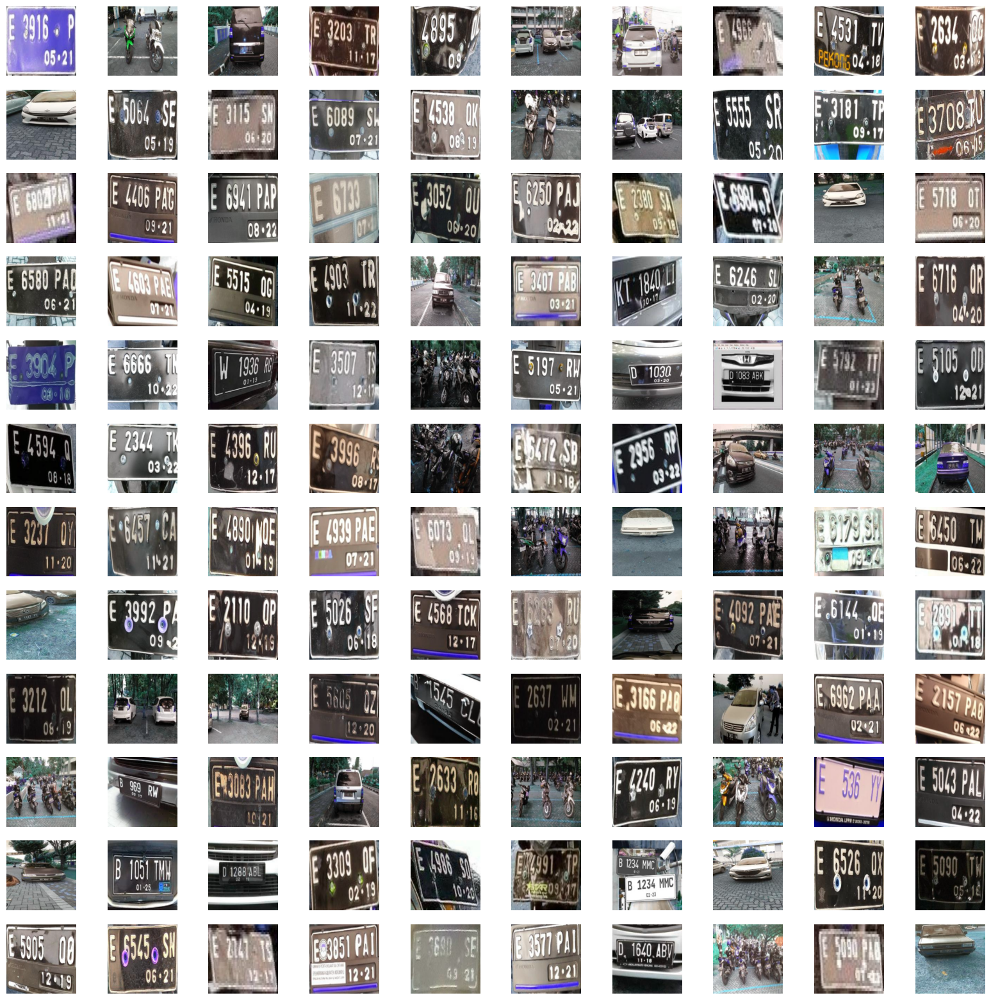

In [26]:
# Menentukan jumlah gambar yang ingin ditampilkan dan ukuran grid
num_images = len(X)  # Jumlah total gambar yang berhasil dimuat
rows = 12  # Jumlah baris pada grid
cols = 10  # Jumlah kolom pada grid

# Menampilkan semua gambar yang berhasil dimuat
plt.figure(figsize=(20, 20))  # Mengatur ukuran tampilan grid (20x20 inci)
for i in range(0, num_images):
    if i + 1 > rows * cols:  # Memeriksa apakah jumlah gambar melebihi kapasitas grid
        print(f"Warning: Skipping image {i + 1} as it exceeds the grid size.")  # Pesan peringatan
        break  # Menghentikan loop jika grid penuh
    plt.subplot(rows, cols, i + 1)  # Membuat subplot untuk setiap gambar
    plt.axis('off')  # Menyembunyikan sumbu subplot
    plt.imshow(X[i])  # Menampilkan gambar dari array X
plt.show()  # Menampilkan seluruh gambar di grid

In [ ]:
# Menentukan path direktori tempat gambar disimpan
image_path = "/content/ANPR-test-2/valid/images"  # Lokasi folder yang berisi gambar

# Inisialisasi array untuk menyimpan gambar yang dimuat
X = []  # Array kosong untuk menampung gambar yang diubah menjadi array NumPy

# Melintasi semua file gambar dalam direktori
for img_file in os.listdir(image_path):  # Menggunakan os.listdir untuk membaca semua file di dalam folder
    img = Image.open(os.path.join(image_path, img_file))  # Membuka file gambar menggunakan Pillow (PIL)
    X.append(np.array(img))  # Mengonversi gambar ke dalam bentuk array NumPy dan menambahkannya ke array X

# Menampilkan jumlah gambar yang berhasil dimuat
print(f"Jumlah gambar yang dimuat: {len(X)}")  # Menampilkan jumlah gambar dalam array X

Jumlah gambar yang dimuat: 167


In [28]:
image_dir = "/content/DatasetPlatNomor/valid/images" #Dua variabel string menyimpan jalur direktori untuk gambar (image_dir) dan label (label_dir)
label_dir = "/content/DatasetPlatNomor/valid/labels"

image_files = os.listdir(image_dir) #Fungsi os.listdir(image_dir) digunakan untuk mendapatkan daftar nama semua file di dalam direktori gambar (image_dir). Variabel image_files sekarang berisi nama-nama file seperti "image1.jpg", "image2.jpg", dll.
for image_file in image_files: #Loop for iterasi melalui setiap nama file di dalam image_files
    label_file = os.path.join(label_dir, image_file.replace('.jpg', '.txt')) #Nama file label dihitung dengan mengganti ekstensi file gambar .jpg menjadi .txt menggunakan replace('.jpg', '.txt')
    if os.path.exists(label_file): #Fungsi os.path.exists(label_file) memeriksa apakah file label yang dihasilkan (label_file) ada di direktori label_dir
        print(f"Label ditemukan untuk {image_file}") #Jika file label ditemukan, mencetak pesan seperti "Label ditemukan untuk image1.jpg"
    else:
        print(f"Label tidak ditemukan untuk {image_file}") #Jika file label tidak ditemukan, mencetak pesan seperti "Label tidak ditemukan untuk image2.jpg"

Label ditemukan untuk 141-E-3860-PAK-02-22_jpeg.rf.354dfd47611f965c7f2f17d34b120e5e.jpg
Label ditemukan untuk 294-E-2381-QAA-10-22_jpeg.rf.e5535c862ed012c724d1d824efce2ee9.jpg
Label ditemukan untuk 344-E-6393-TZ-07-18_jpeg.rf.929eb4ce4557f1d0b7cc139231421c4c.jpg
Label ditemukan untuk 357-E-4679-PAD-06-21_jpg.rf.eb065d4dfef48e7a3d4aec0a52969428.jpg
Label ditemukan untuk 154-E-6151-PAL-04-22_jpg.rf.9786b8a7ba41a4779e368dbfdbf0d97f.jpg
Label ditemukan untuk license-5-_jpg.rf.6c5fdf0d740a7859ebe451116015b62c.jpg
Label ditemukan untuk IMG-20180108-WA0069_jpg.rf.d59315a2c4227f20b2b3a57f2a481f37.jpg
Label ditemukan untuk 196-E-6843-SV-06-21_jpeg.rf.0cf5a81a45ae4eb3ac1301f6700ecb0d.jpg
Label ditemukan untuk IMG-20180108-WA0114_jpg.rf.cd14204e51866839c3c7dcb335552d63.jpg
Label ditemukan untuk 231-E-5639-PAP-08-22_jpg.rf.9997f8846286e580187613f00d7039a6.jpg
Label ditemukan untuk 293-E-2509-OW-09-20_jpg.rf.b5040df5ebdf03b9526f40389fe1c8e6.jpg
Label ditemukan untuk 145-E-2035-SO-07-20_jpeg.rf.c65c

Label ditemukan untuk 141-E-3860-PAK-02-22_jpeg.rf.354dfd47611f965c7f2f17d34b120e5e.jpg


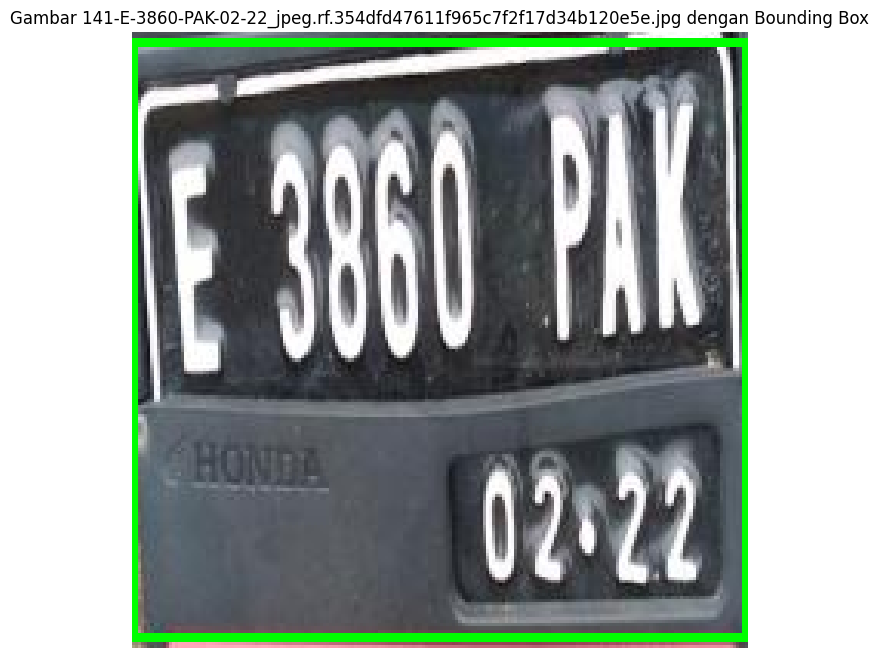

Label ditemukan untuk 294-E-2381-QAA-10-22_jpeg.rf.e5535c862ed012c724d1d824efce2ee9.jpg


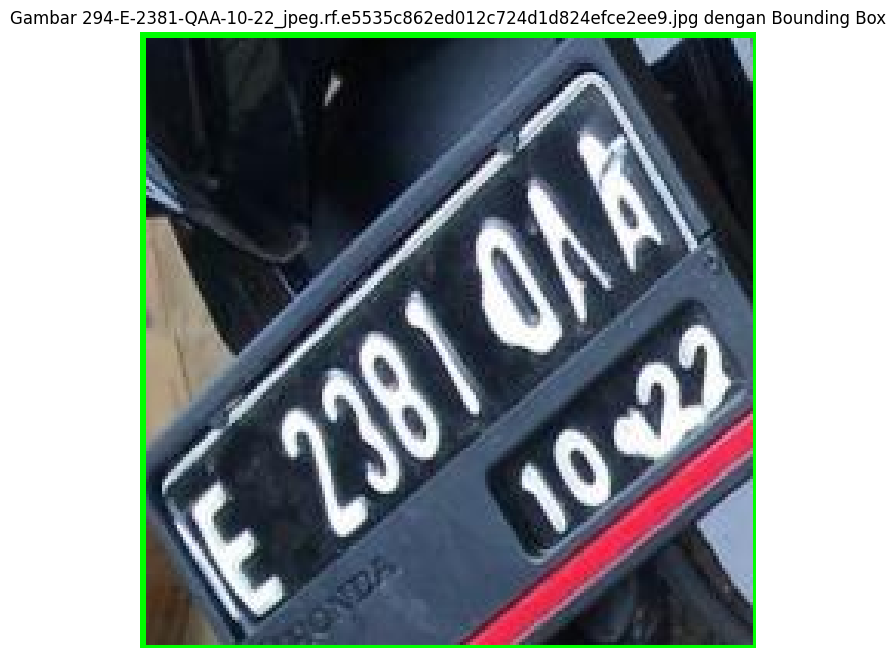

Label ditemukan untuk 344-E-6393-TZ-07-18_jpeg.rf.929eb4ce4557f1d0b7cc139231421c4c.jpg


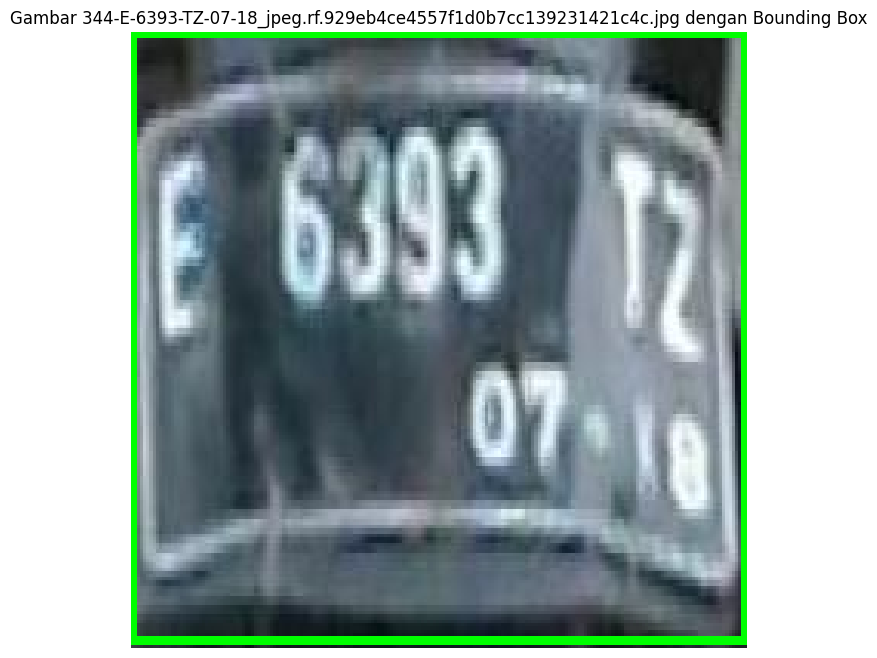

Label ditemukan untuk 357-E-4679-PAD-06-21_jpg.rf.eb065d4dfef48e7a3d4aec0a52969428.jpg


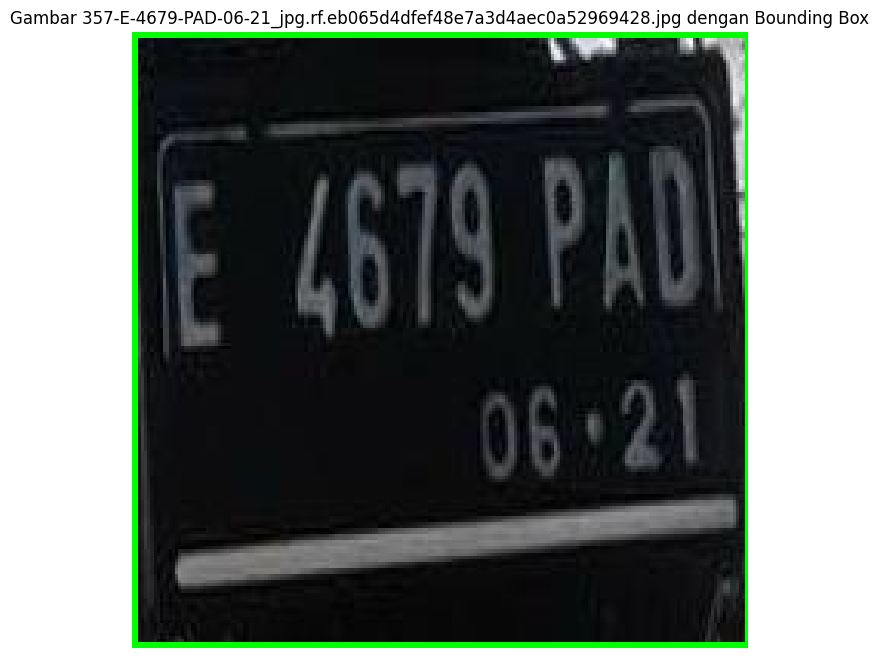

Label ditemukan untuk 154-E-6151-PAL-04-22_jpg.rf.9786b8a7ba41a4779e368dbfdbf0d97f.jpg


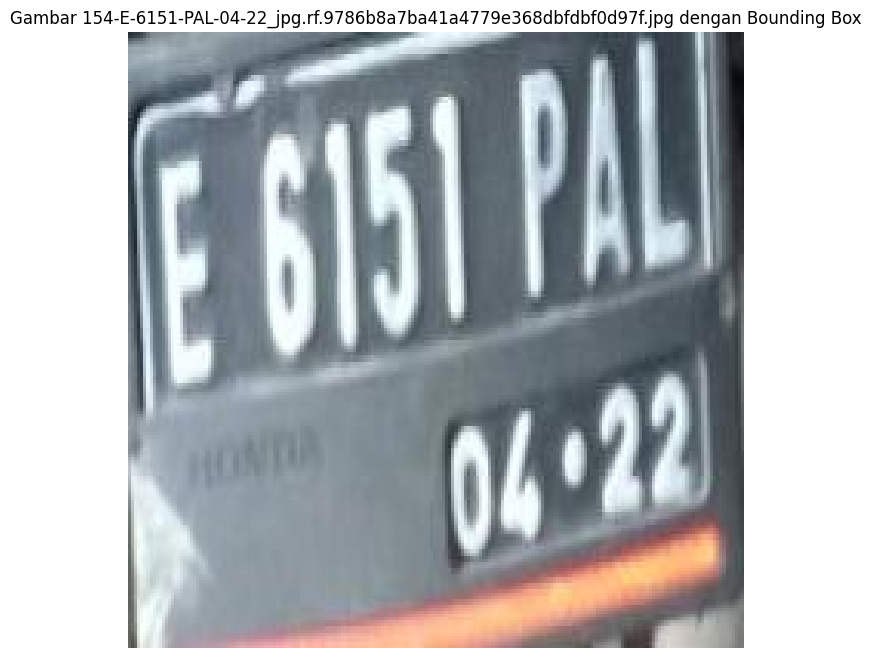

Label ditemukan untuk license-5-_jpg.rf.6c5fdf0d740a7859ebe451116015b62c.jpg


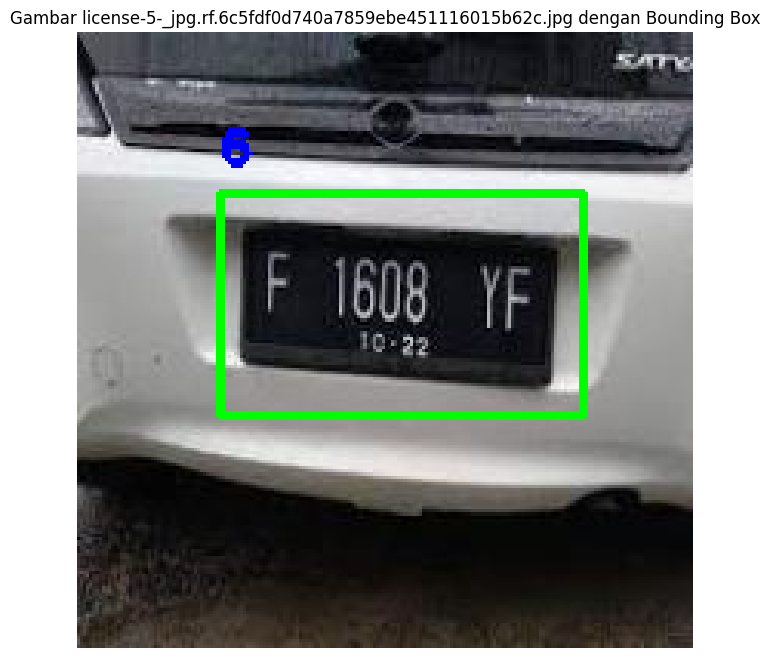

Label ditemukan untuk IMG-20180108-WA0069_jpg.rf.d59315a2c4227f20b2b3a57f2a481f37.jpg


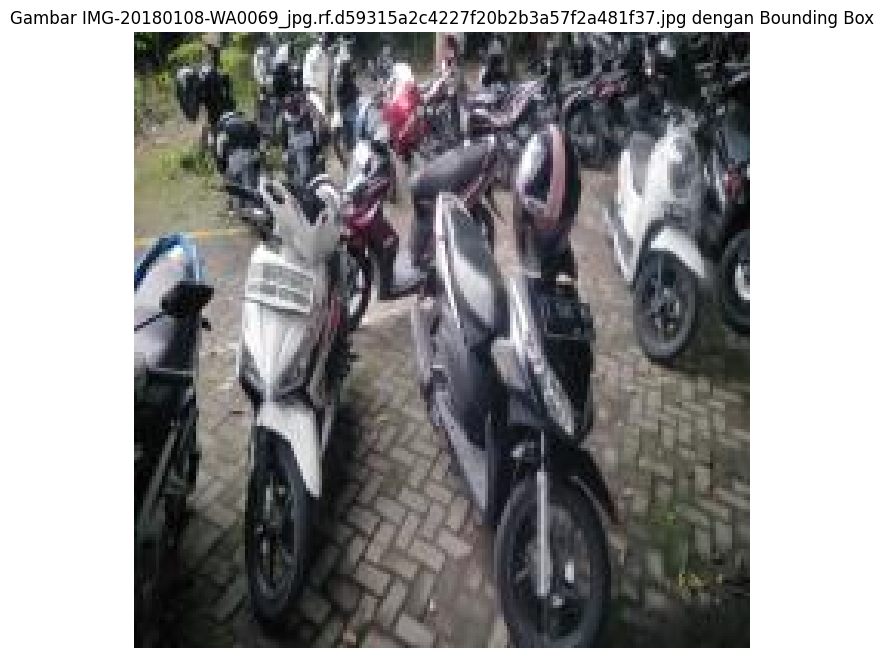

Label ditemukan untuk 196-E-6843-SV-06-21_jpeg.rf.0cf5a81a45ae4eb3ac1301f6700ecb0d.jpg


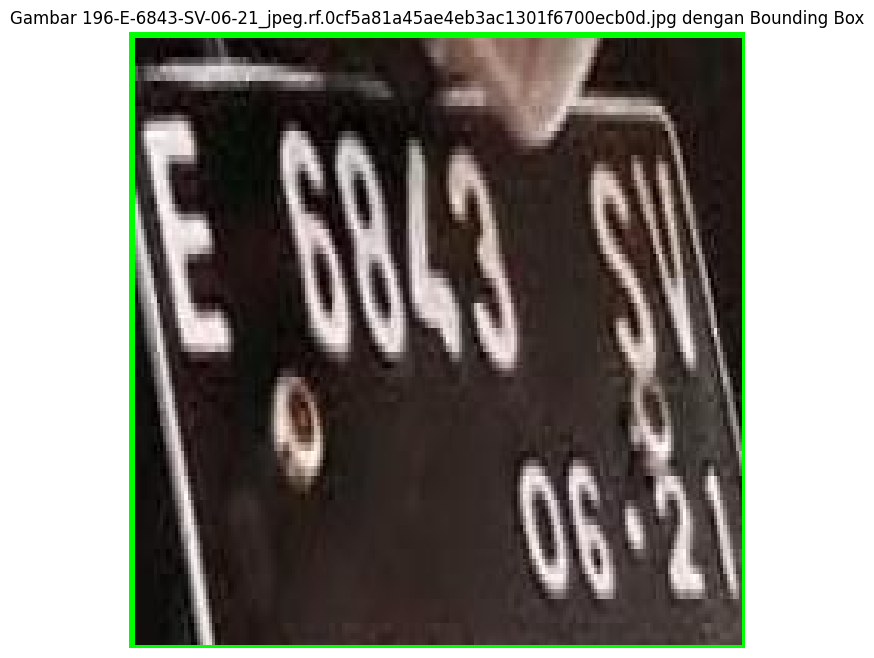

Label ditemukan untuk IMG-20180108-WA0114_jpg.rf.cd14204e51866839c3c7dcb335552d63.jpg


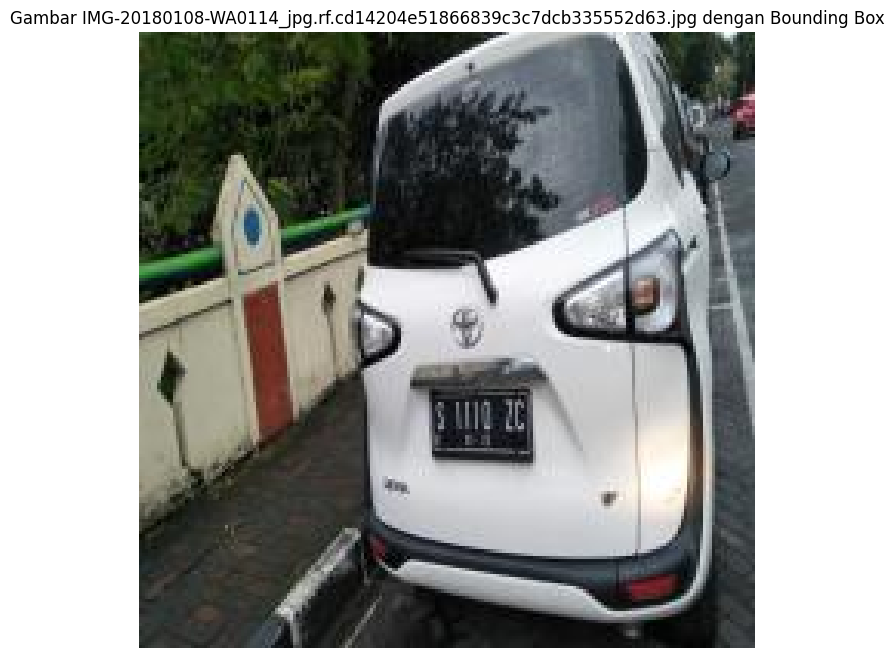

Label ditemukan untuk 231-E-5639-PAP-08-22_jpg.rf.9997f8846286e580187613f00d7039a6.jpg


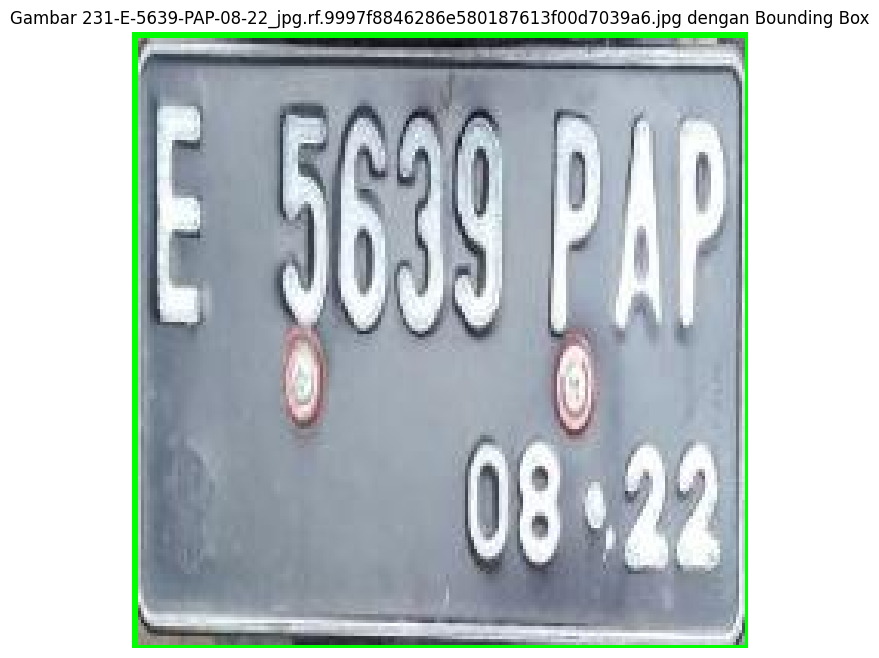

Label ditemukan untuk 293-E-2509-OW-09-20_jpg.rf.b5040df5ebdf03b9526f40389fe1c8e6.jpg


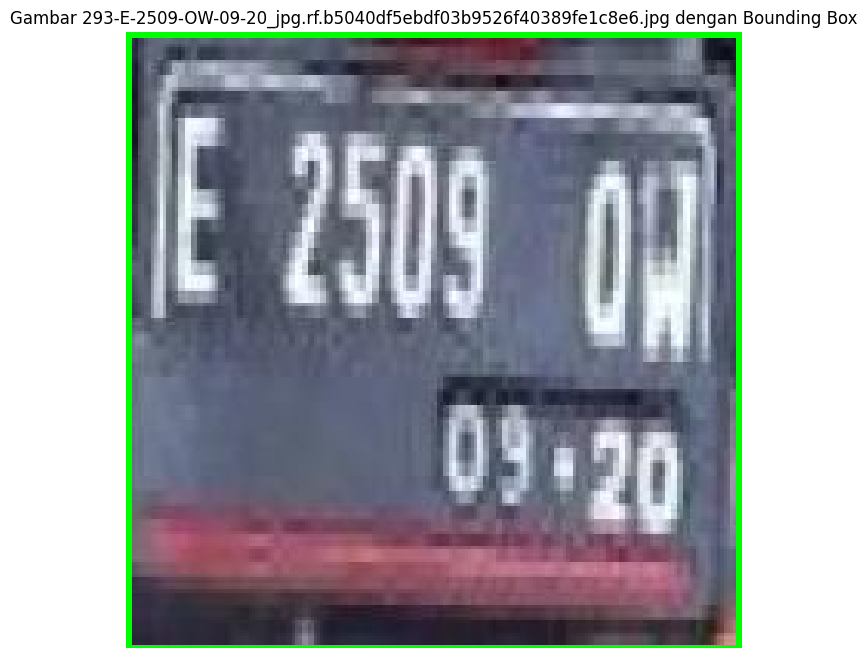

Label ditemukan untuk 145-E-2035-SO-07-20_jpeg.rf.c65c917bc6bcc70ea05bdf0614b2400d.jpg


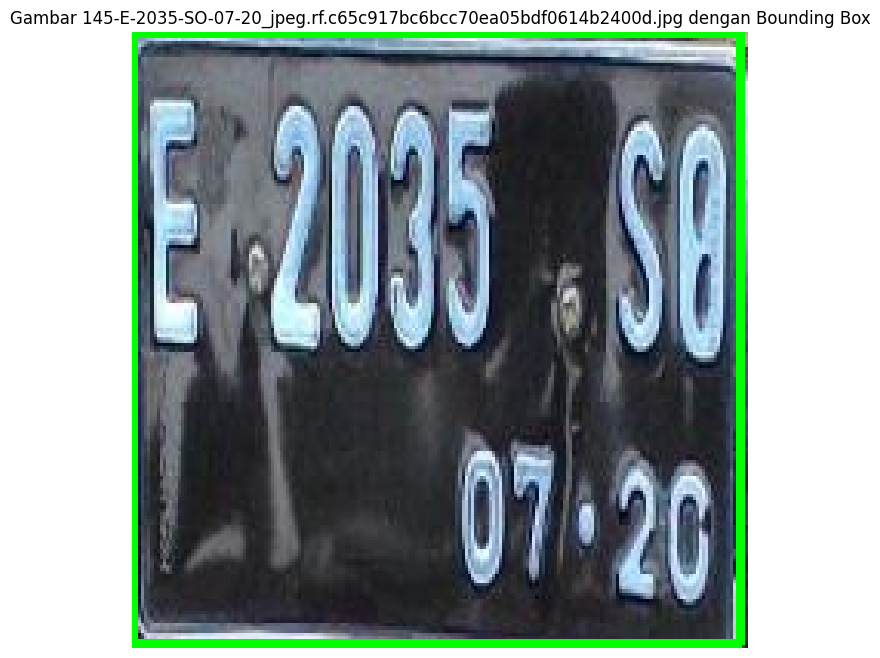

Label ditemukan untuk IMG_20230519_082748_jpg.rf.d4216c01cee9f15dbfd3ec59136da9cf.jpg


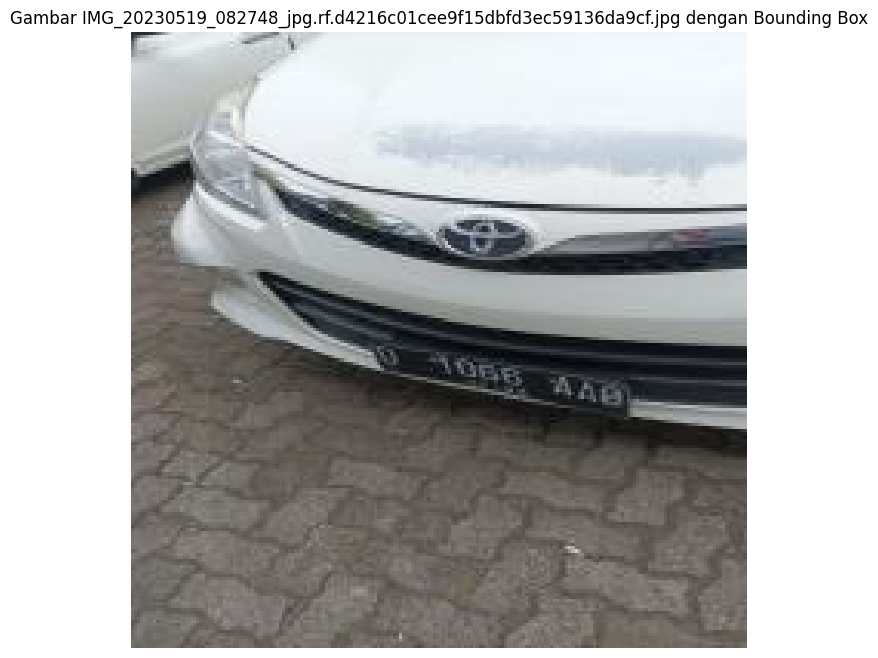

Label ditemukan untuk 240-E-9999-AA-02-19_jpeg.rf.2587227e50ed7b3693ba90566645aa3b.jpg


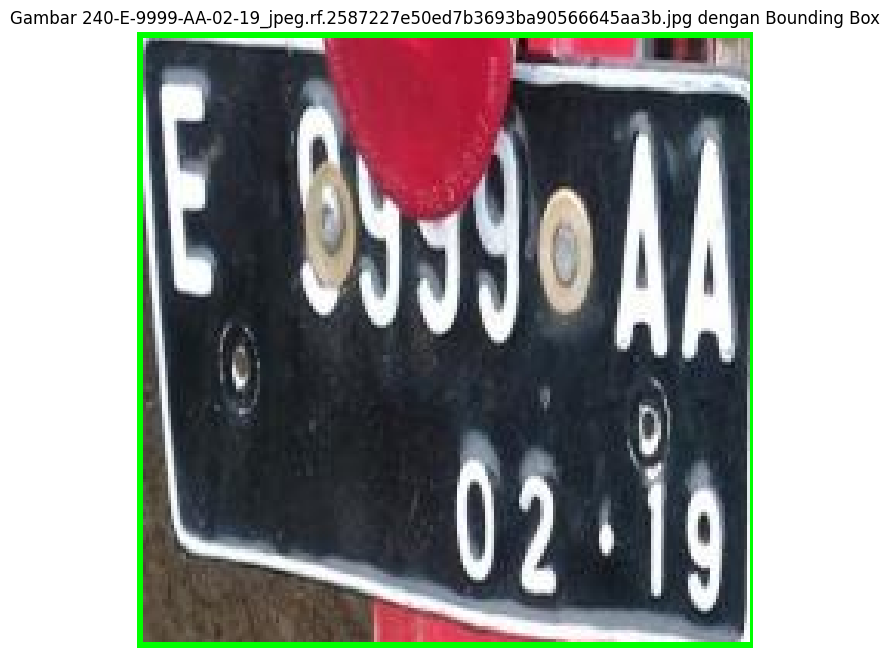

Label ditemukan untuk IMG-20180108-WA0056_jpg.rf.393ca9aa4ad6c233a39c9f9f7dda361b.jpg


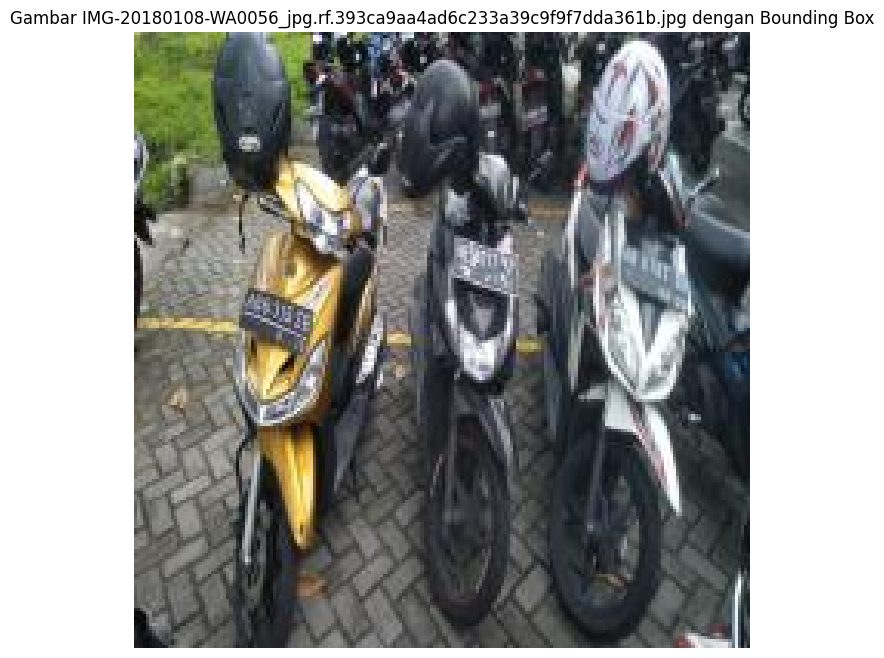

Label ditemukan untuk IMG-20180108-WA0068_jpg.rf.a40c2bf0185c7ec0b2abe31029573577.jpg


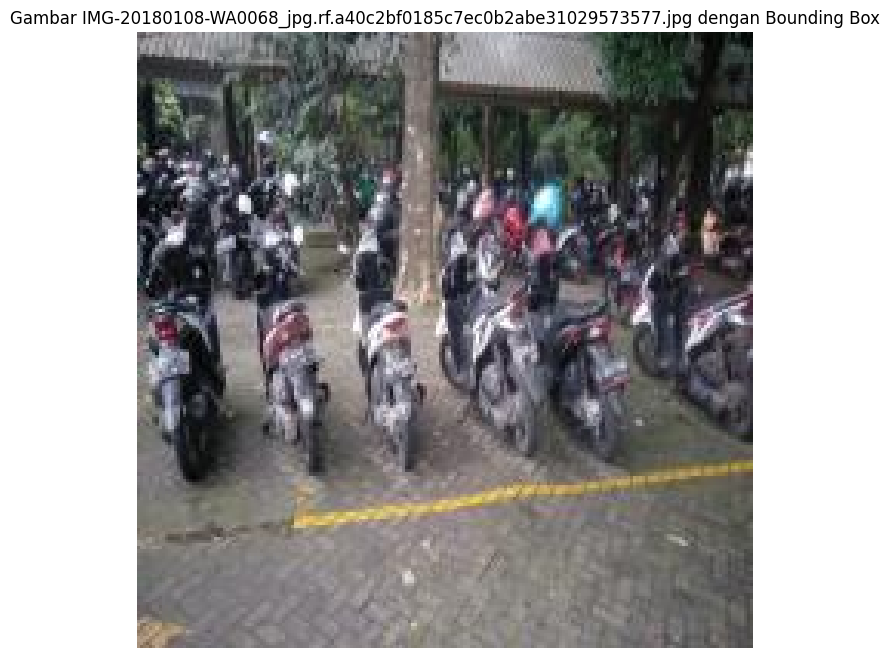

Label ditemukan untuk 232-E-6140-QO-12-19_jpg.rf.1a896a97d563e4f448a0d5ec81937ef6.jpg


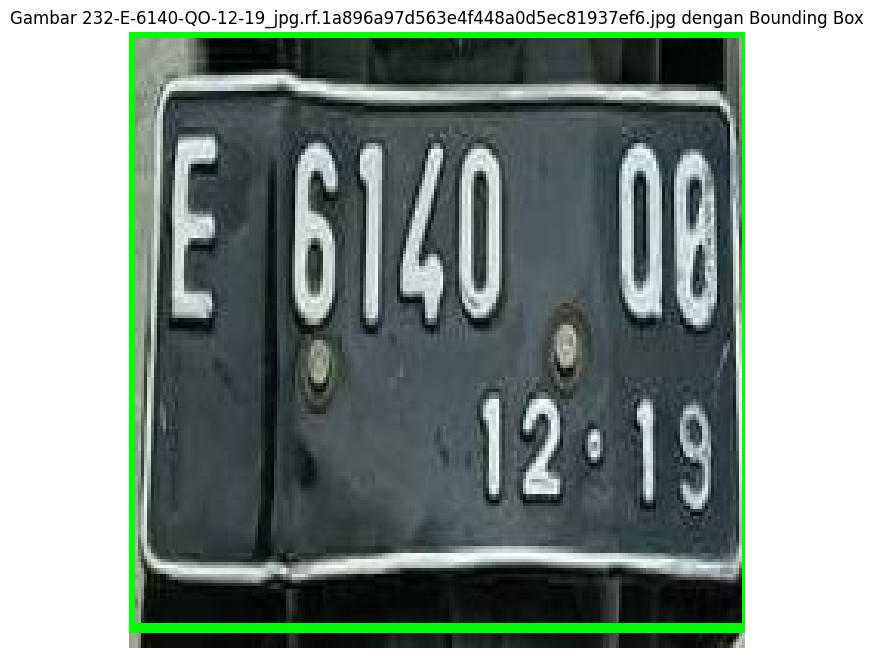

Label ditemukan untuk 77-E-6295-QL-09-19_jpeg.rf.c90d6c4f985be2f7c36eddff96b4ac40.jpg


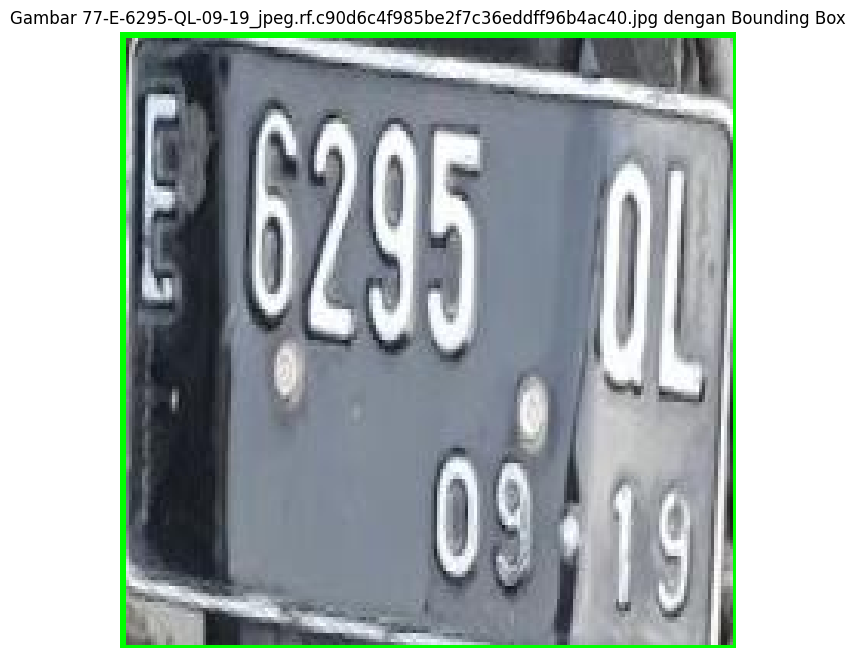

Label ditemukan untuk IMG-20180108-WA0118_jpg.rf.563769c422267f10b896cb971822e169.jpg


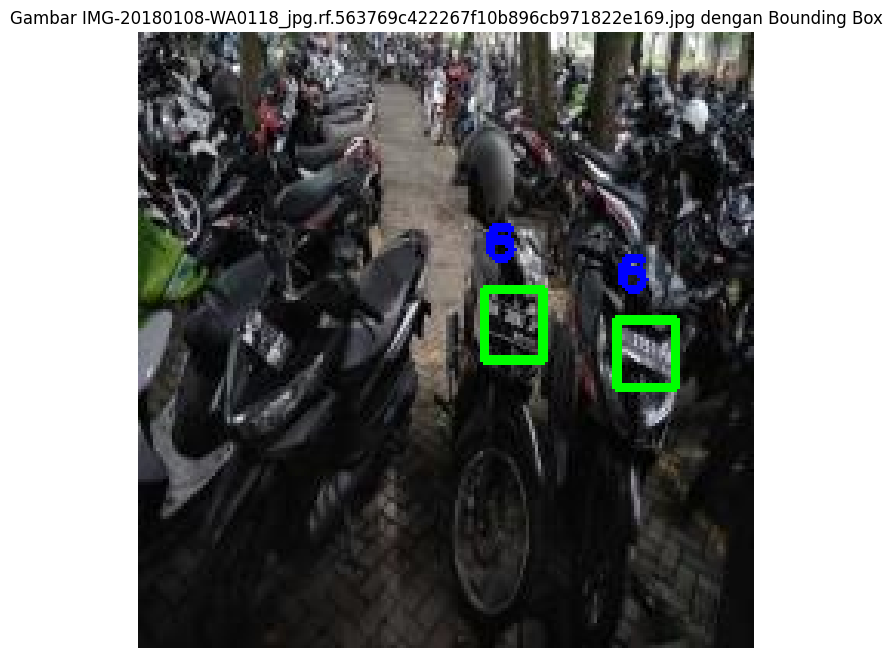

Label ditemukan untuk license-27-_jpg.rf.ec096495ae53a93840786cd2e961efa1.jpg


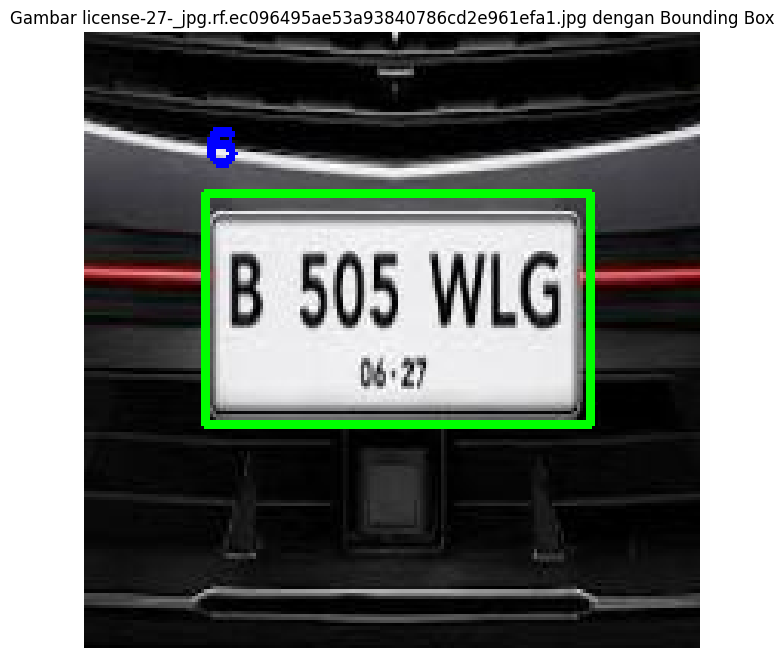

Label ditemukan untuk 110-E-4753-QV-08-20_jpeg.rf.86b7167c12ba7740c6a8505700841f90.jpg


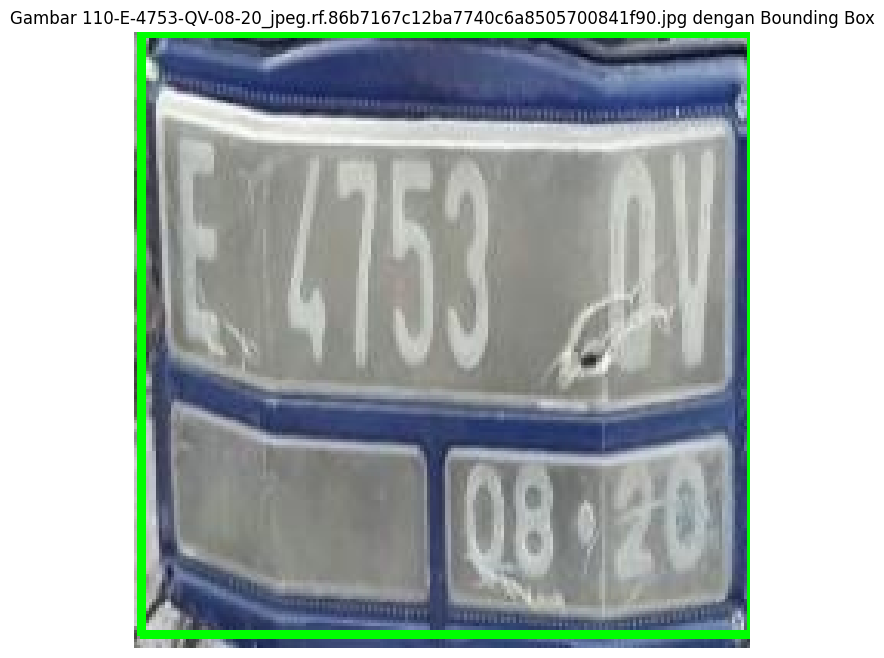

Label ditemukan untuk 59-E-2153-SP-08-20_jpeg.rf.4452496bb13f45f2ee85b92e0d08c969.jpg


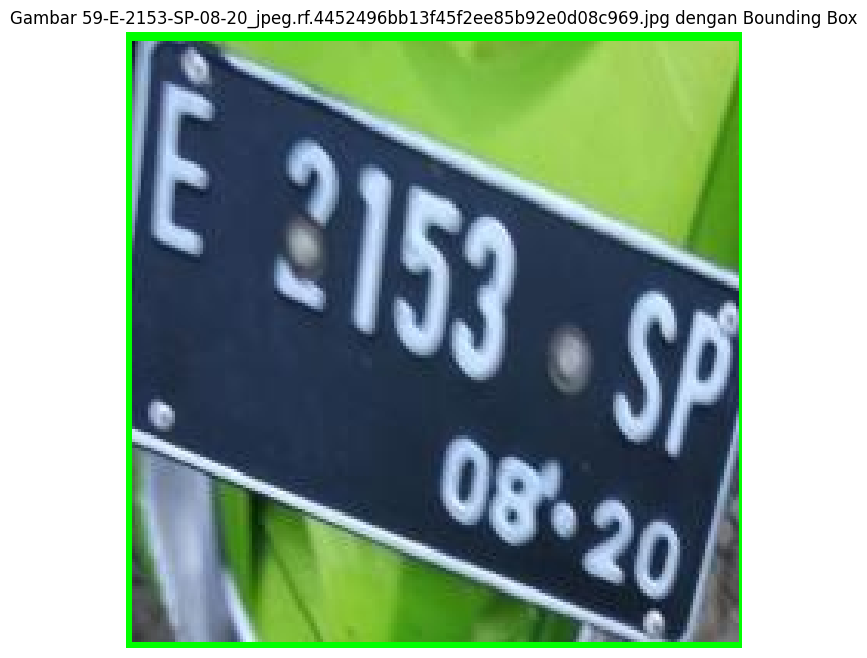

Label ditemukan untuk license-33-_jpg.rf.9884adafdf54ce8a0ca2e9609c57d4b9.jpg


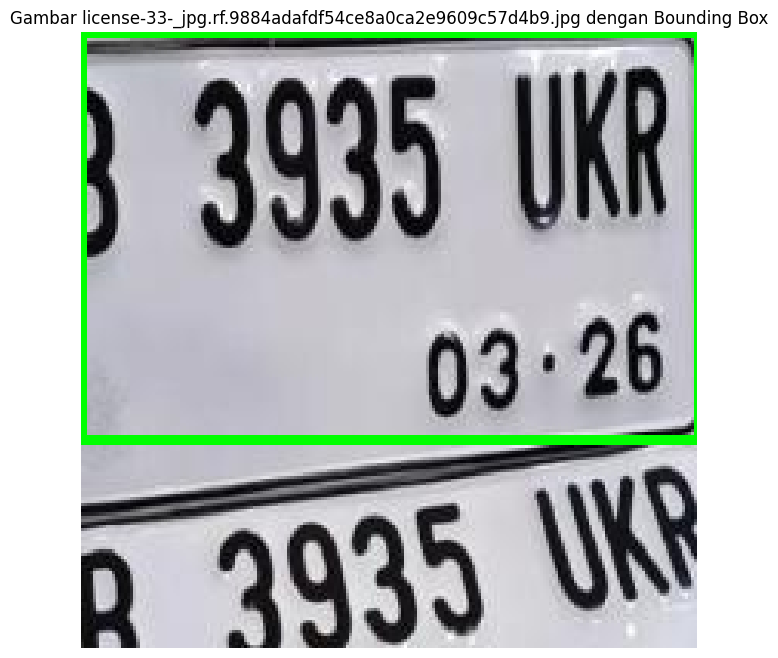

Label ditemukan untuk IMG_20230519_082726_jpg.rf.d96a0d9e8e40db3af84932df0723af17.jpg


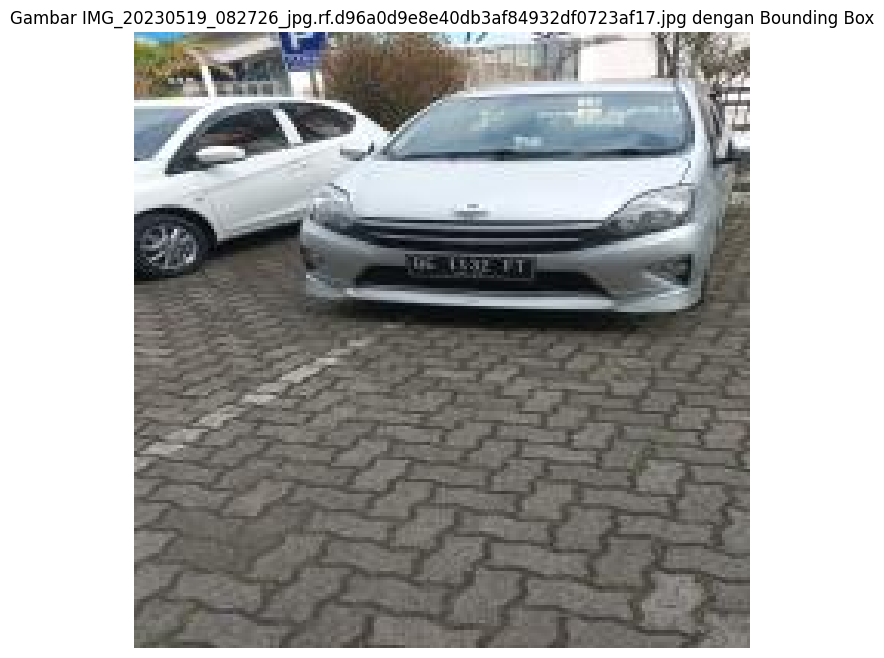

Label ditemukan untuk 83-E-4147-QJ-06-19_jpeg.rf.b109d134fcc8554437a2c6d3ad42714b.jpg


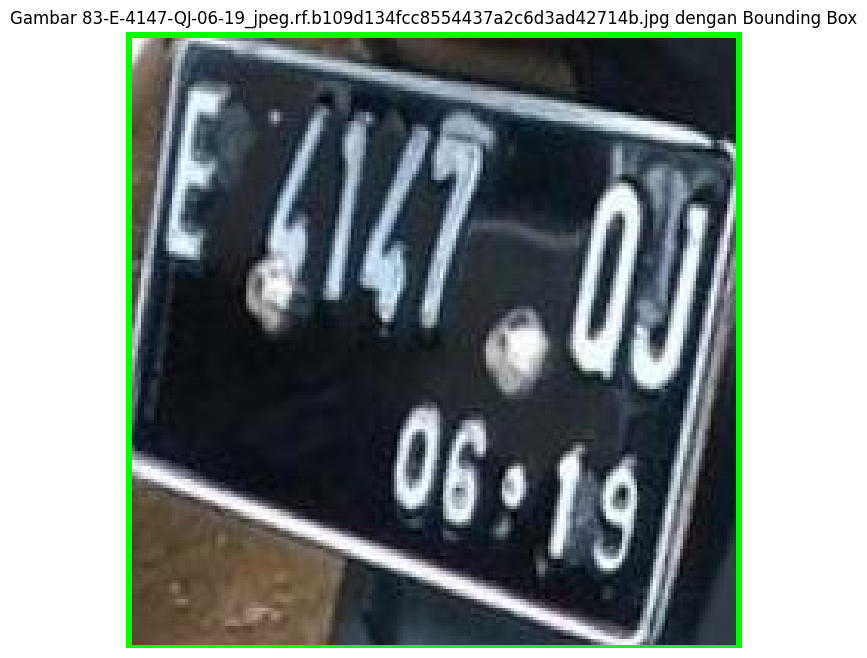

Label ditemukan untuk 66-E-1477-RB-02-21_jpg.rf.fca31b4add6ce2faac97126879609f96.jpg


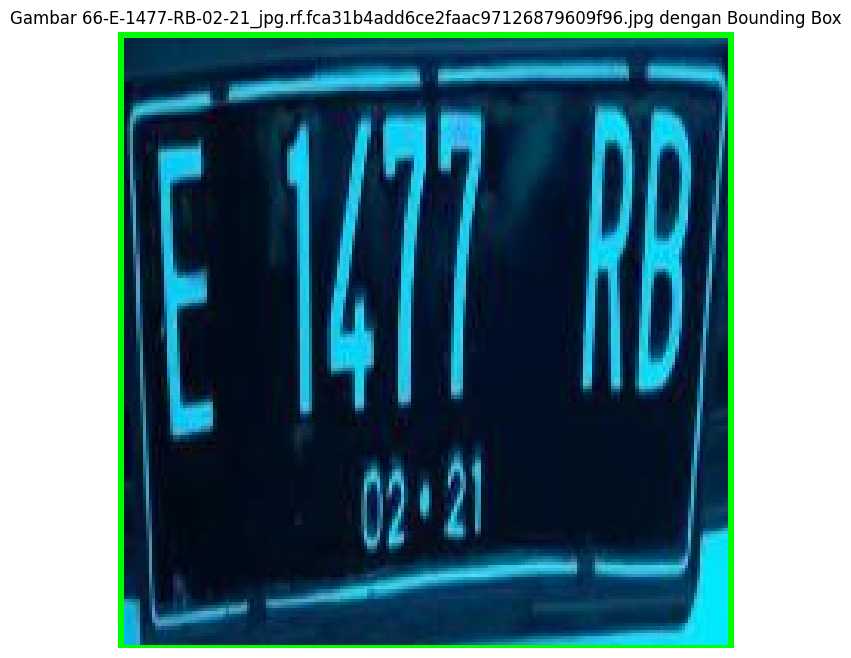

Label ditemukan untuk 56-E-5056-QD-12-18_jpeg.rf.07b7927149db40dd8ac9f816d974d633.jpg


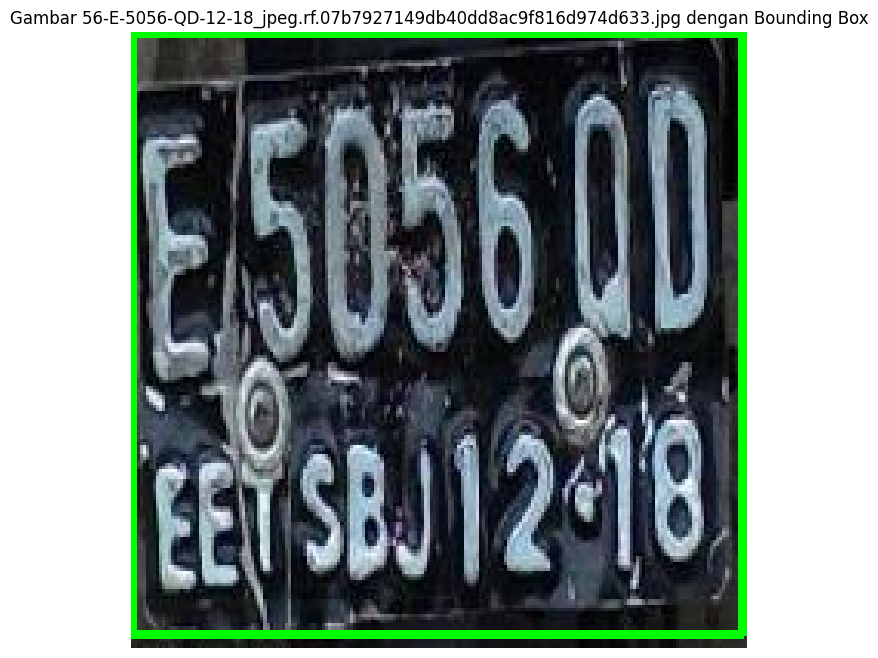

Label ditemukan untuk 193-E-4682-QA-09-22_jpg.rf.b54100ad0c578c27f50c844fb08eb706.jpg


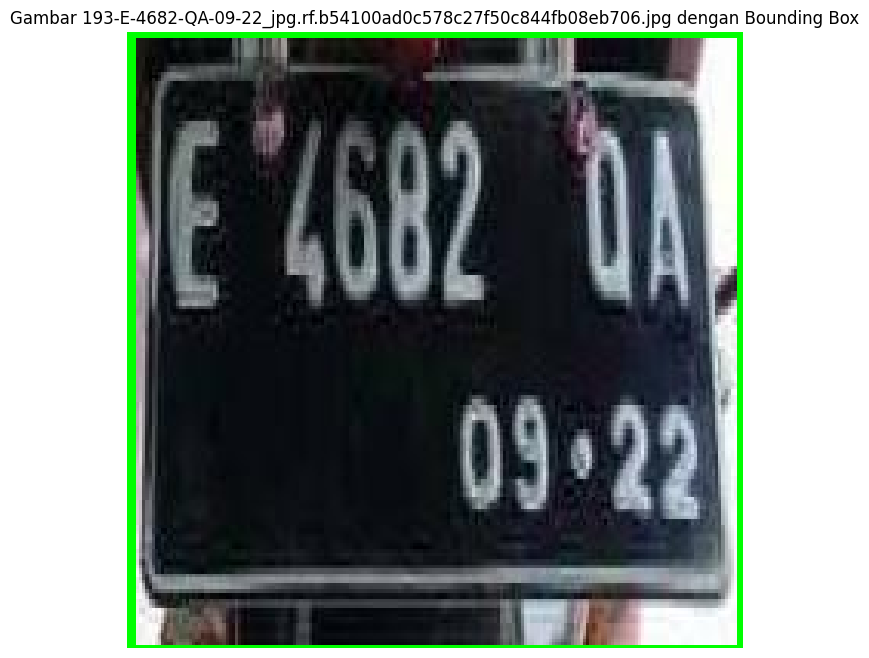

Label ditemukan untuk IMG_20230519_082732_jpg.rf.9976f1a6899a4ee2f8ba48bfa5915f59.jpg


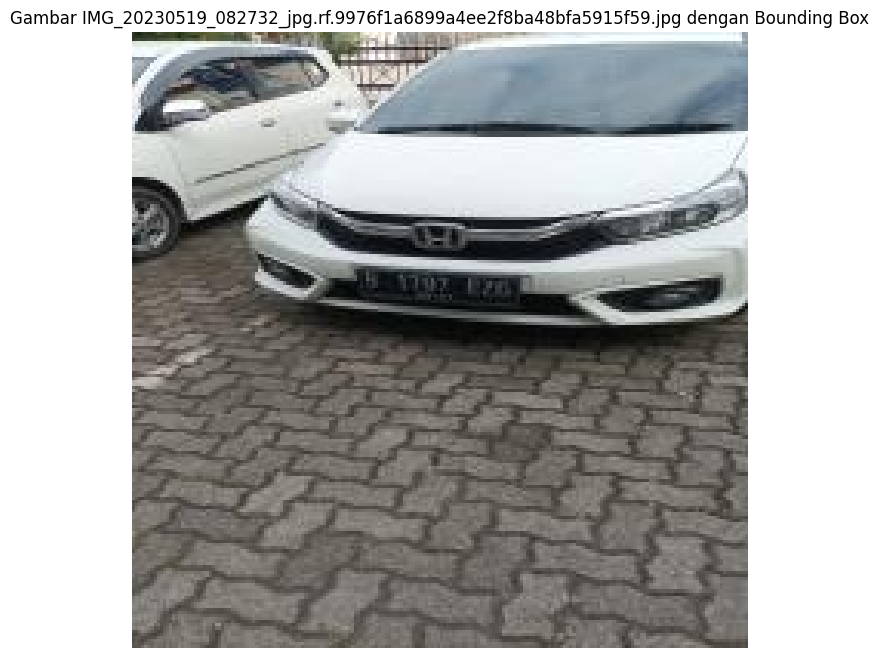

Label ditemukan untuk 4-E-6226-YZ-12-19_jpg.rf.cdb6f24ea9cbe1716034a6d704cb54d5.jpg


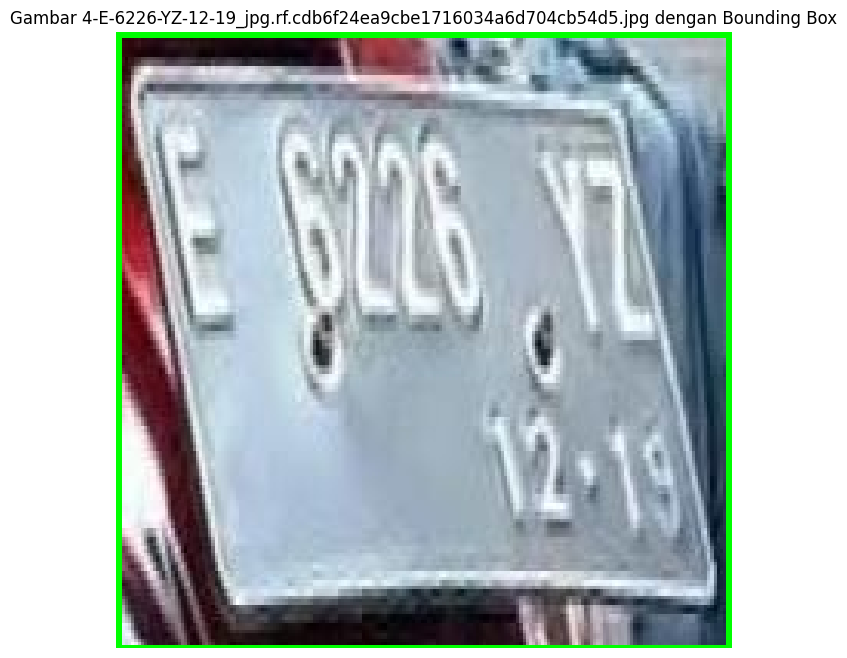

Label ditemukan untuk license-16-_jpg.rf.60ed5c7ed6c26b55c042a5bc6bec8942.jpg


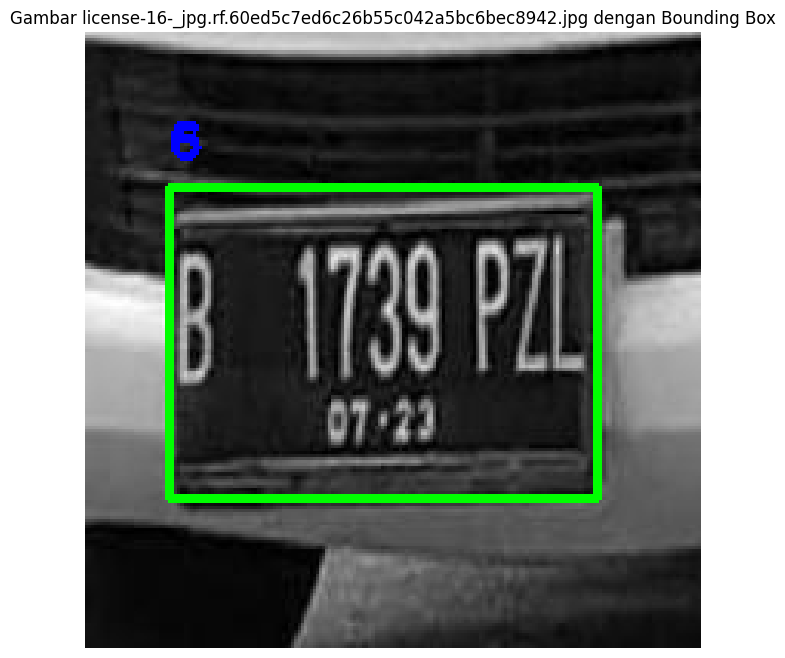

Label ditemukan untuk 118-E-4885-QZ-12-20_jpeg.rf.69ee21947591cf35e614a81451b6e719.jpg


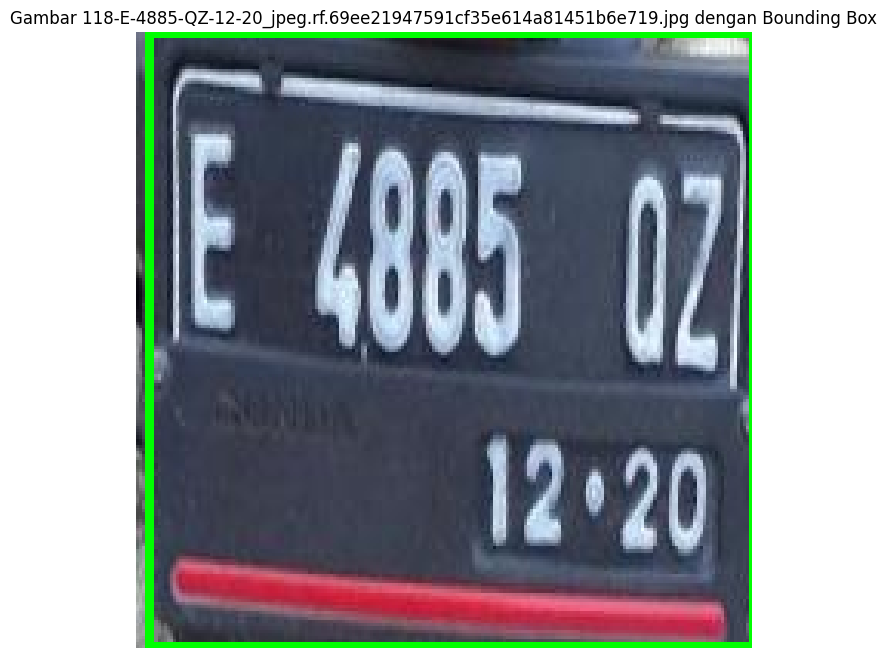

Label ditemukan untuk IMG-20180108-WA0033_jpg.rf.f0524207c74159d870266eb3a7026af1.jpg


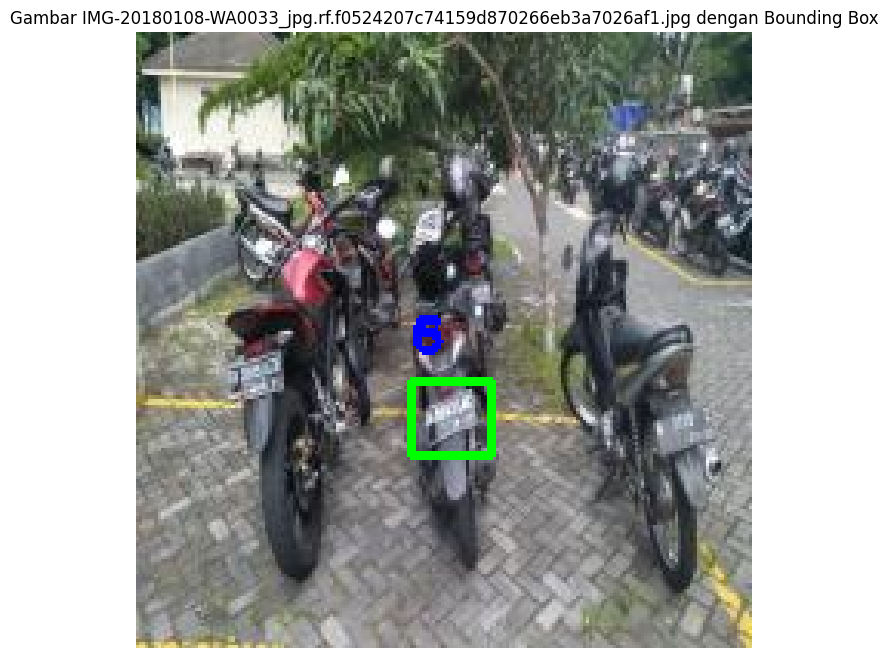

Label ditemukan untuk 20171214_091545_jpg.rf.53931747d00cccc752b61baadaea0e7e.jpg


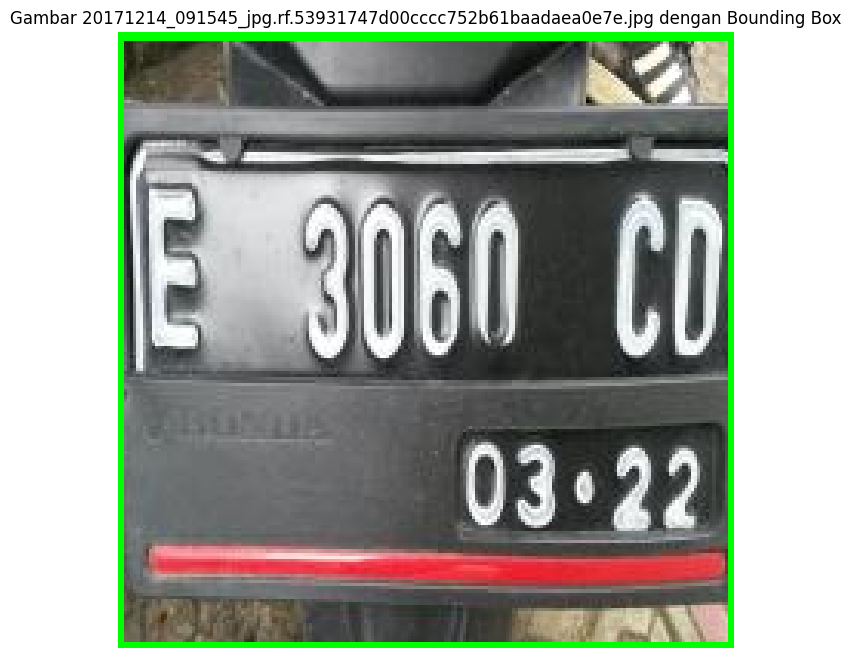

Label ditemukan untuk 226-E-5148-OI-06-13_jpg.rf.8ad3848d898a3883b0e0079f3bd39efc.jpg


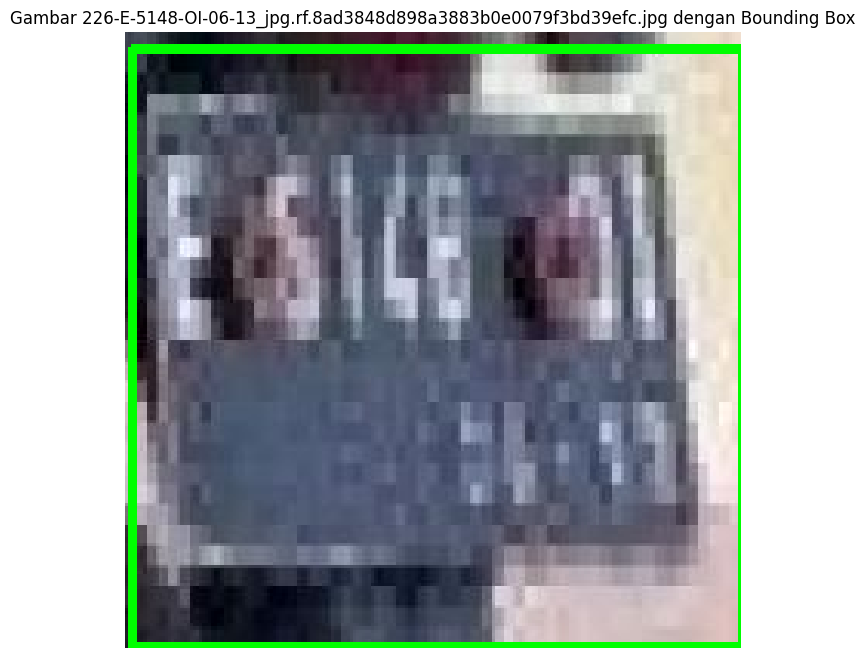

Label ditemukan untuk IMG-20180108-WA0078_jpg.rf.08ef52d58afa12c6fe99932dbf8269f8.jpg


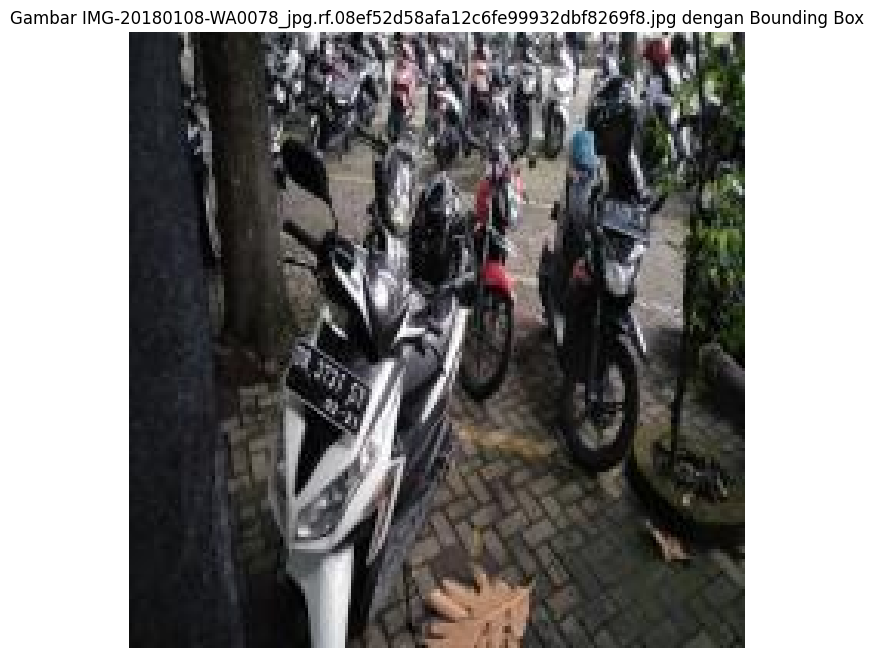

Label ditemukan untuk 21-E-6676-PAH-11-21_jpg.rf.cdf50024310bd0cc2db7189b91f74601.jpg


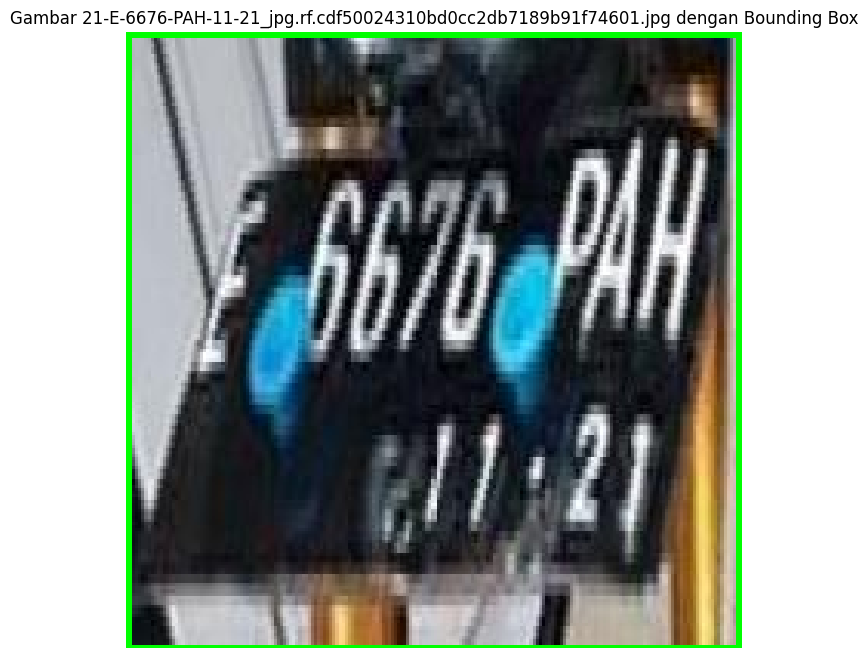

Label ditemukan untuk IMG-20180108-WA0072_jpg.rf.3c07e89926d380ad532b5114bc7c4414.jpg


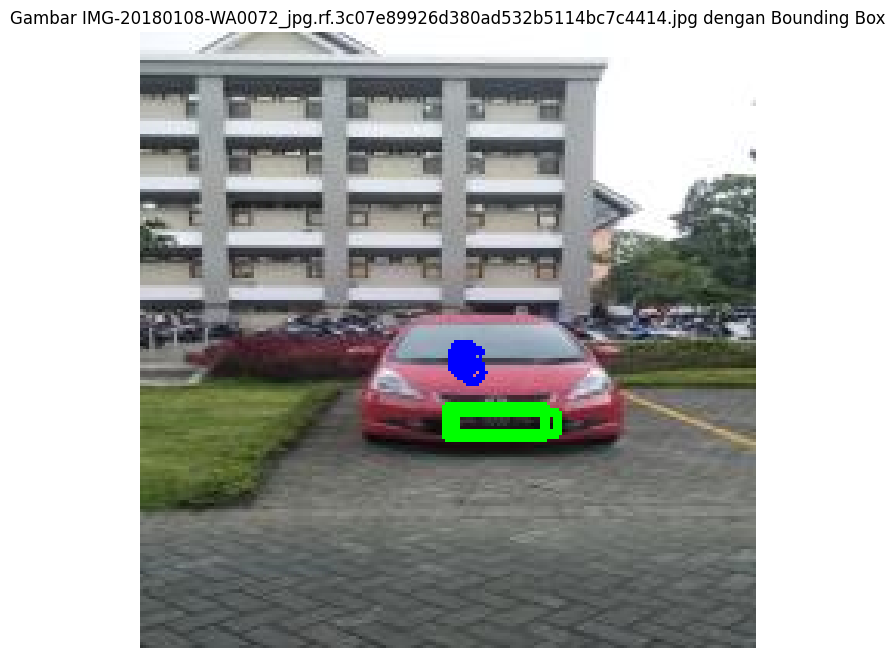

Label ditemukan untuk 13-E-5313-TF-10-16_jpeg.rf.555163f57b3d85ae94253acc3b06ac81.jpg


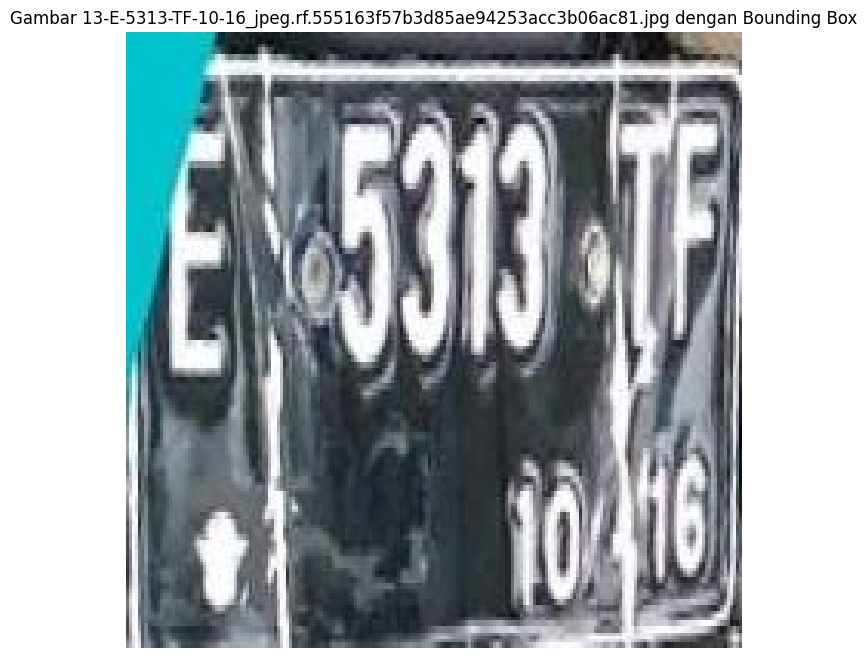

Label ditemukan untuk 43-E-5736-PAQ-09-22_jpeg.rf.06c8a0dd998b27c8d1616c6d6f88dabc.jpg


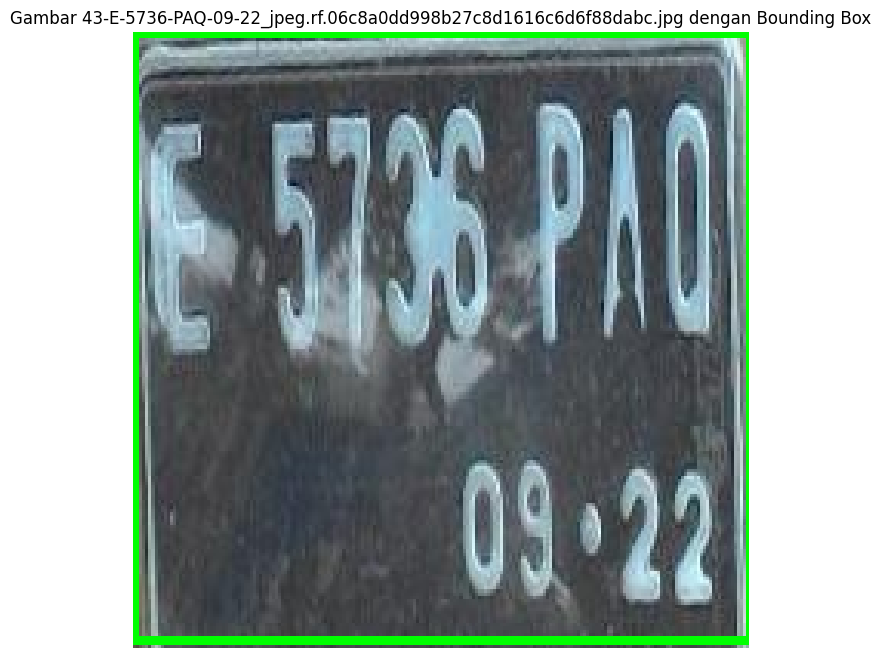

Label ditemukan untuk 289-E-6810-TX-06-18_jpeg.rf.7917aced625a65aa3205fc7272abcb06.jpg


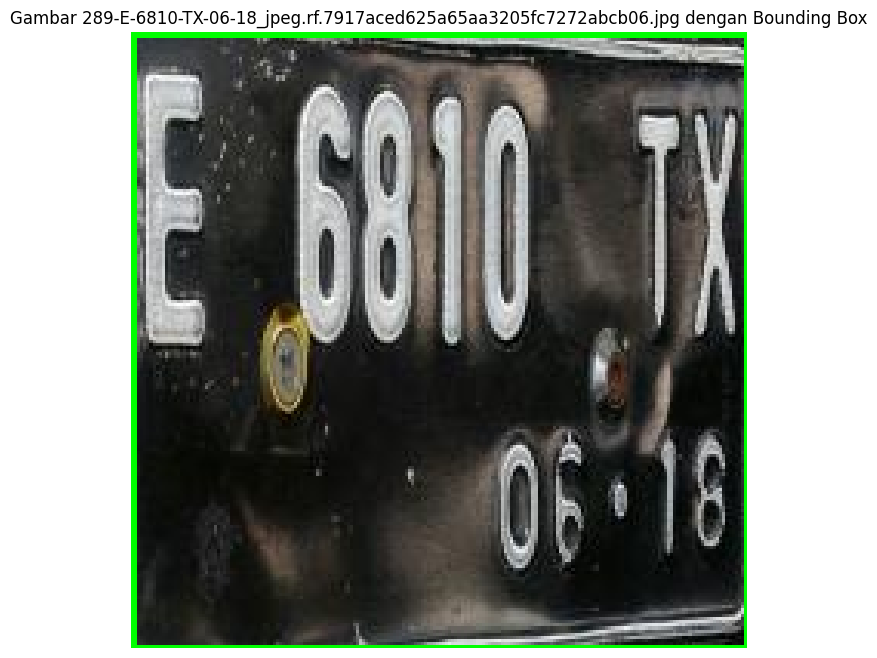

Label ditemukan untuk 222-E-4578-TL-15-22_jpeg.rf.40eceef46d230168f7455ec5f6071ed1.jpg


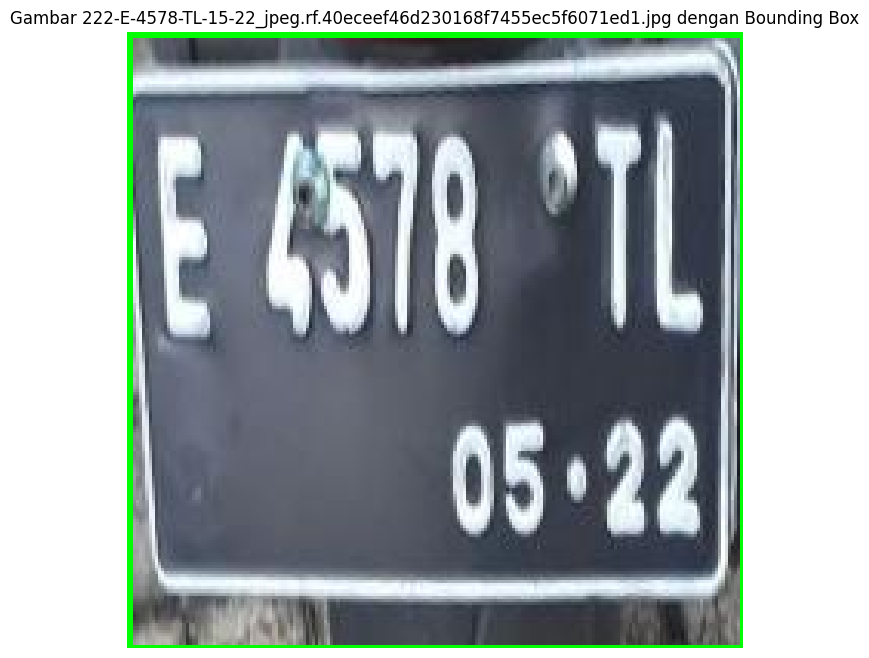

Label ditemukan untuk 307-E-4238-QC-11-18_jpeg.rf.f85538ae6af02ac5fd3a16f1b583cde0.jpg


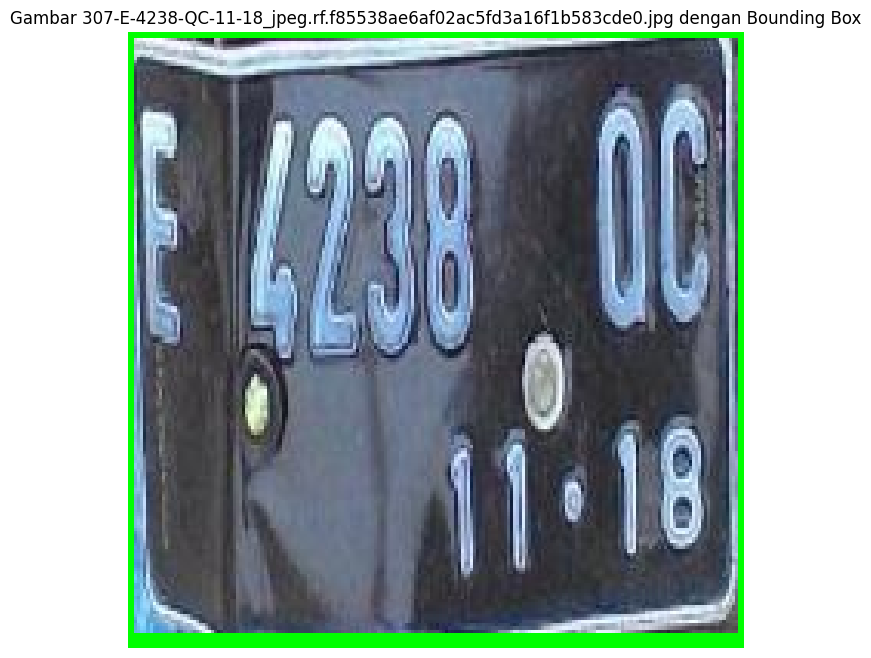

Label ditemukan untuk 303-E-6888-SC-11-21_jpg.rf.753e0288abb5610e39762e2c15d03c58.jpg


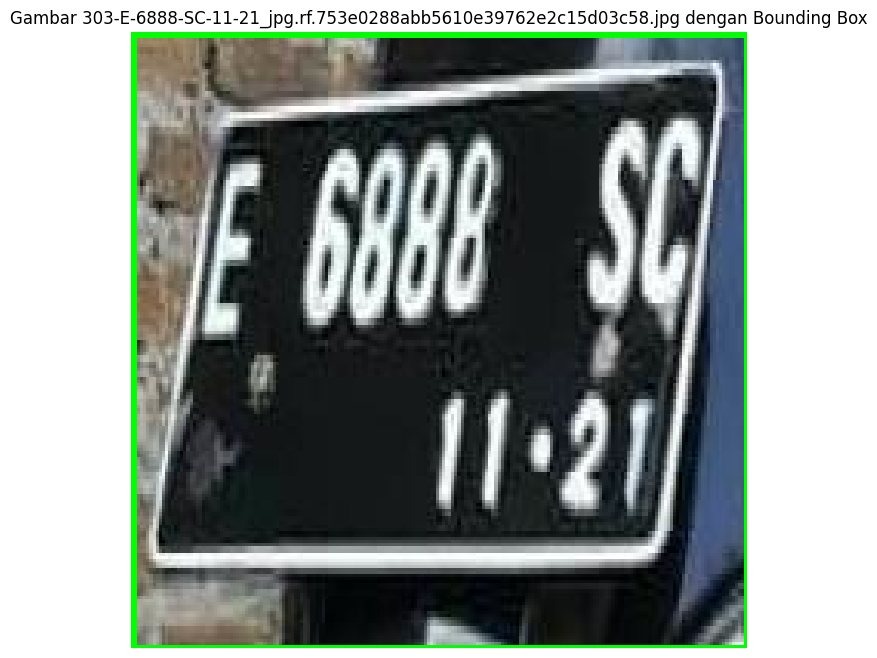

Label ditemukan untuk IMG-20180108-WA0086_jpg.rf.23ff3fcb0821506c68fed3c892c28767.jpg


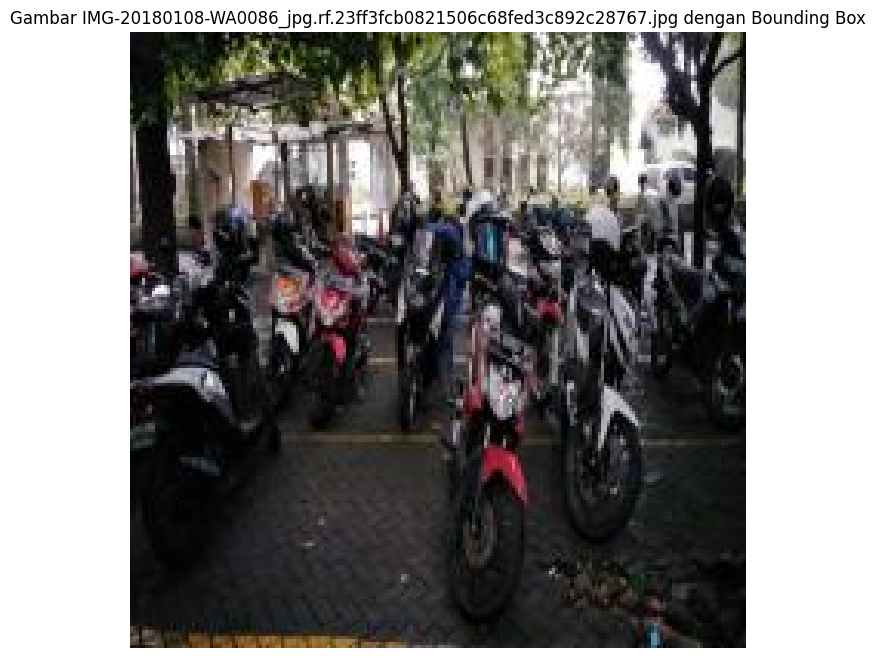

Label ditemukan untuk 20171211_110711_jpg.rf.b312a3df69c91c86a15aced9999fca2d.jpg


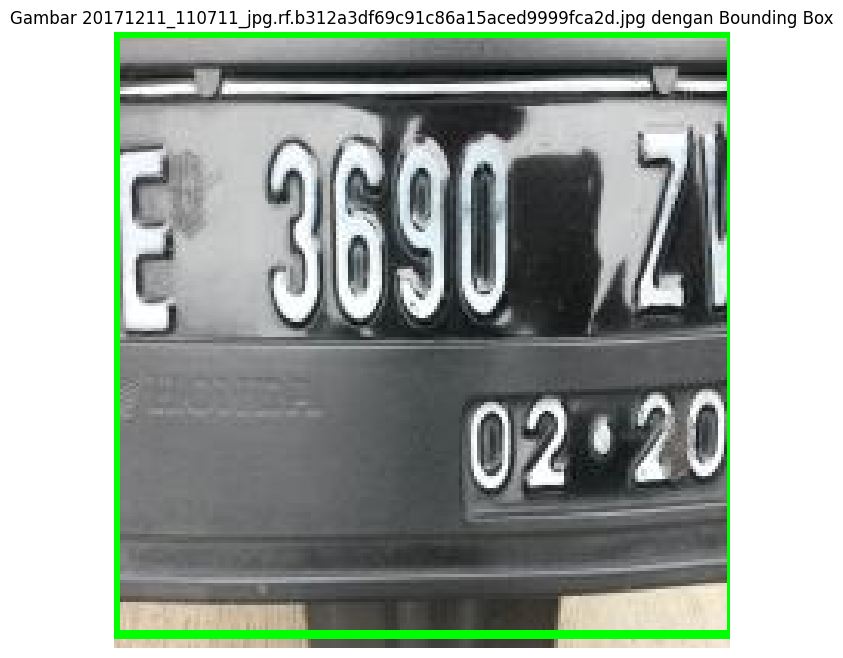

Label ditemukan untuk IMG-20180108-WA0108_jpg.rf.a8d4016db427d66e5d701daaed22eedc.jpg


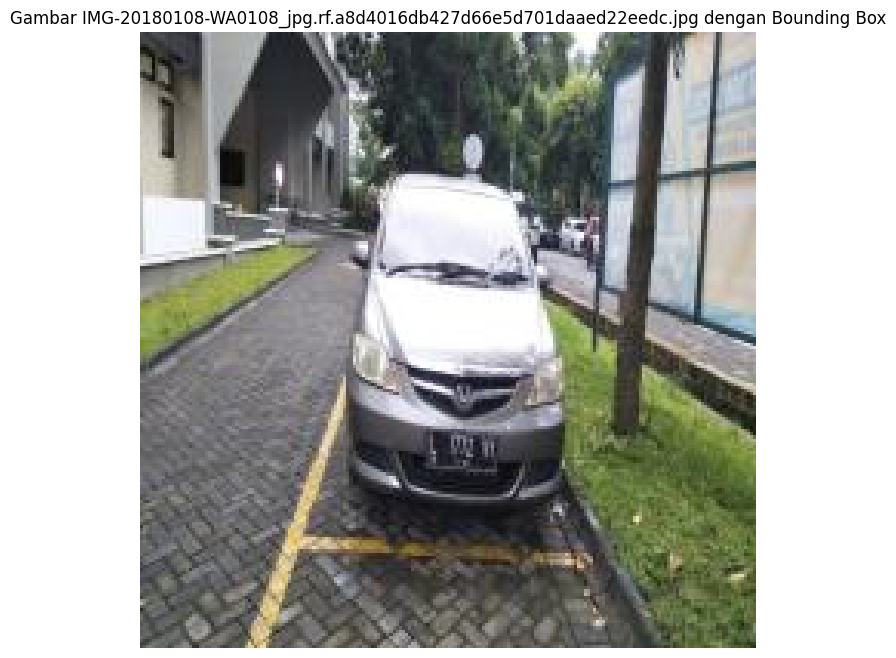

Label ditemukan untuk IMG_20230519_082646_jpg.rf.561d68cfd24713dff105e8122b18c290.jpg


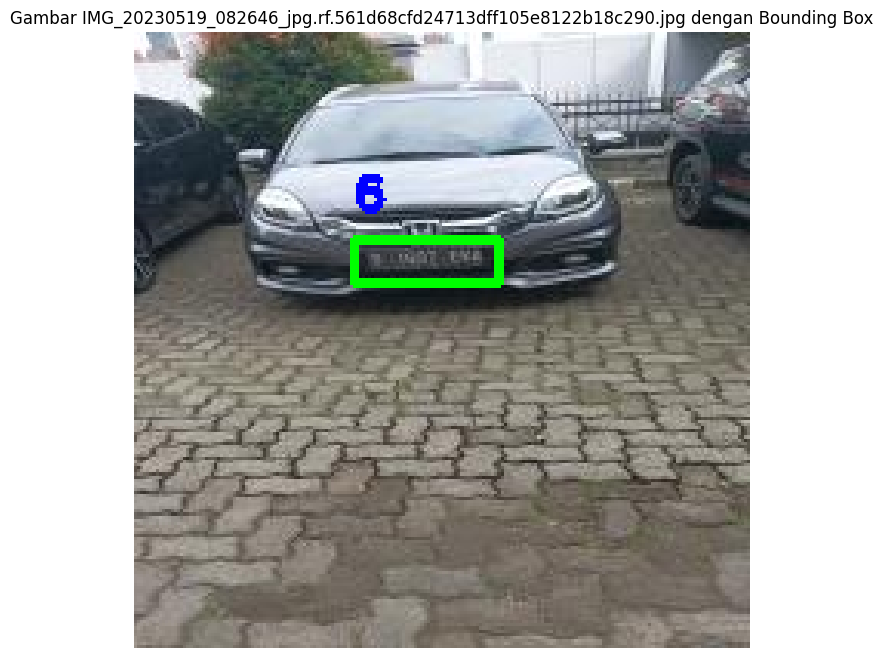

Label ditemukan untuk 161-E-3332-ST-02-19_jpeg.rf.e4c1904bcb027aa8486f446e7bbfc0e0.jpg


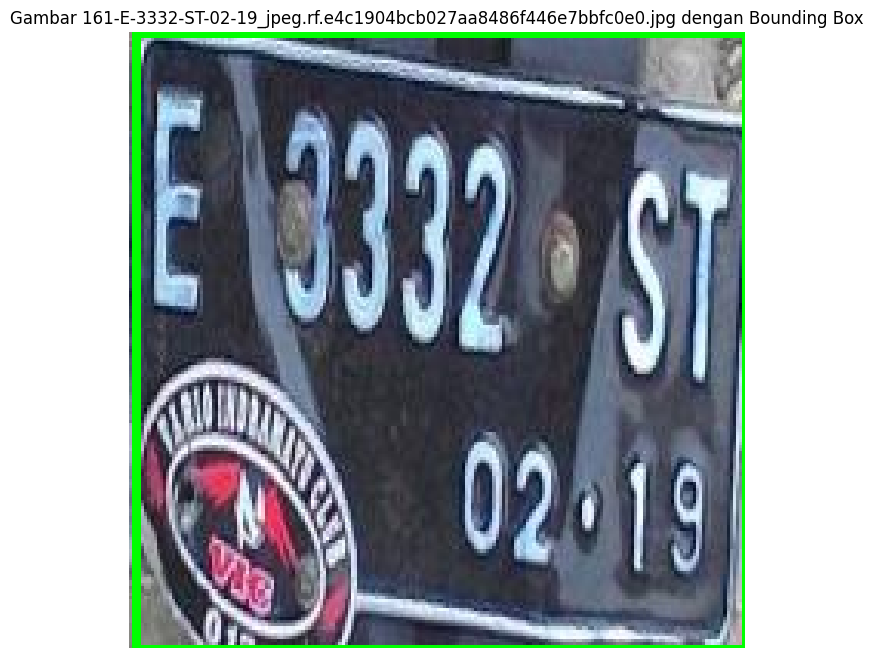

Label ditemukan untuk 333-E-2247-RY-05-18_jpeg.rf.39ed3fa61e3ad0189d0b2a8e59df2ea1.jpg


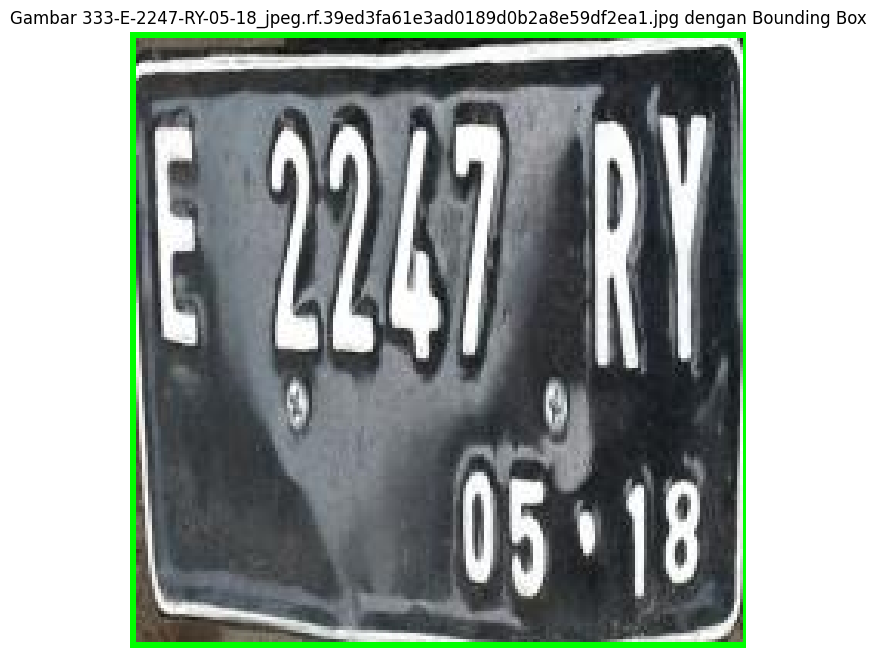

Label ditemukan untuk 37-E-4127-QI-05-19_jpg.rf.09db619d4bf2ff0b9fd9511dde2c0ea9.jpg


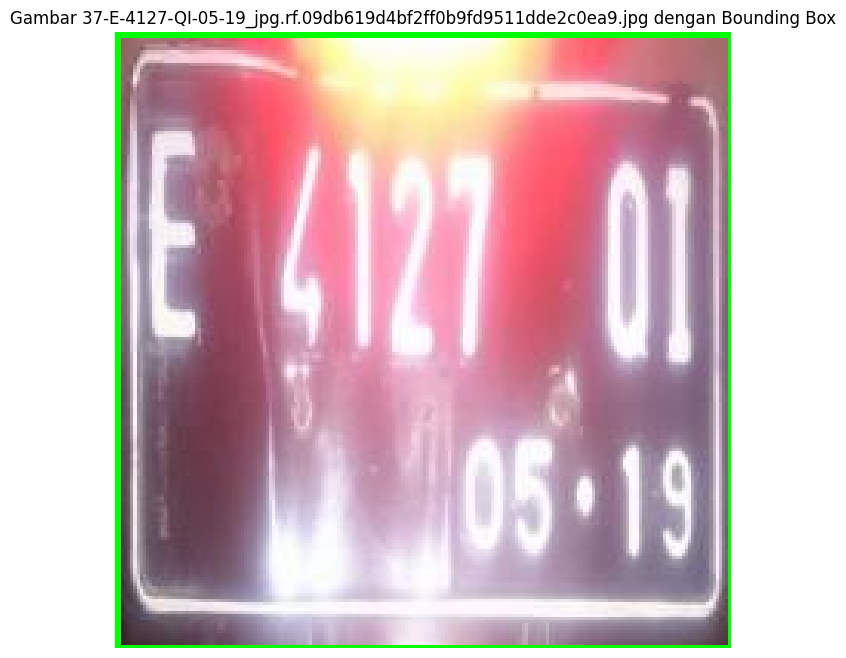

Label ditemukan untuk 266-E-4299-SZ-09-21_jpeg.rf.d6e58d493418098e1f16c45d5b955e29.jpg


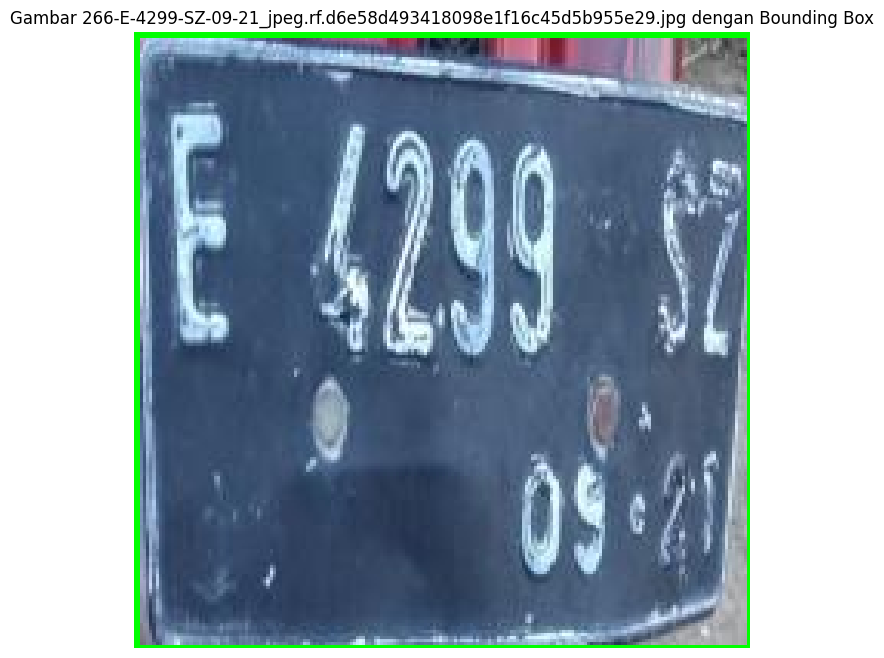

Label ditemukan untuk IMG_20230519_082610_jpg.rf.d47622990e8985e14dd119e327c0ab84.jpg


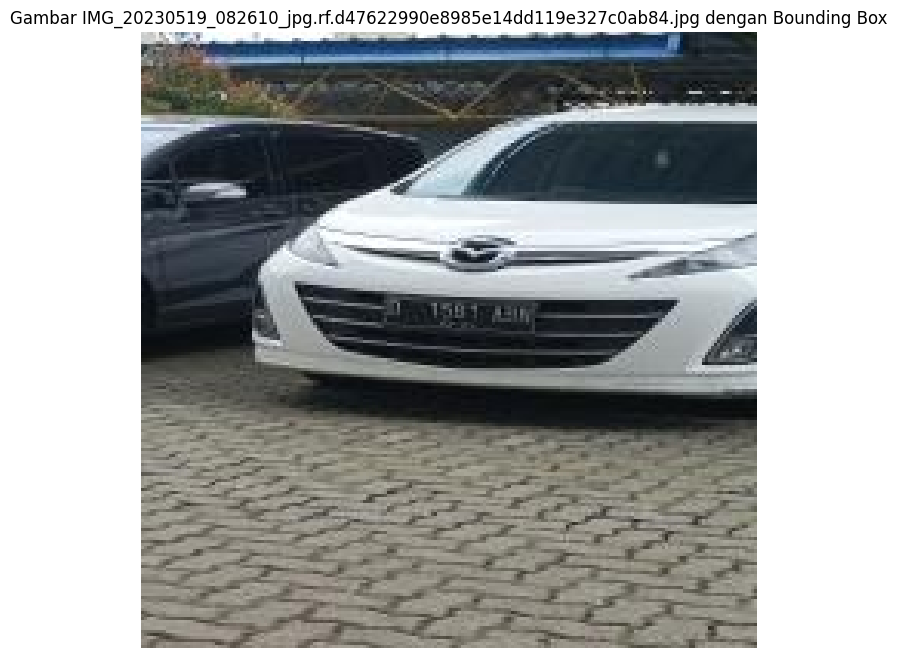

Label ditemukan untuk 105-E-6430-QO-12-19_jpeg.rf.0ccd3666ac0a6e125a53209fd7d276c5.jpg


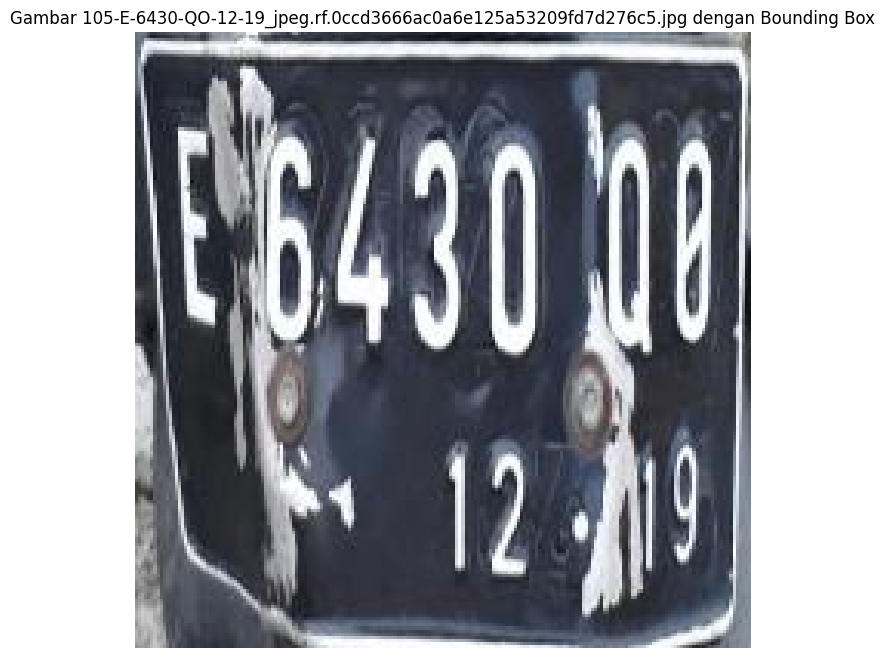

Label ditemukan untuk 160-E-2707-SP-11-21_jpeg.rf.f84cab72ce28cdf8441ac1dd7cf938d4.jpg


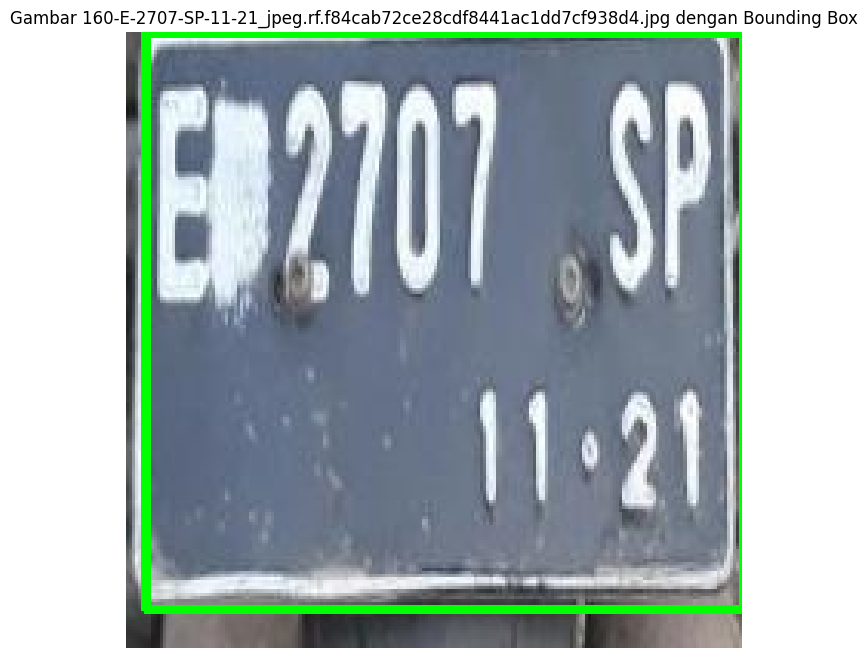

Label ditemukan untuk IMG_20230519_082712_jpg.rf.9e0cf8fc8c47bd7c3ab3fe0d19c93664.jpg


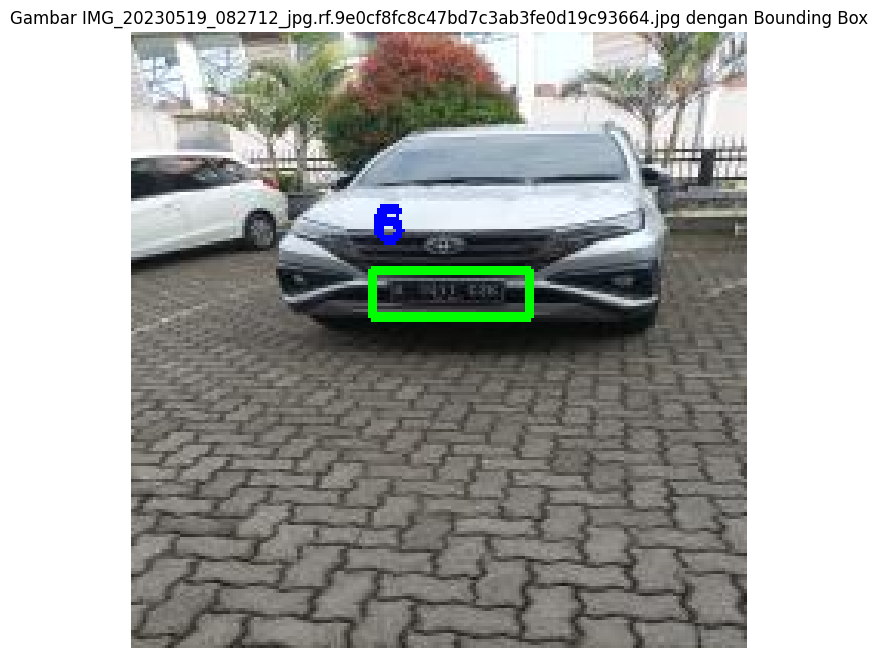

Label ditemukan untuk 251-E-3008-SM-05-20_jpeg.rf.2bd8cdf6557239640d105d734fdb5ddd.jpg


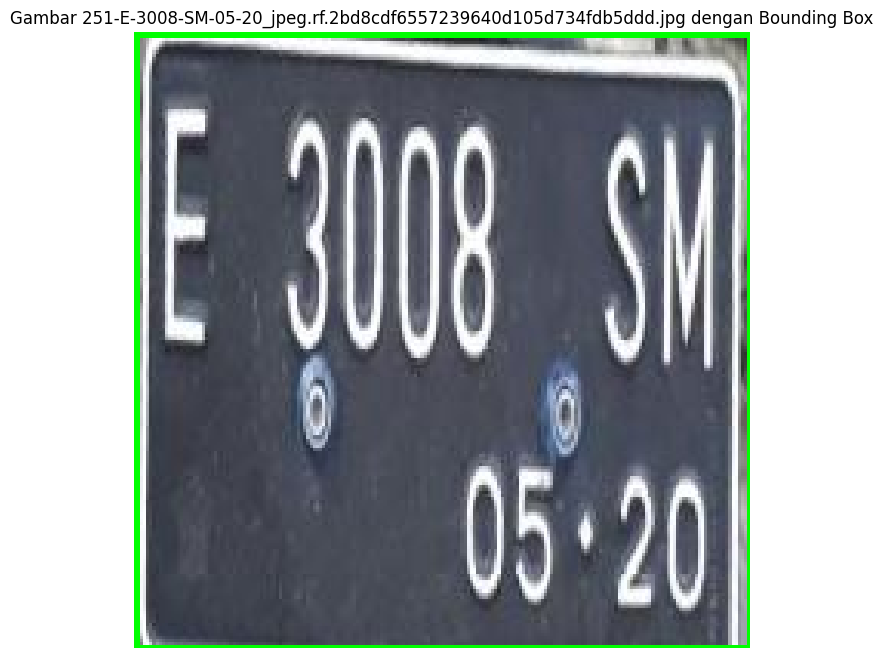

Label ditemukan untuk IMG_20230519_082856_jpg.rf.85c5d7f90c88db08b13e0b8de6e5d34e.jpg


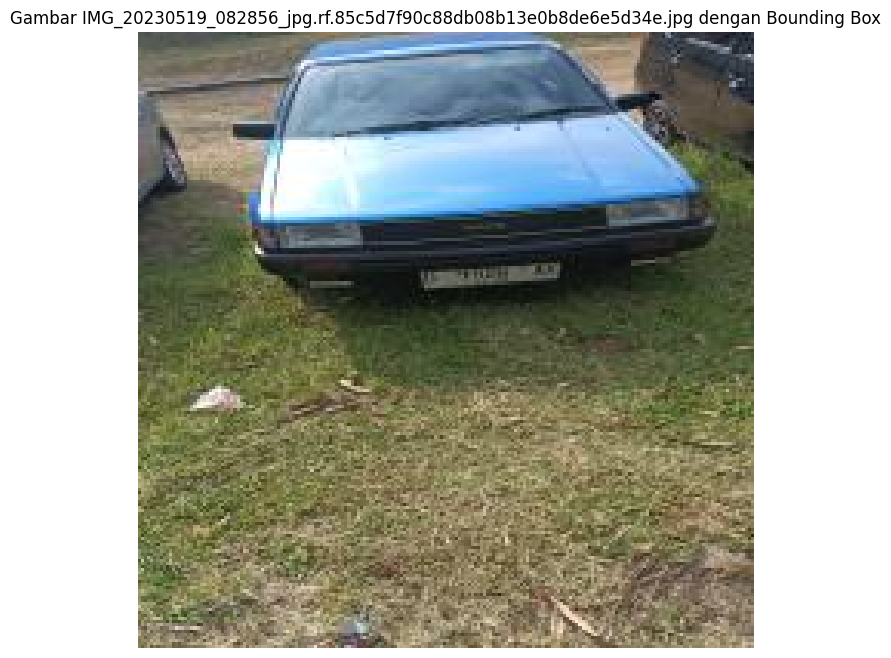

Label ditemukan untuk 176-E-4386-IY-09-18_jpeg.rf.57ee1f7513a8a6de84ba28180eb44b3b.jpg


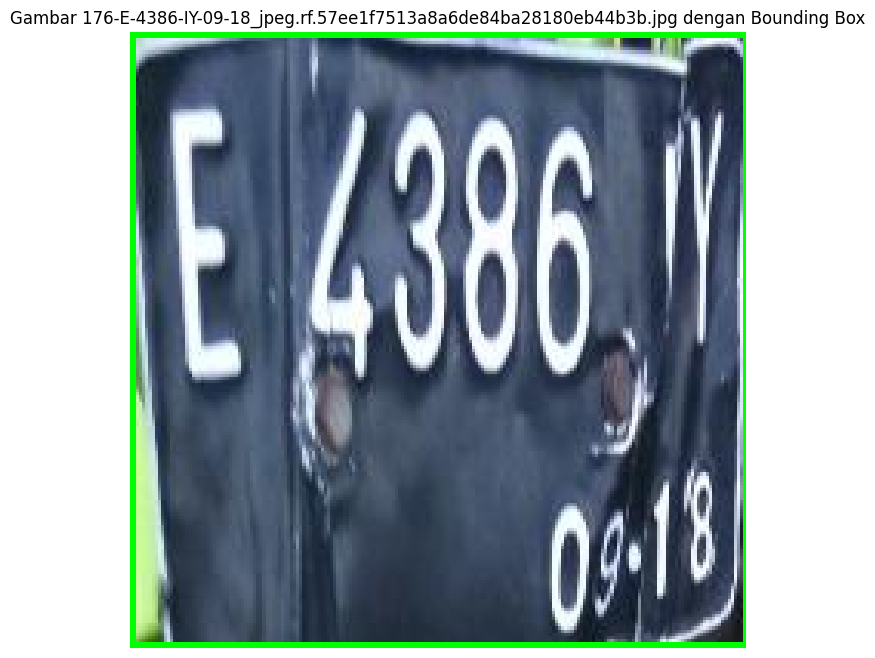

Label ditemukan untuk 134-E-2194-Q-07-18_jpeg.rf.8dc02cfda8ecc991c87fb14f142566ca.jpg


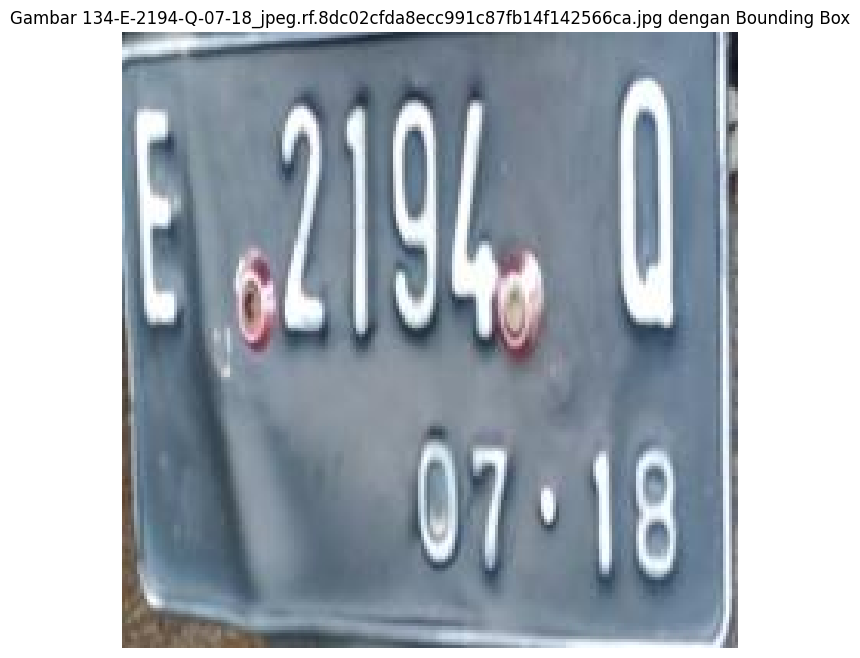

Label ditemukan untuk 93-E-5277-PW-09-18_jpg.rf.8628cf9ce6026a4bc21057ed79623552.jpg


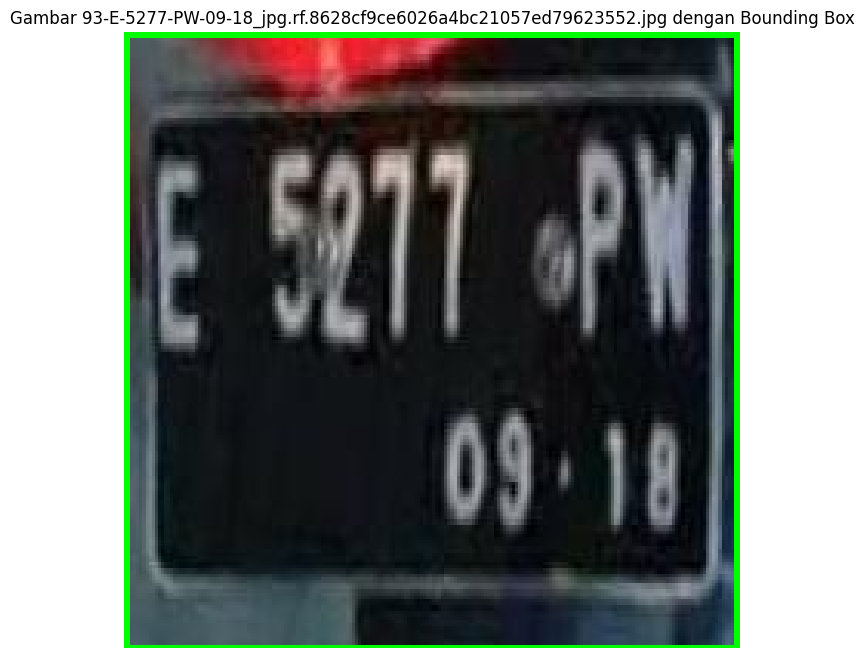

Label ditemukan untuk license-4-_jpg.rf.2ec1b8c6442822068aa7788084a32f5f.jpg


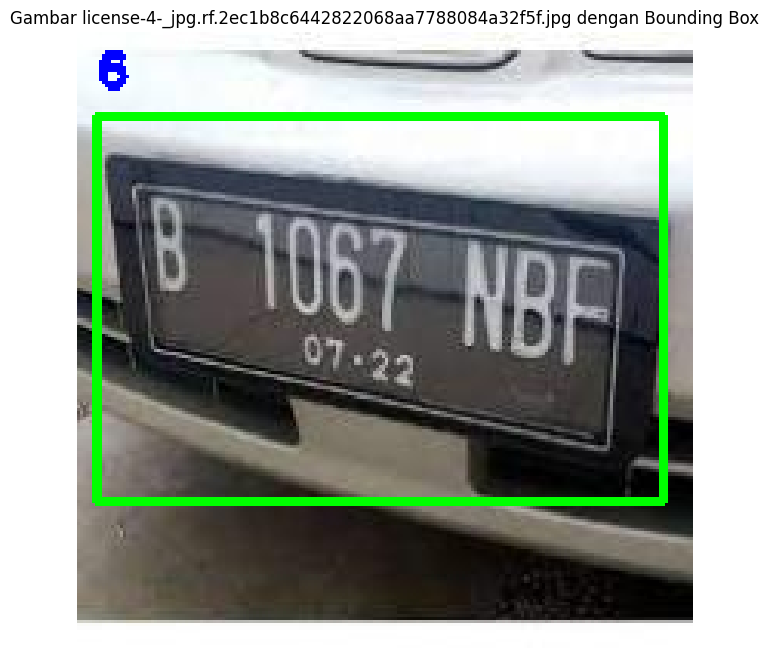

Label ditemukan untuk 20171211_110659_jpg.rf.759d2387c113325578cbee198750c21d.jpg


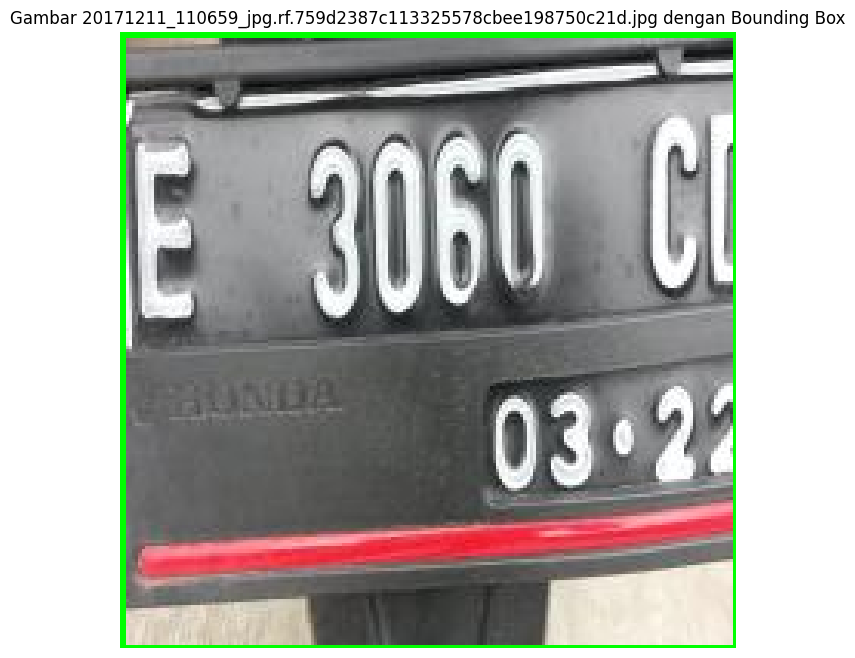

Label ditemukan untuk 310-E-6193-QF-02-10_jpeg.rf.d5fd342b121223f432ce8f74acad38a1.jpg


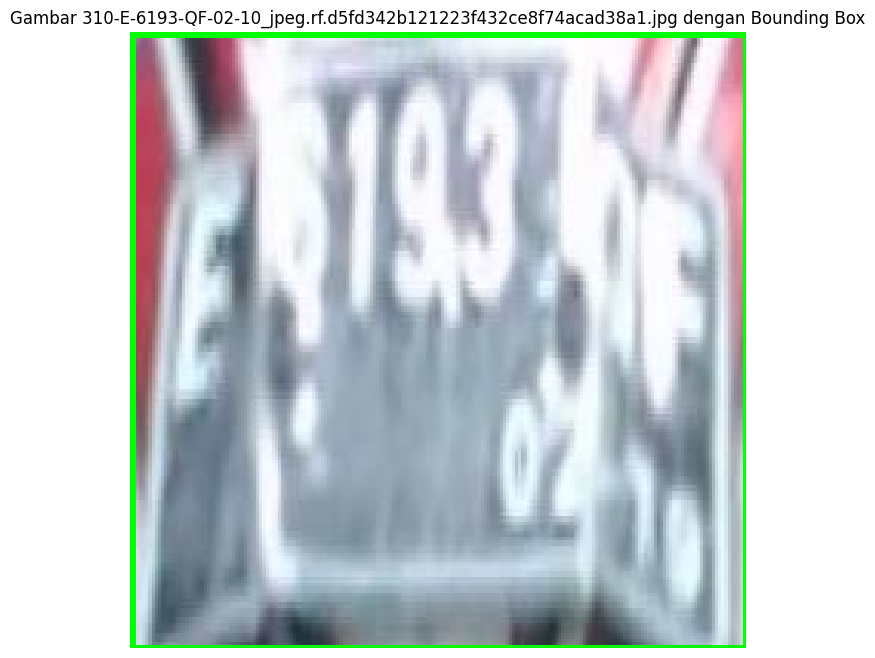

Label ditemukan untuk 20171211_154917_jpg.rf.5f07176fc5d3c0996bafc50db320721e.jpg


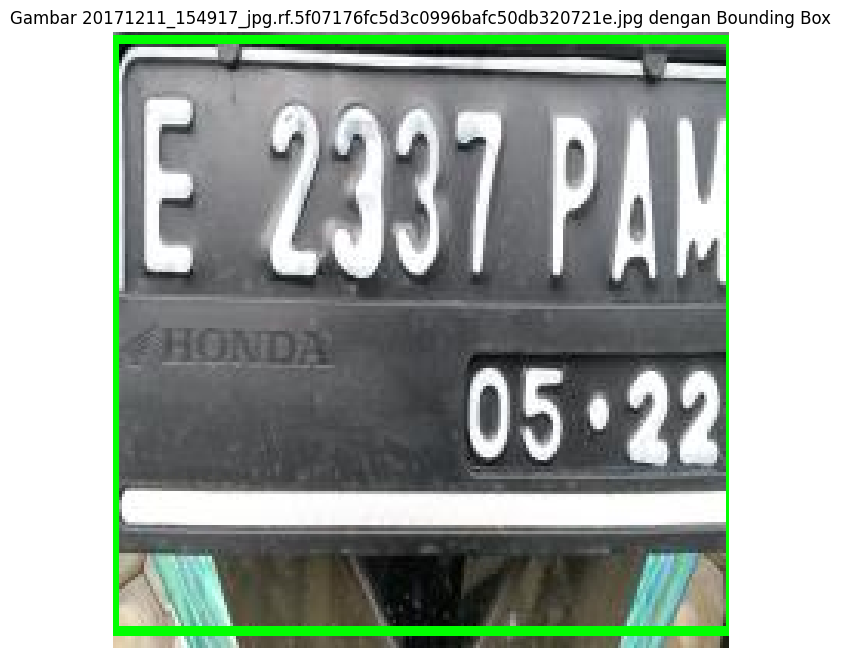

Label ditemukan untuk 224-E-5085-SD-03-19_jpg.rf.6a2efa74444ada73fc85927b6636c379.jpg


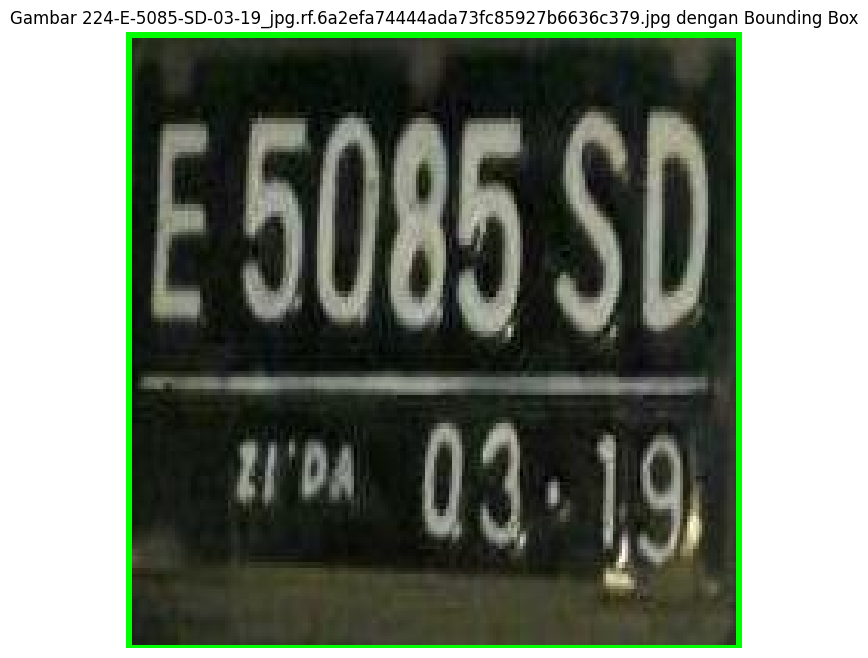

Label ditemukan untuk 70-E-4310-OR-03-20_jpeg.rf.27cc446849fbc2fa2bef586bfe7157c2.jpg


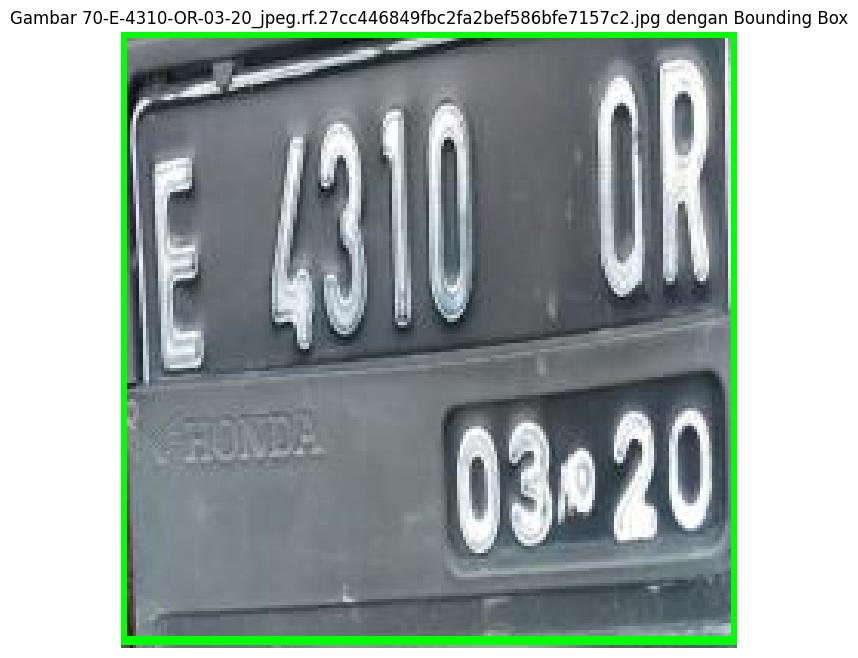

Label ditemukan untuk 20171212_100559_jpg.rf.2cd736a831e033e18766d30cff00a1a5.jpg


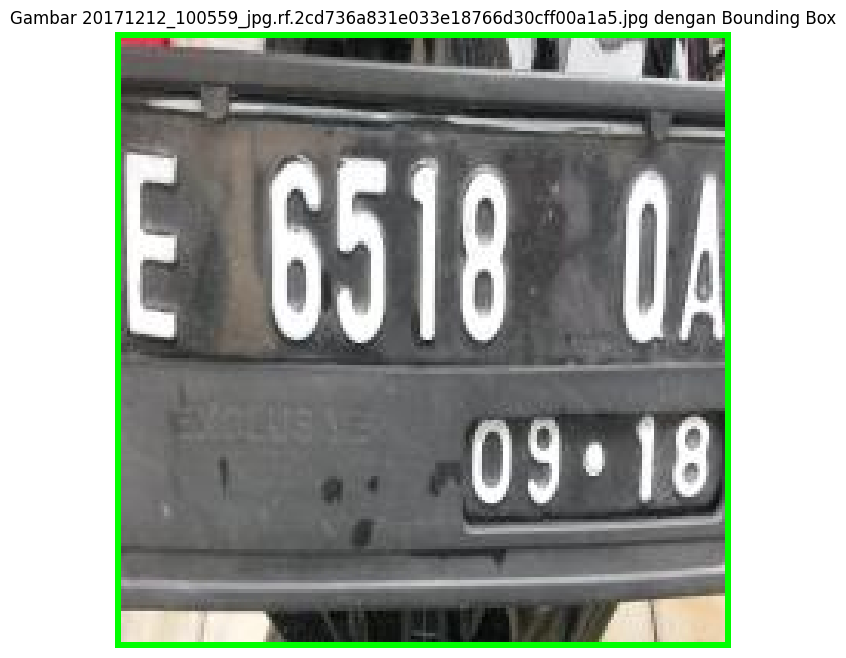

Label ditemukan untuk 268-E-6752-SN-04-18_jpeg.rf.b85fcd69796e2a0ab68142e4d81c50d2.jpg


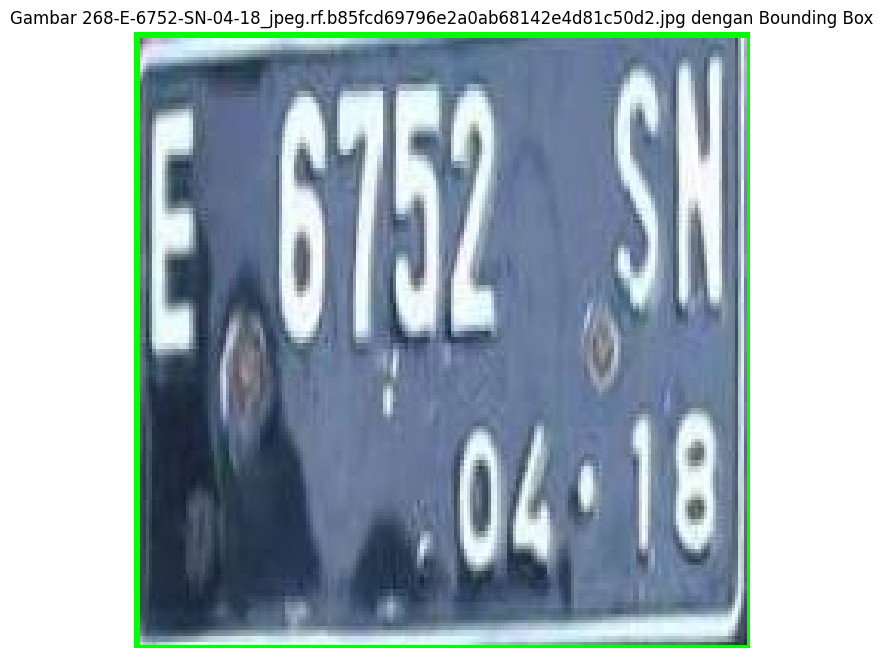

Label ditemukan untuk 257-E-4553-QT-06-20_jpg.rf.5fdf50edd79ba9b751110fe7a77ef2d3.jpg


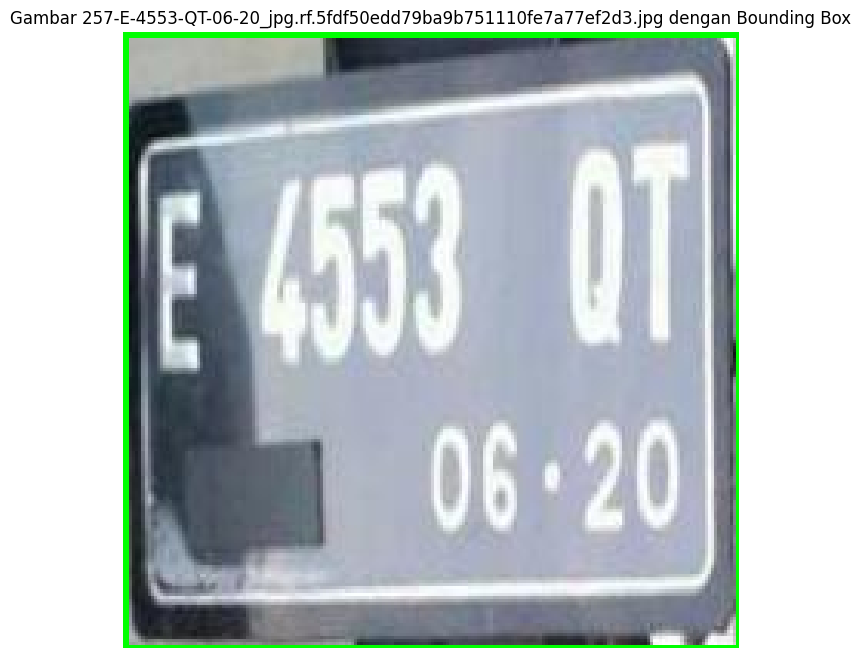

Label ditemukan untuk 309-E-6140-OX-11-20_jpg.rf.a94cd57e66bab129222bd36e880a3270.jpg


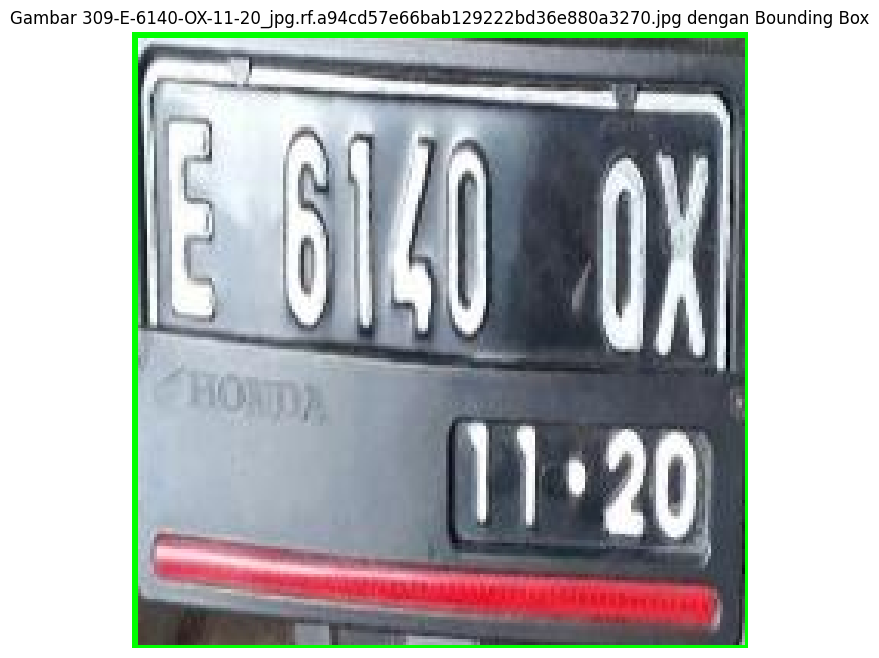

Label ditemukan untuk license-30-_jpg.rf.40a716d92db2b7058074d1005ba55c73.jpg


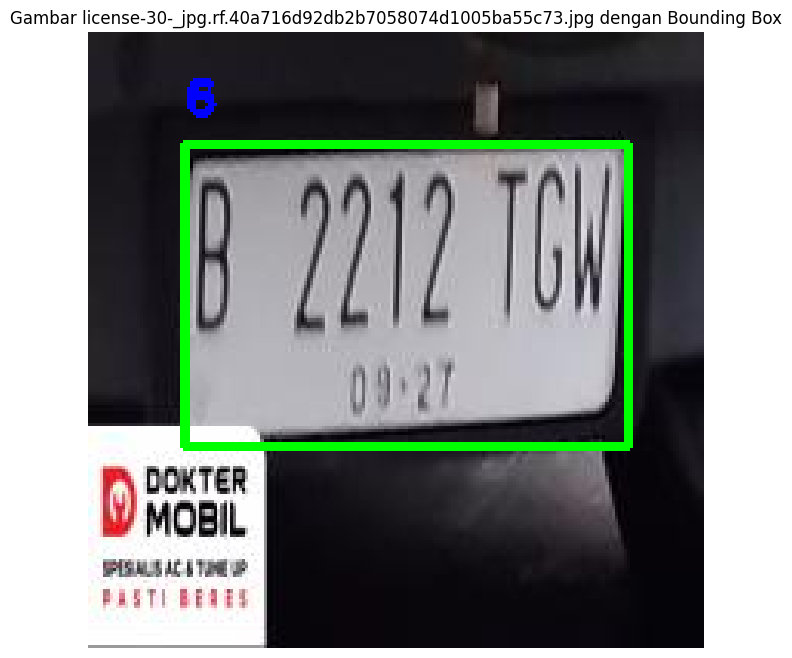

Label ditemukan untuk 20171212_100708_jpg.rf.312cc48a9604045ec67809881556d09f.jpg


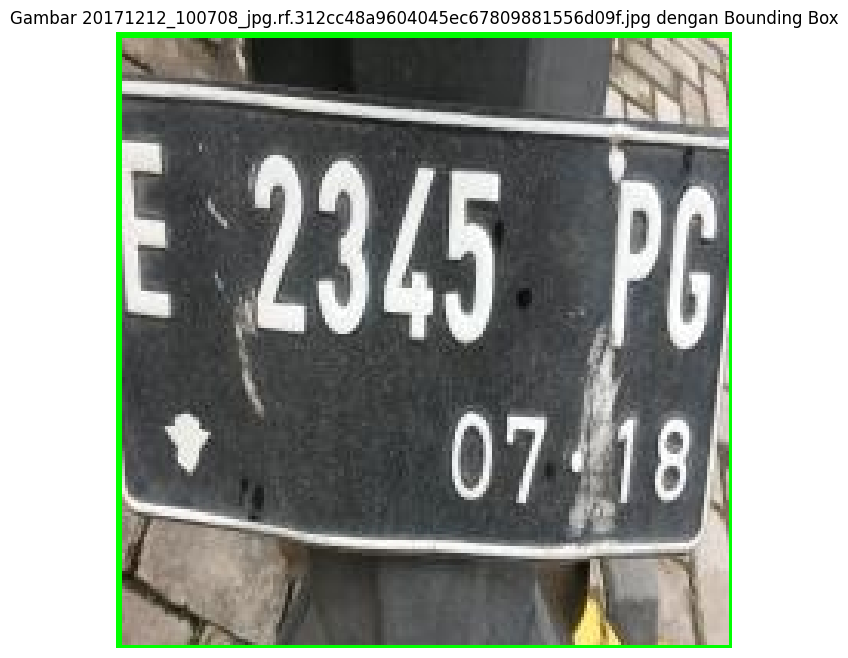

Label ditemukan untuk 63-E-2536-SA-09-18_jpg.rf.cba9c41359069858795f642f0941cc42.jpg


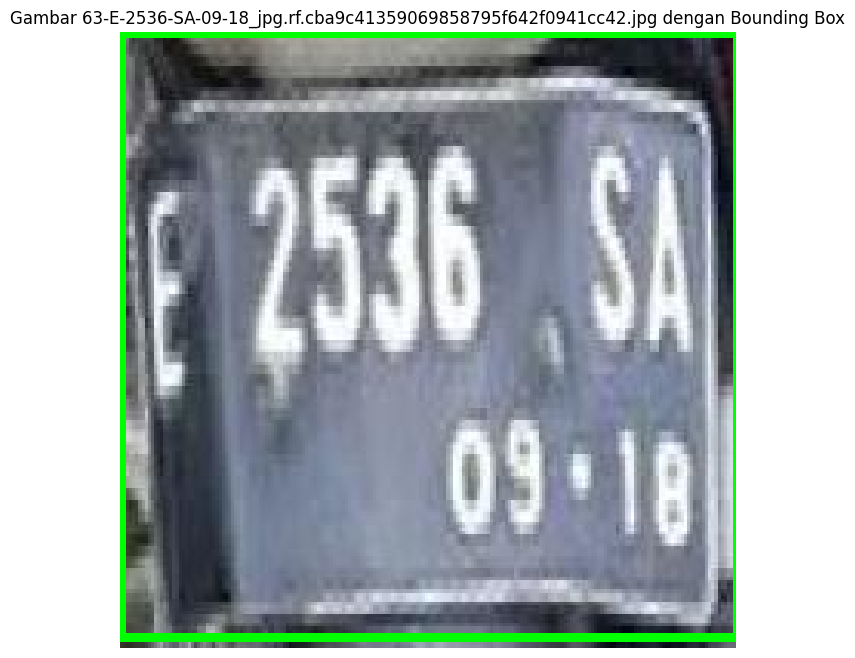

Label ditemukan untuk IMG-20180108-WA0076_jpg.rf.7cf63f4234238368fc6e4c9169bd66e2.jpg


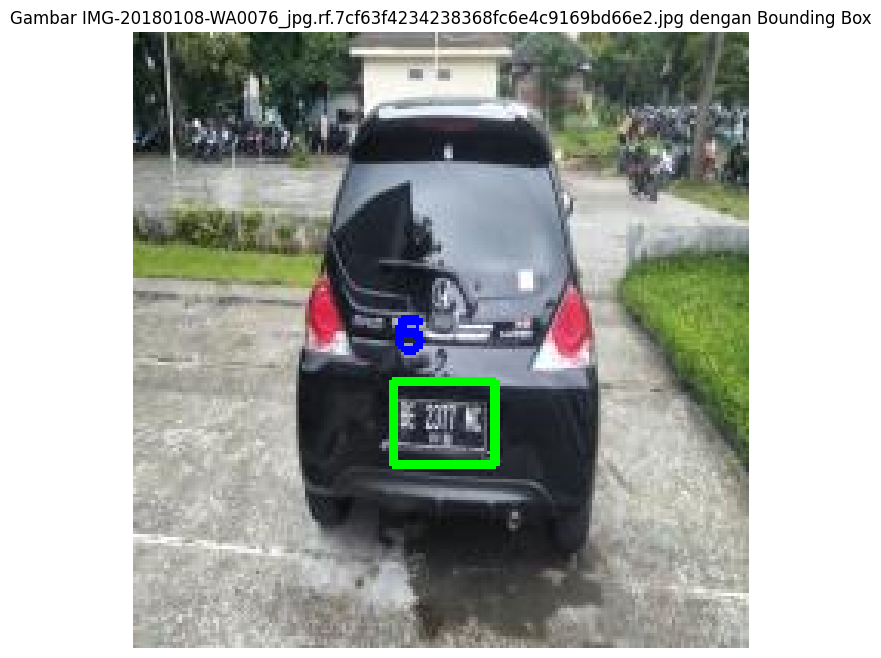

Label ditemukan untuk 76-E-5361-TI-01-18_jpg.rf.641ebf29b1b6bf1dd566ca8f84e7121c.jpg


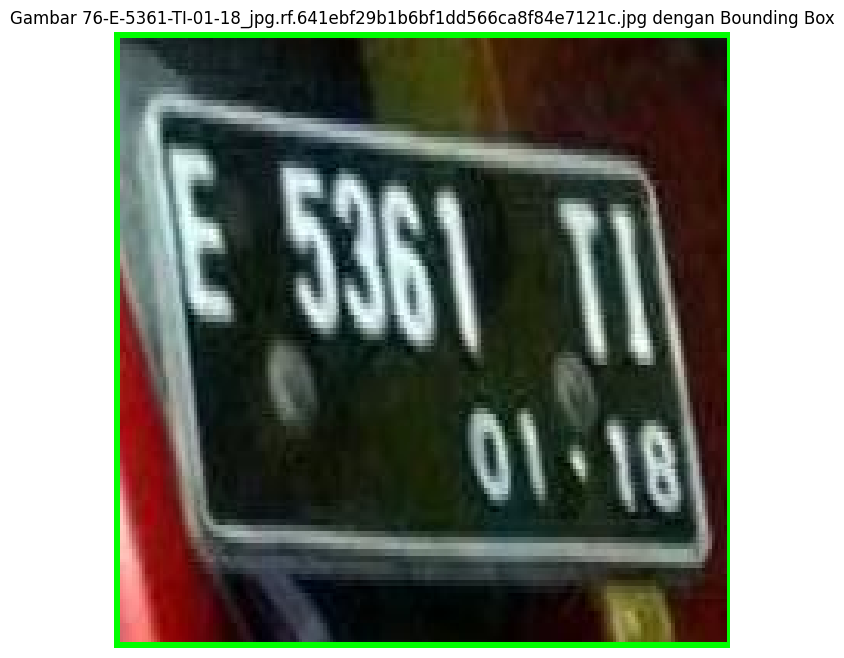

Label ditemukan untuk 22-E-5234-YF-11-20_jpeg.rf.e9a429611c03d756560c07a74efdb6b1.jpg


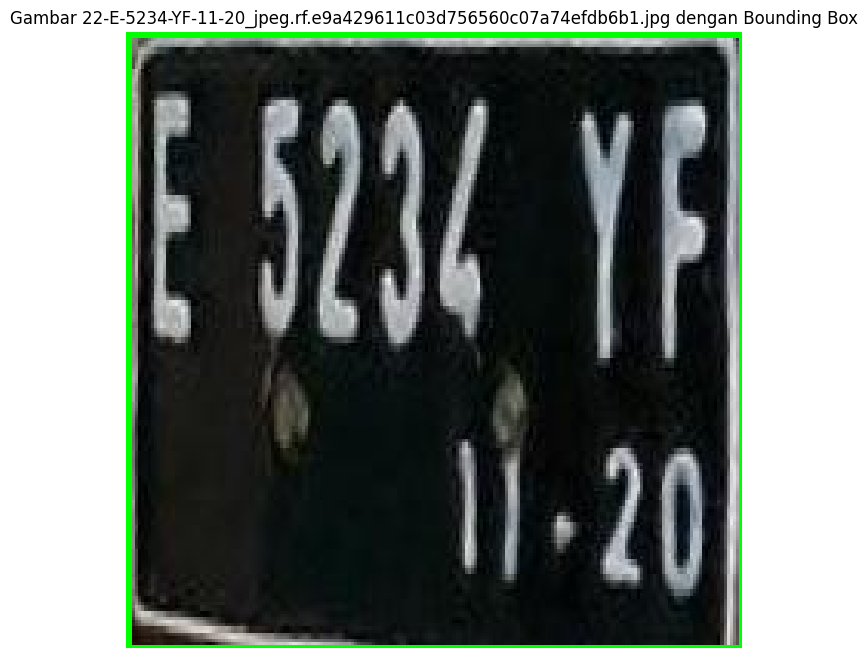

Label ditemukan untuk 79-E-4564-SZ-09-21_jpeg.rf.3f8c164a5eae2e5b822e9461eb0f773b.jpg


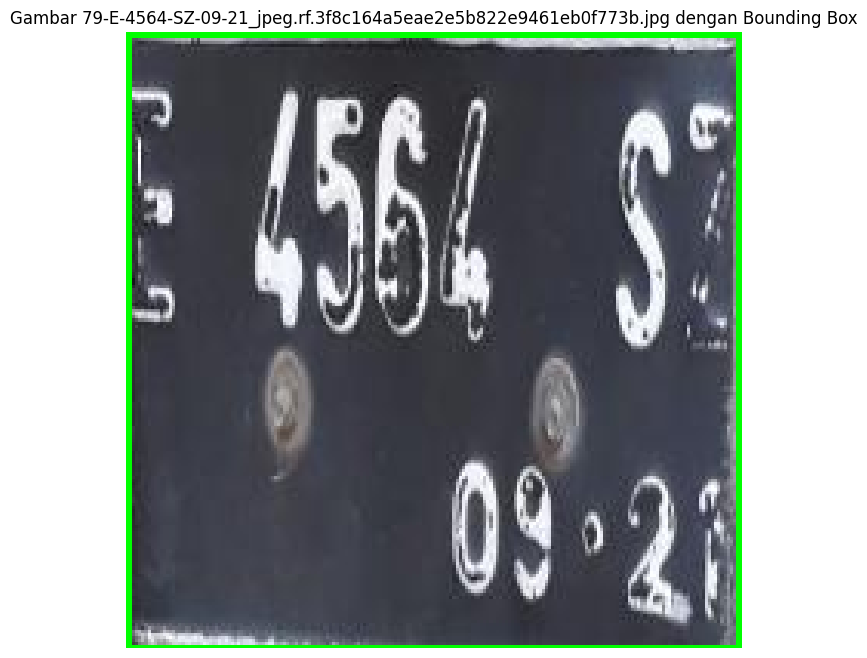

Label ditemukan untuk 40-E-2324-OM-09-19_jpg.rf.24acc3b3b50898b2e82a89df766d57ef.jpg


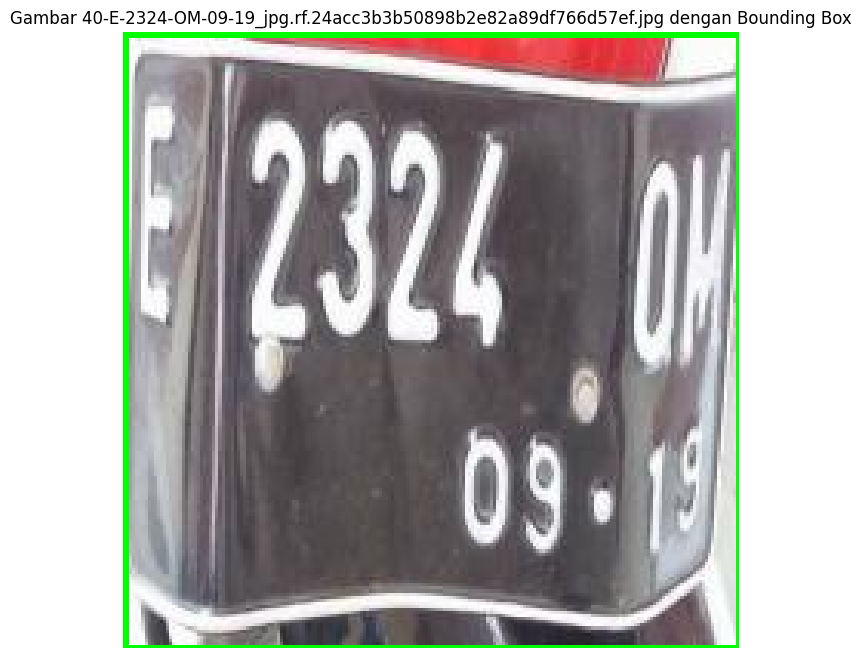

Label ditemukan untuk 20171211_132834_jpg.rf.17c75cc47337b7a1c7e79997796b4f20.jpg


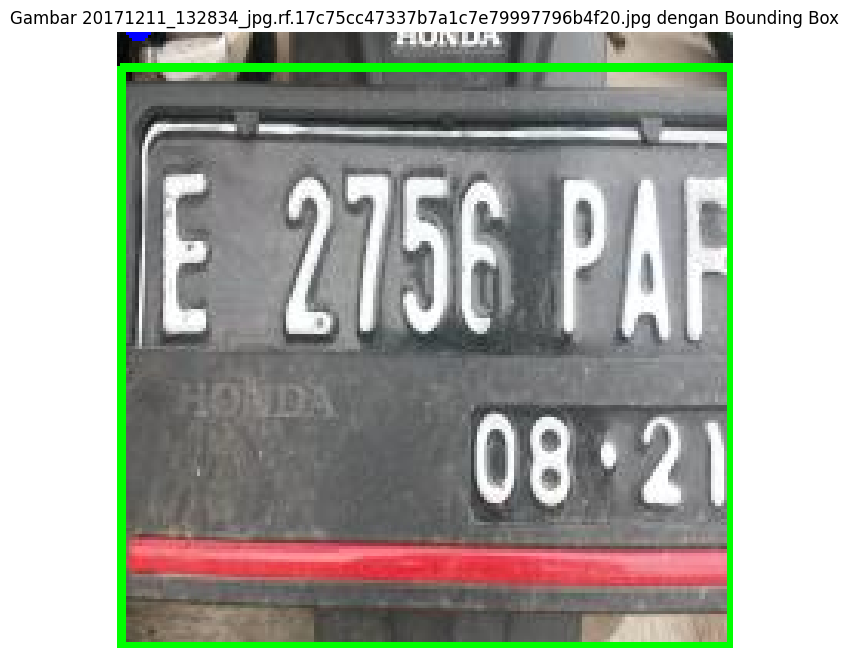

Label ditemukan untuk 244-E-6590-QW-09-20_jpeg.rf.bc37f12e894894ebdfb6c6ffeb899354.jpg


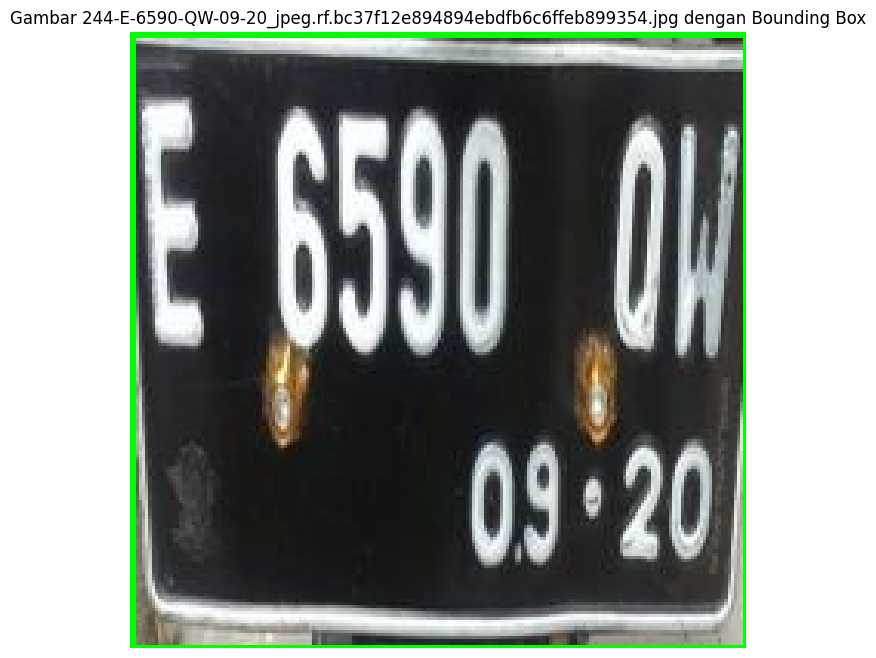

Label ditemukan untuk 213-E-4732-TX-05-18_jpeg.rf.018f66e50606f0858f30da5a7af1b628.jpg


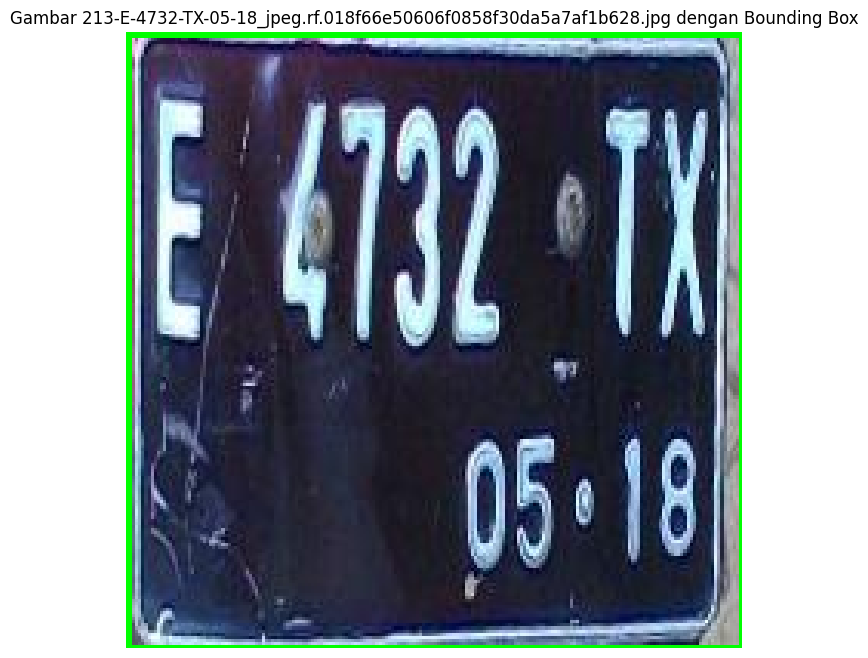

Label ditemukan untuk 281-E-5503-TI-02-20_jpeg.rf.c597e7775111be78213cfa0a87e7c7e7.jpg


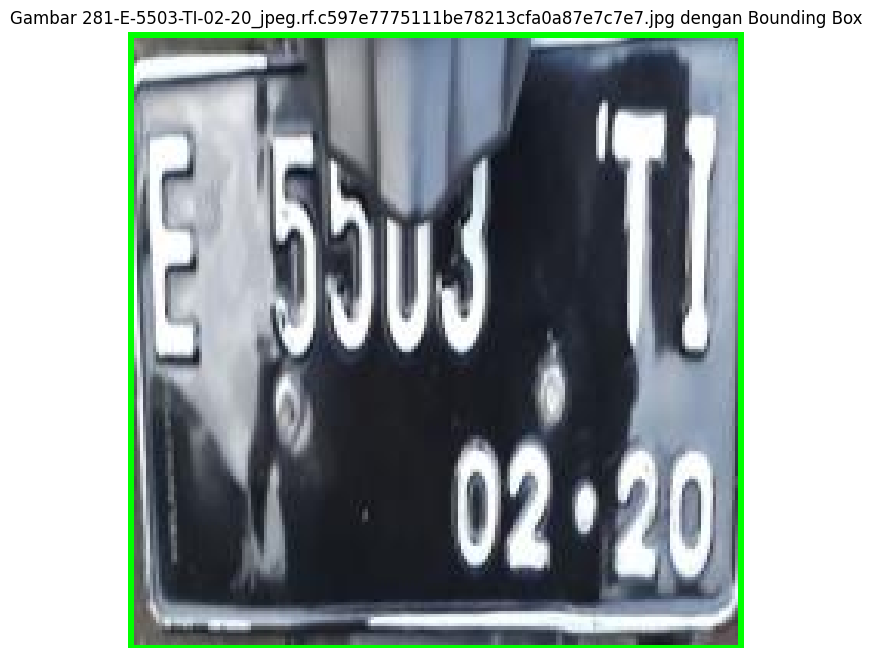

Label ditemukan untuk 225-E-3061-SQ-10-20_jpg.rf.3d5392a1098889614588ad2478a5f65f.jpg


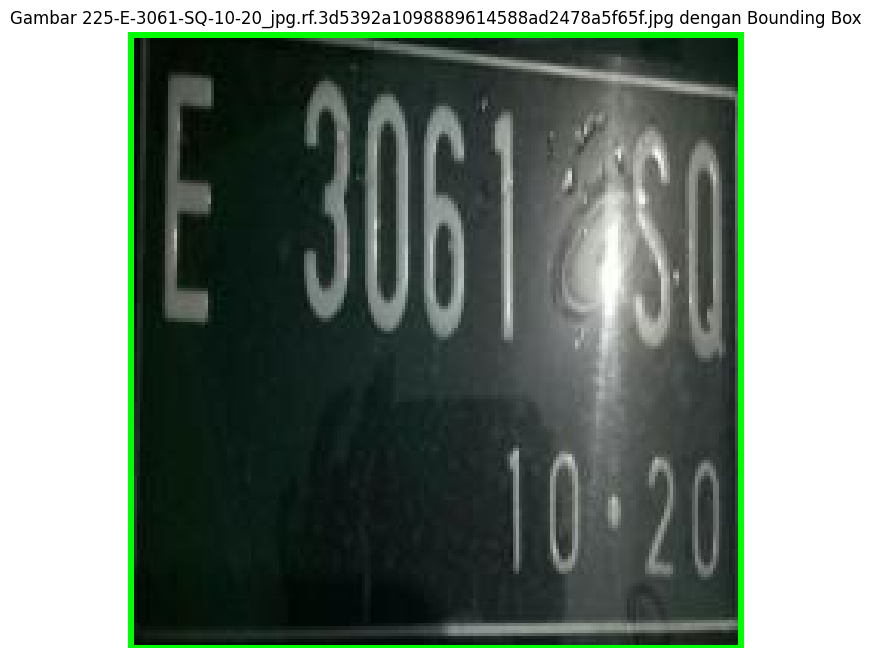

Label ditemukan untuk IMG-20180108-WA0036_jpg.rf.4312e9a384249b4d77ccb564350a8227.jpg


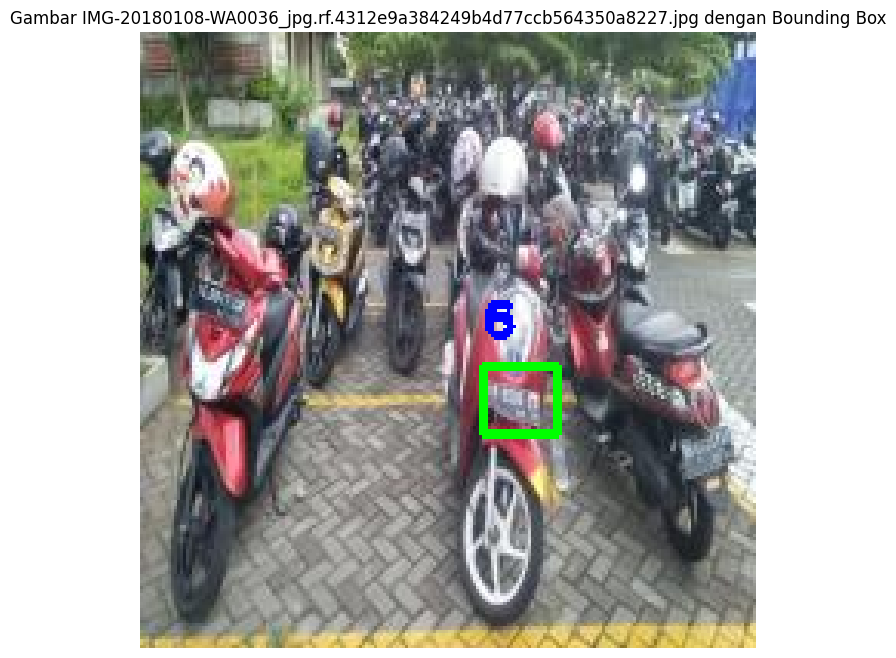

Label ditemukan untuk 273-E-6078-RM-09-22_jpeg.rf.f78e93ec6566ee7f09fe2ff21d4f0ec1.jpg


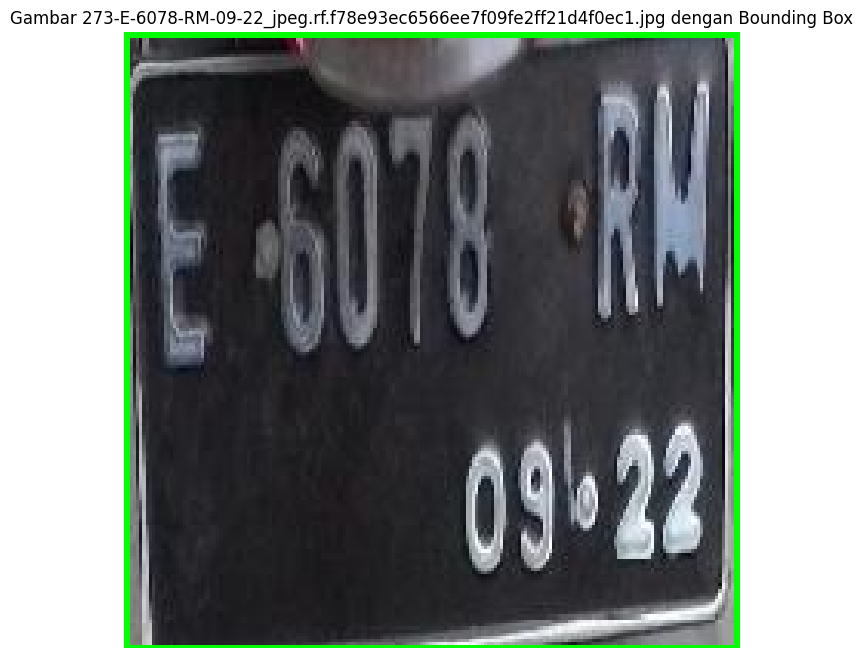

Label ditemukan untuk 347-E-6765-PAD-06-21_jpeg.rf.660d5bae8a35cda5ec4ea77fdda0872d.jpg


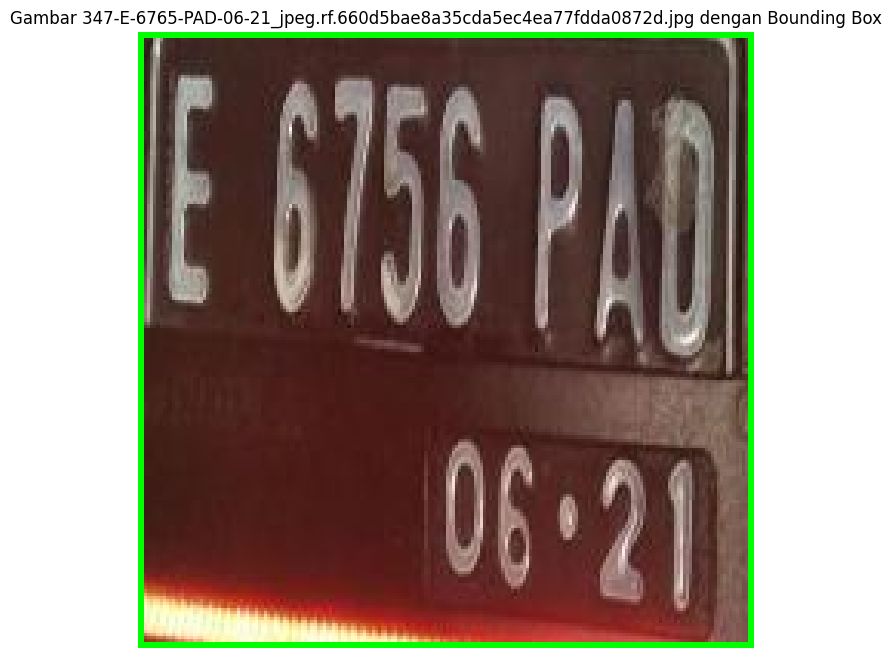

Label ditemukan untuk 272-E-1677-PE-02-21_jpeg.rf.93d16879ccdf2a06cb02c04abf903058.jpg


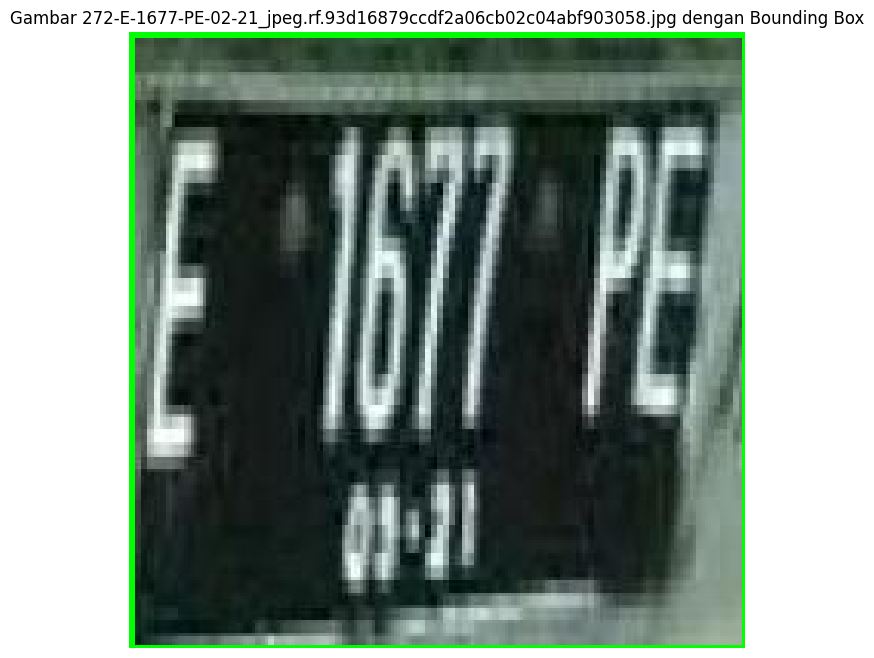

Label ditemukan untuk 227-E-2075-OD-11-18_jpg.rf.00649a0eb95c20f6244c53817beb01a8.jpg


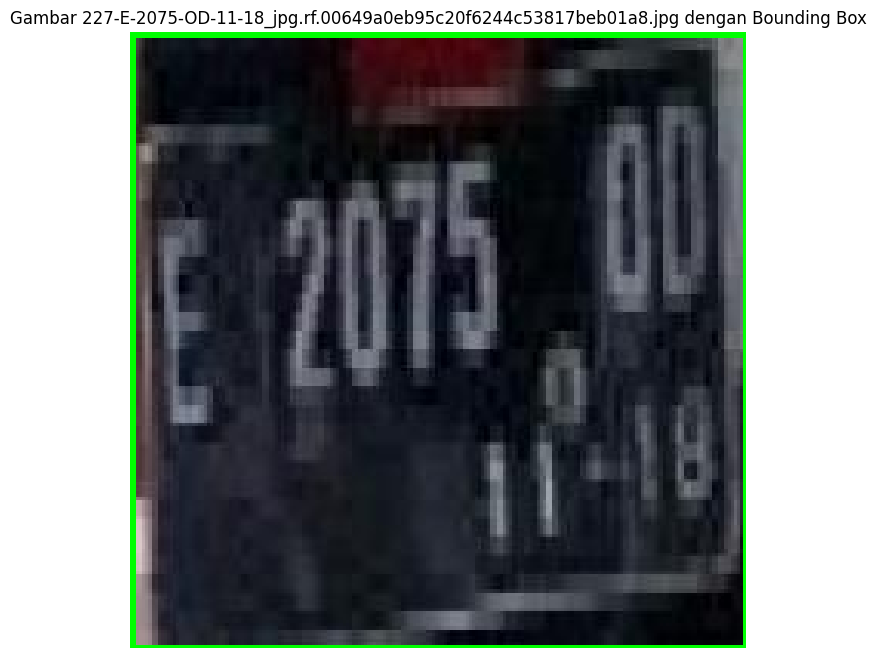

Label ditemukan untuk 229-E-4951-QE-02-19_jpg.rf.ad6b56545cda131067448e035f6103ab.jpg


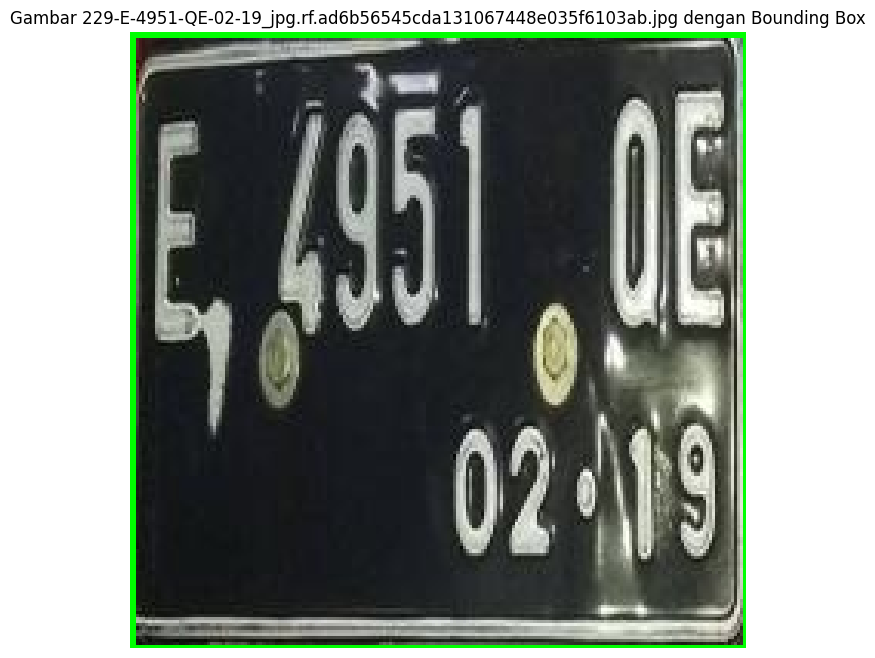

Label ditemukan untuk IMG_20230519_082742_jpg.rf.00ae5cdd16fcd6722f78a45d00de28c6.jpg


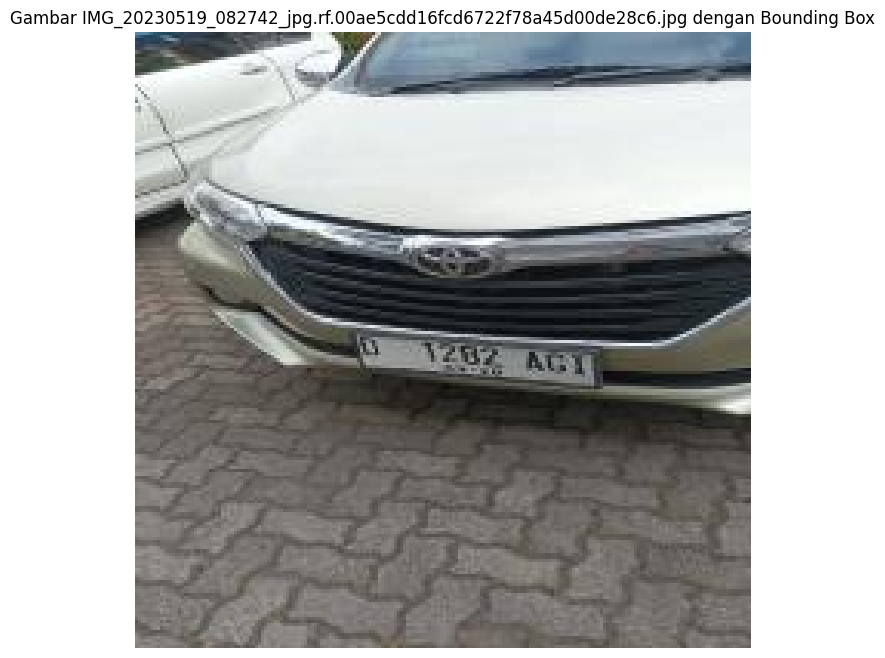

Label ditemukan untuk 322-E-8767-TG-11-22_jpg.rf.3e67f01ed25fc02137eb9a9927e98ec7.jpg


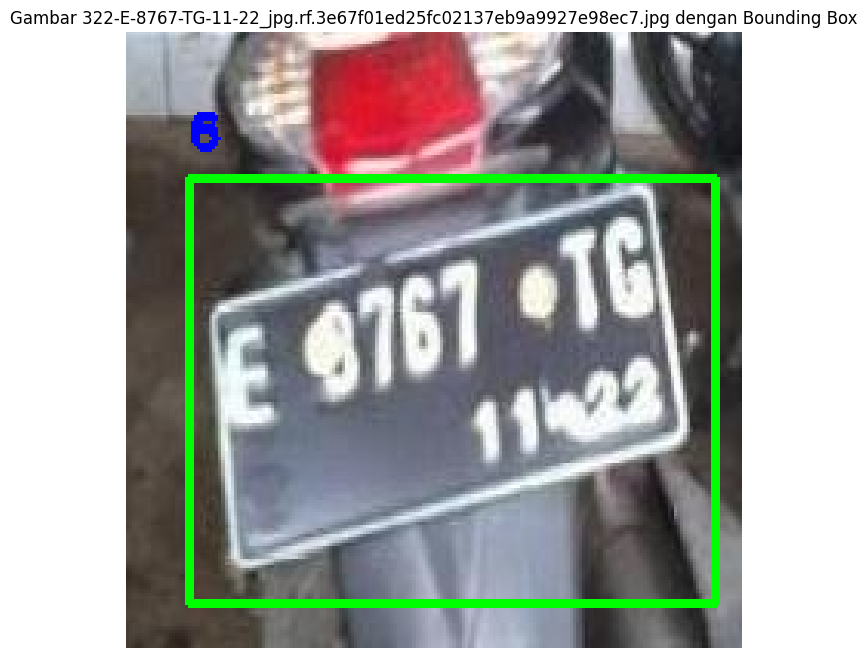

Label ditemukan untuk license-1-_jpeg.rf.19557f0313851e2de5364794a4b39a1d.jpg


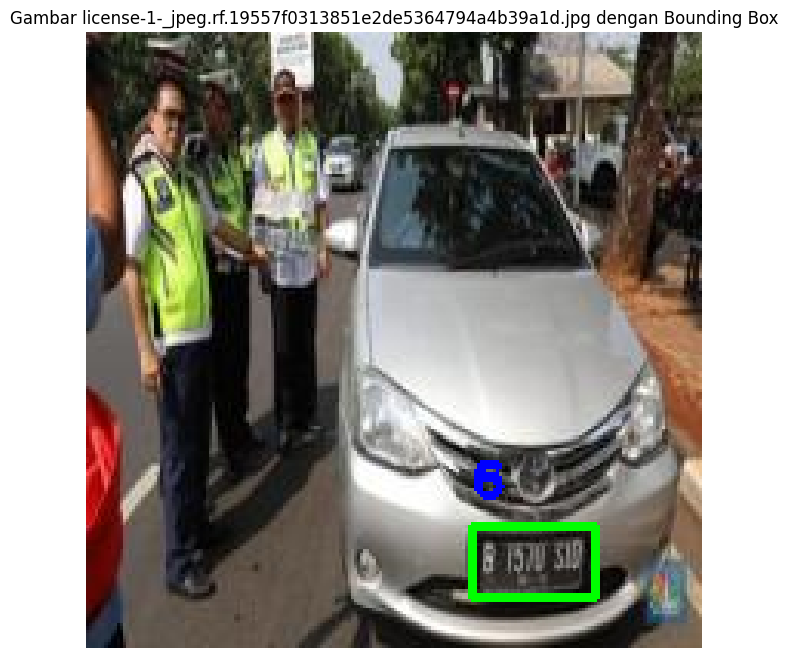

Label ditemukan untuk IMG-20180108-WA0032_jpg.rf.49f0df5c15cd95c661547c09ad660e25.jpg


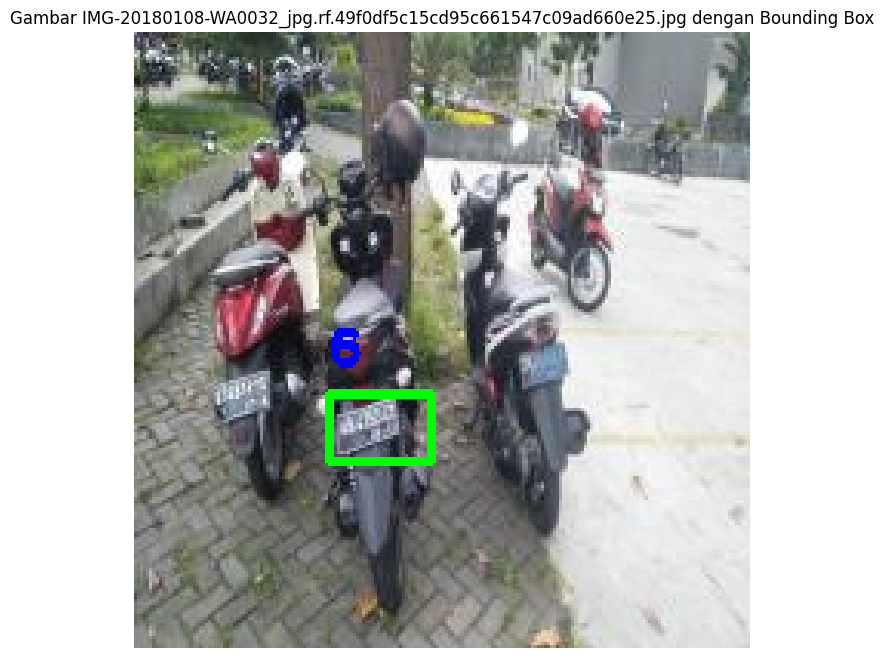

Label ditemukan untuk 138-E-4746-PAI-12-21_jpg.rf.76d6ffefd15cb0caed0d424a04b763ab.jpg


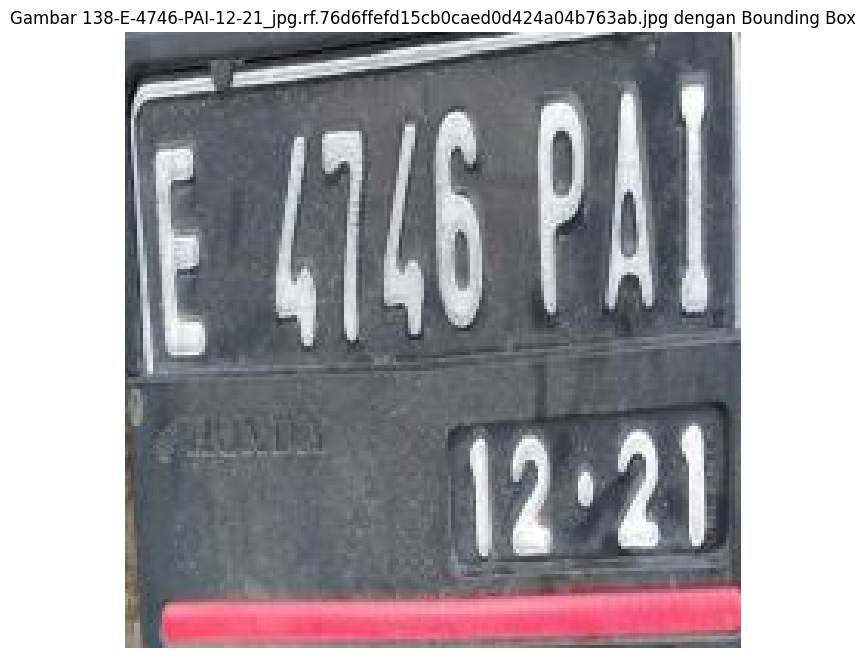

Label ditemukan untuk 38-E-3747-RE-08-15_jpeg.rf.7c8255fe6ec183894d49459890010f7f.jpg


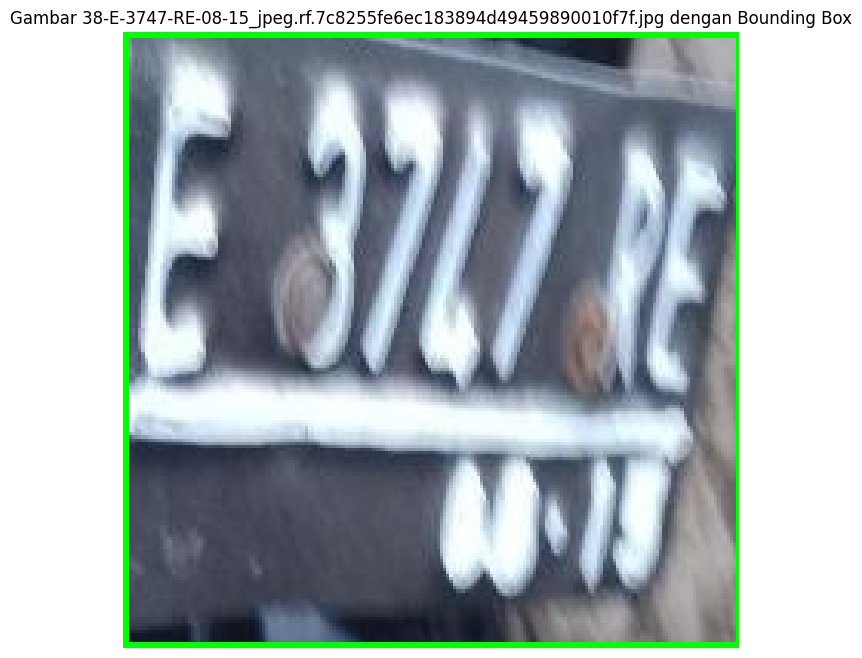

Label ditemukan untuk 183-E-5266-TS-12-22_jpg.rf.3ba1ca9a5ffe9246326e0fdb9b929d62.jpg


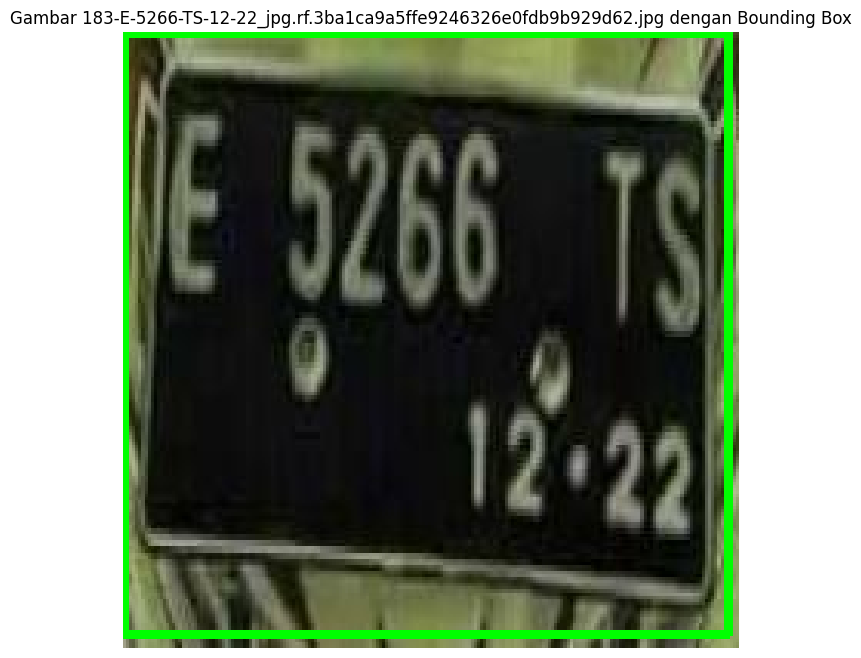

Label ditemukan untuk 106-E-4670-TL-05-22_jpeg.rf.84dafa03d39948bb8ae7474908948388.jpg


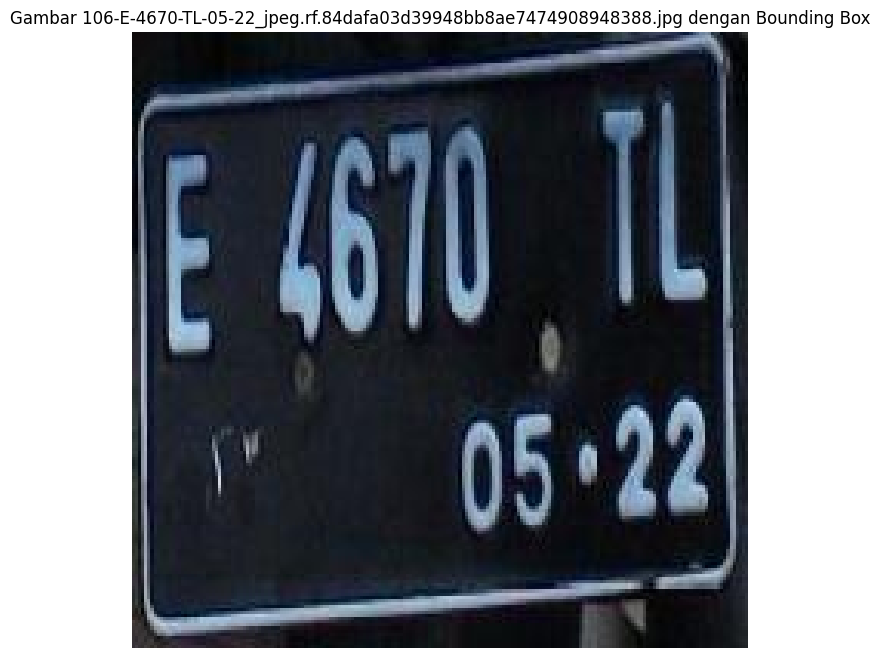

Label ditemukan untuk 166-E-2989-OZ-12-20_jpg.rf.7e2e424b64447ec657cb8d00f08177bd.jpg


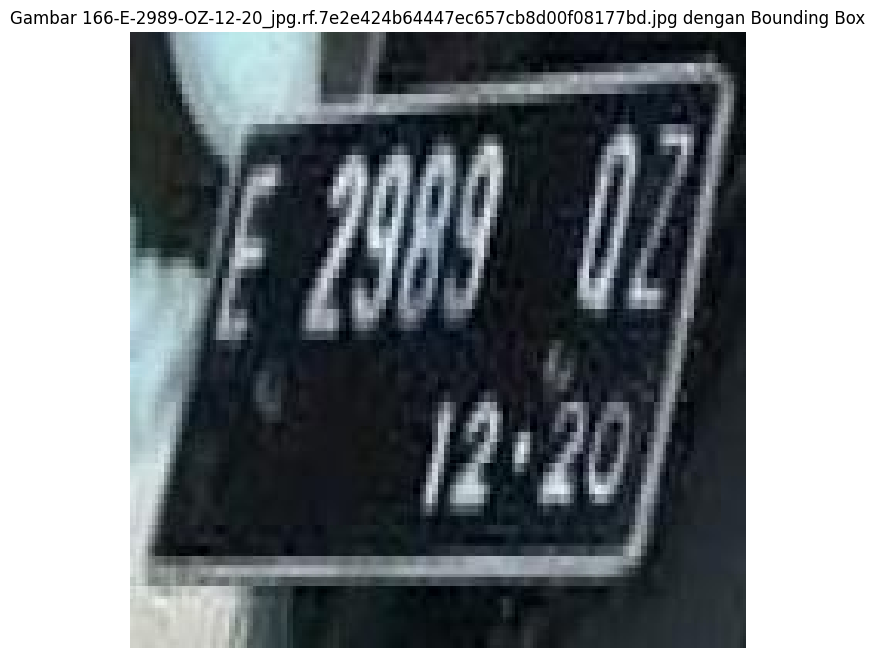

Label ditemukan untuk IMG-20180108-WA0031_jpg.rf.6ccd73dbce0ee274f649ba2967a6c882.jpg


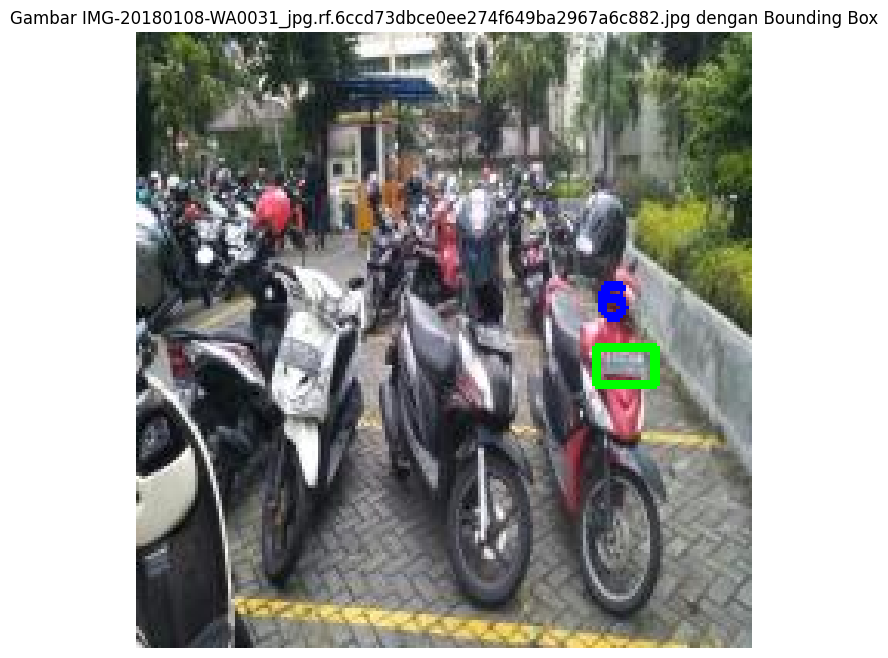

Label ditemukan untuk 324-E-5854-PAP-08-22_jpeg.rf.bd3fac22dfcf46b08306d41797e2932c.jpg


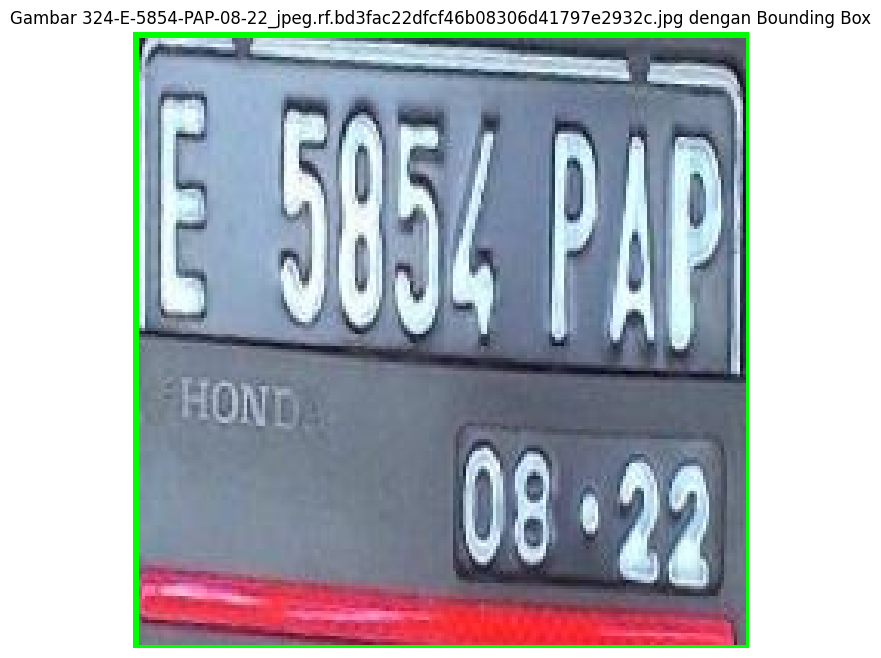

Label ditemukan untuk 20171211_110651_jpg.rf.fc3944f5512704604caf382621ed1f7c.jpg


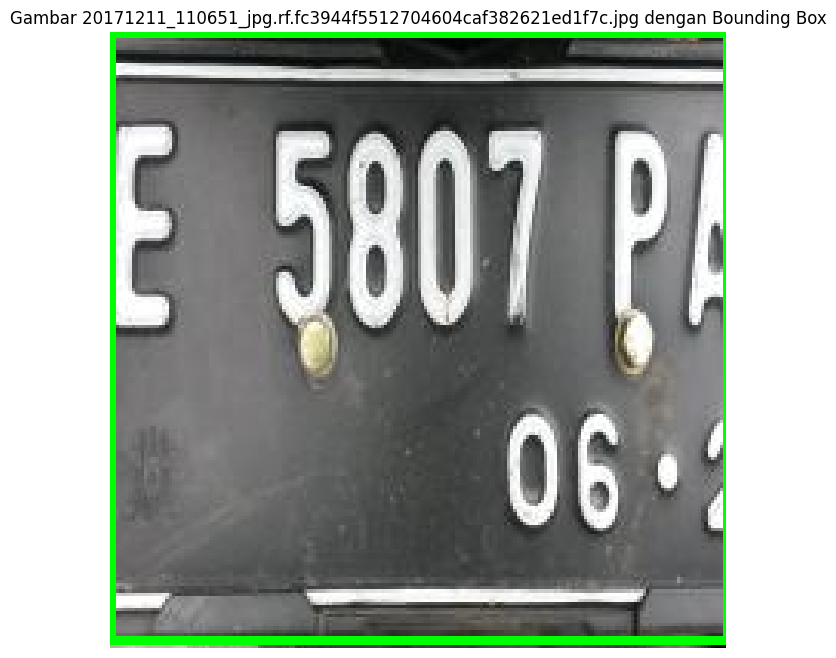

Label ditemukan untuk 326-E-3758-RW-04-18_jpeg.rf.6d6b2cf0d83e2478d1796040541c9c27.jpg


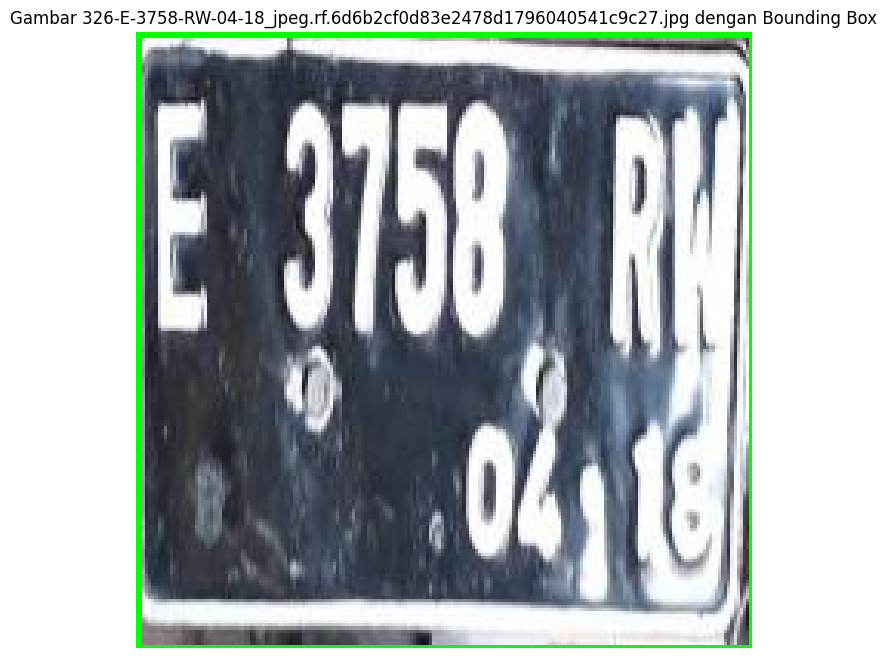

Label ditemukan untuk IMG-20180108-WA0100_jpg.rf.2b7e39aba0e09698c61f29b3c2df2f2e.jpg


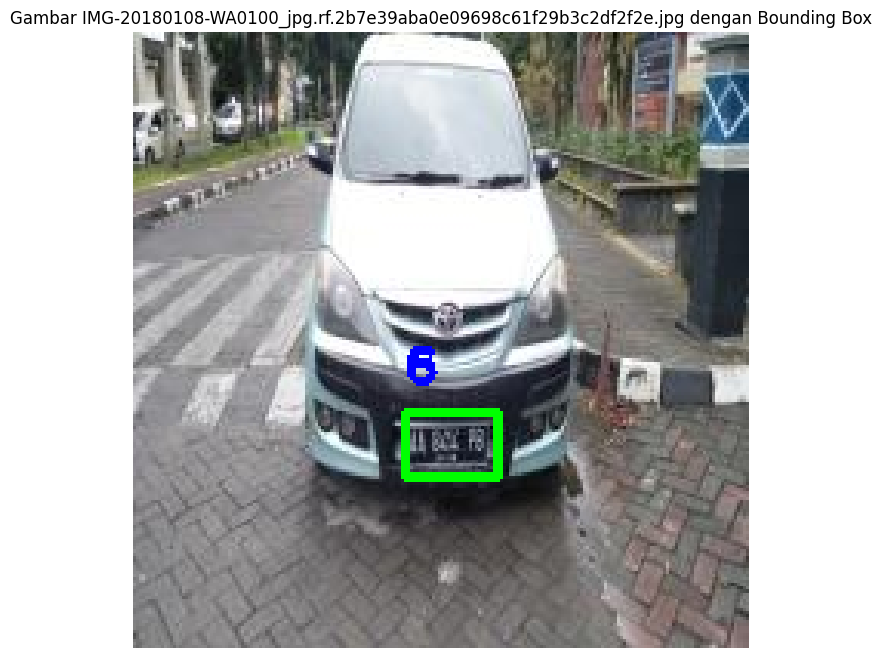

Label ditemukan untuk IMG-20180108-WA0088_jpg.rf.58eb483848e23933738542a32fa21ea5.jpg


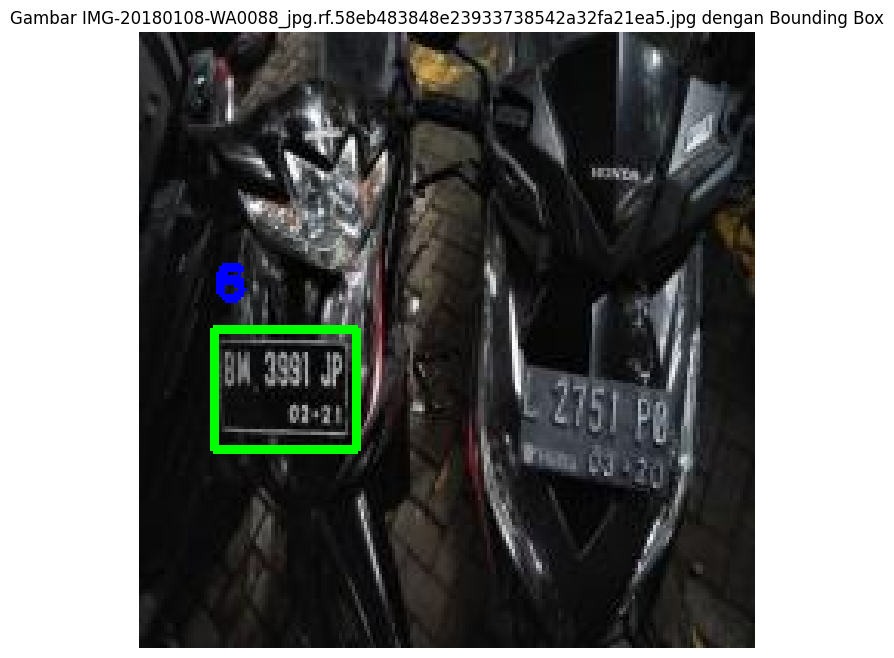

Label ditemukan untuk IMG-20180108-WA0018_jpg.rf.15d3d693d232d967f79284283250ce5e.jpg


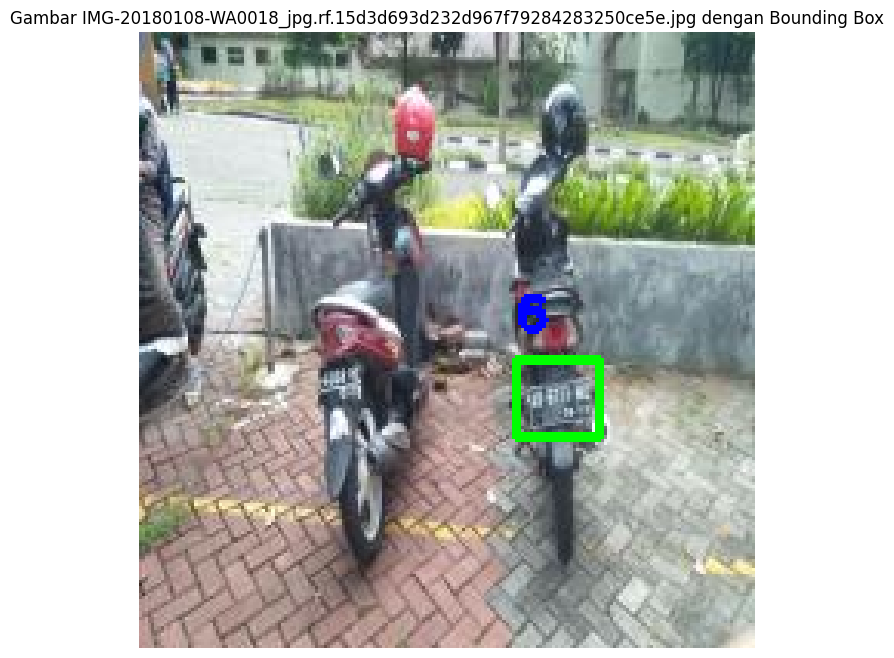

Label ditemukan untuk 297-E-1169-PY-05-20_jpg.rf.692a18809f3dc2a2b17137fedbc41453.jpg


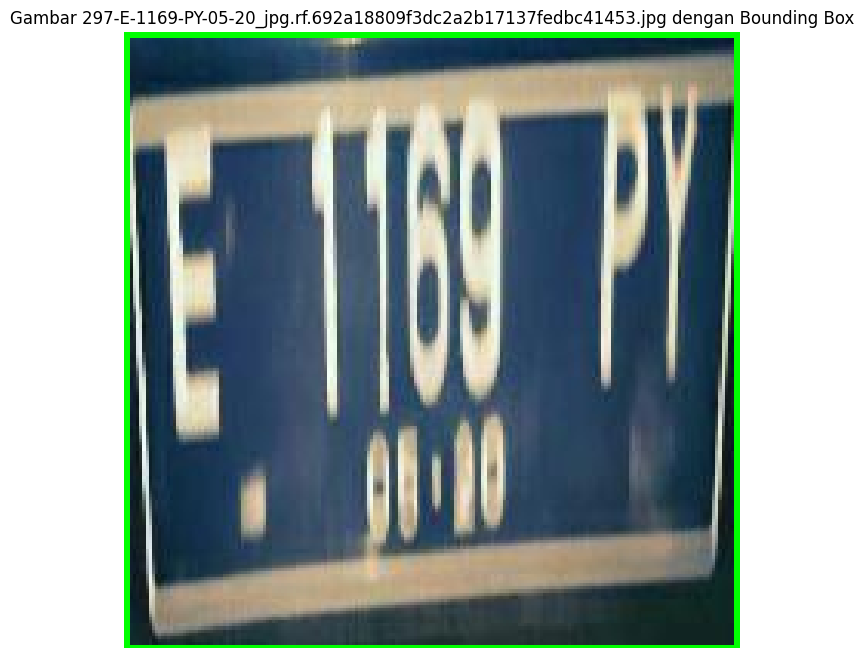

Label ditemukan untuk 156-E-3426-SB-10-18_jpg.rf.6c8352d0cd60d408607e2cfb03e8f364.jpg


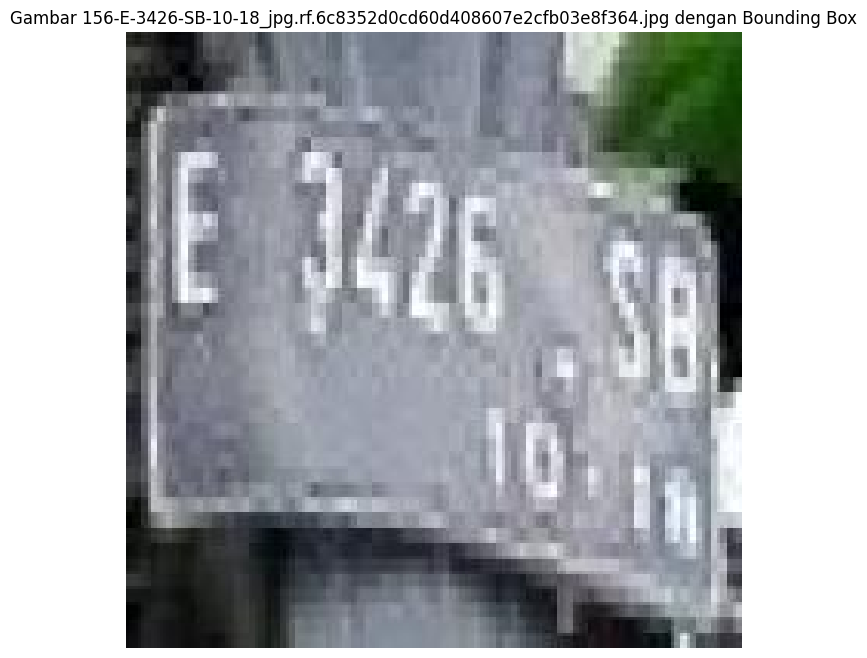

Label ditemukan untuk 20171214_121655_jpg.rf.f91e4f8077586ca5c813b830f34d2d96.jpg


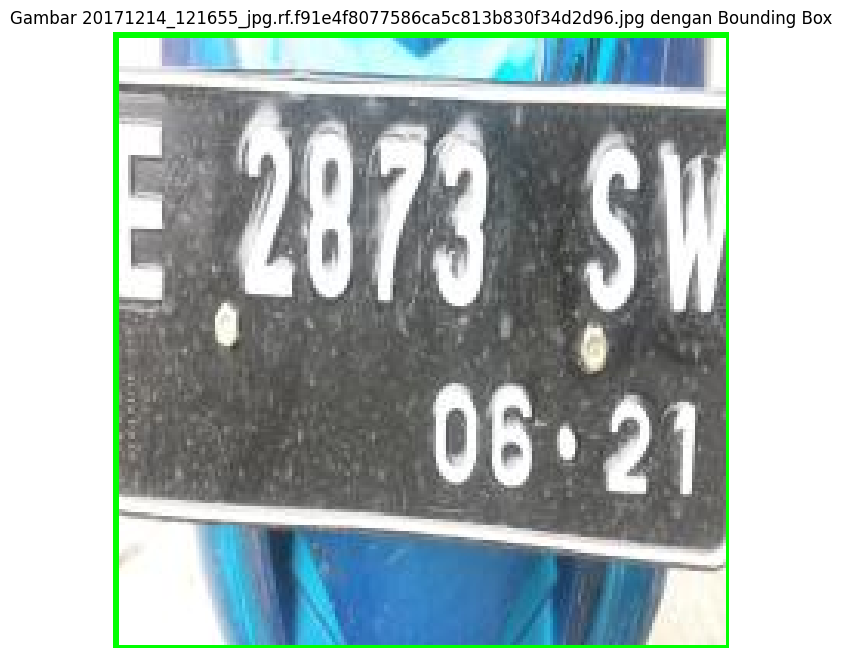

Label ditemukan untuk 288-E-2747-QQ-01-20_jpeg.rf.2e71dab5e0eb985ac1f72130dd6c9171.jpg


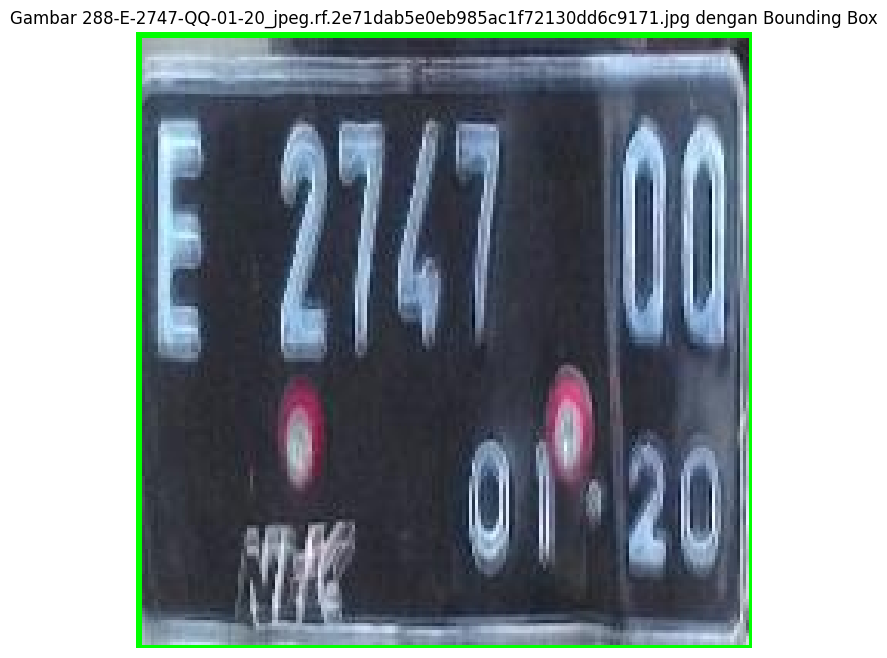

Label ditemukan untuk 349-E-4378-SG-07-19_jpeg.rf.76e014202168e50130911d9160e59255.jpg


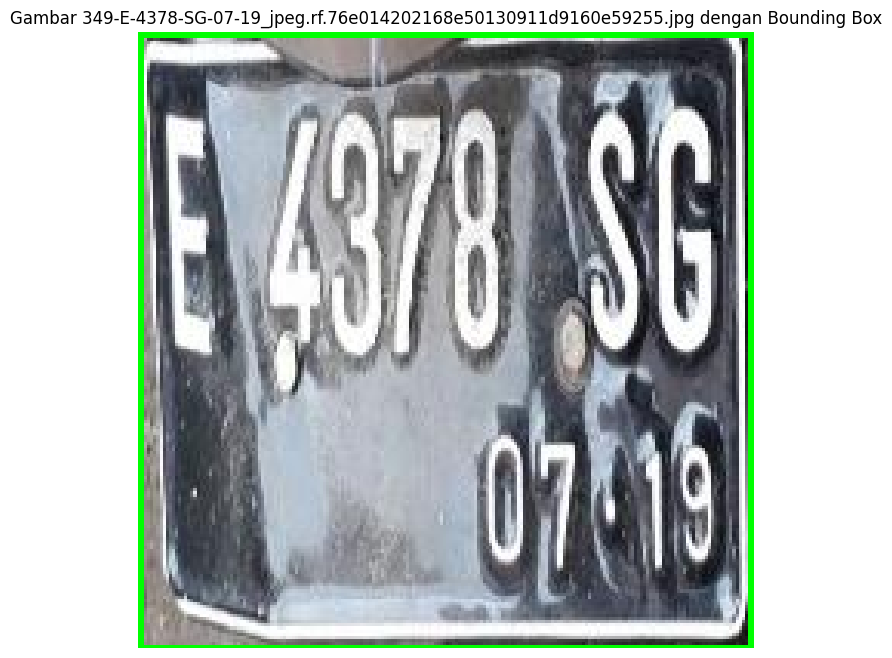

Label ditemukan untuk 132-E-6298-SS-01-21_jpg.rf.eef8ebb599a0d36e404cc4298abae48b.jpg


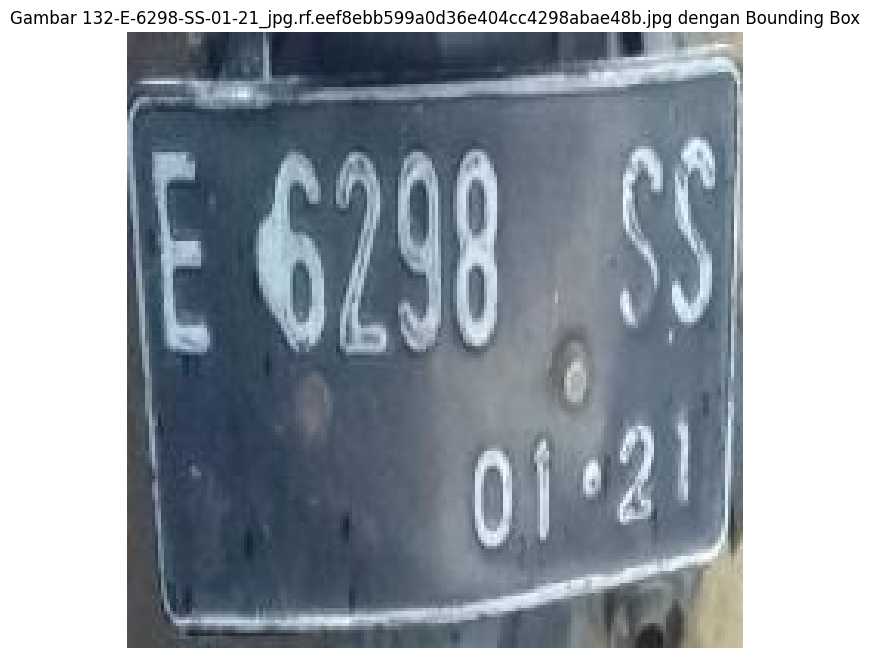

Label ditemukan untuk 88-E-3118-QP-01-20_jpeg.rf.ece73a0279d417723265c9b8e8a0a740.jpg


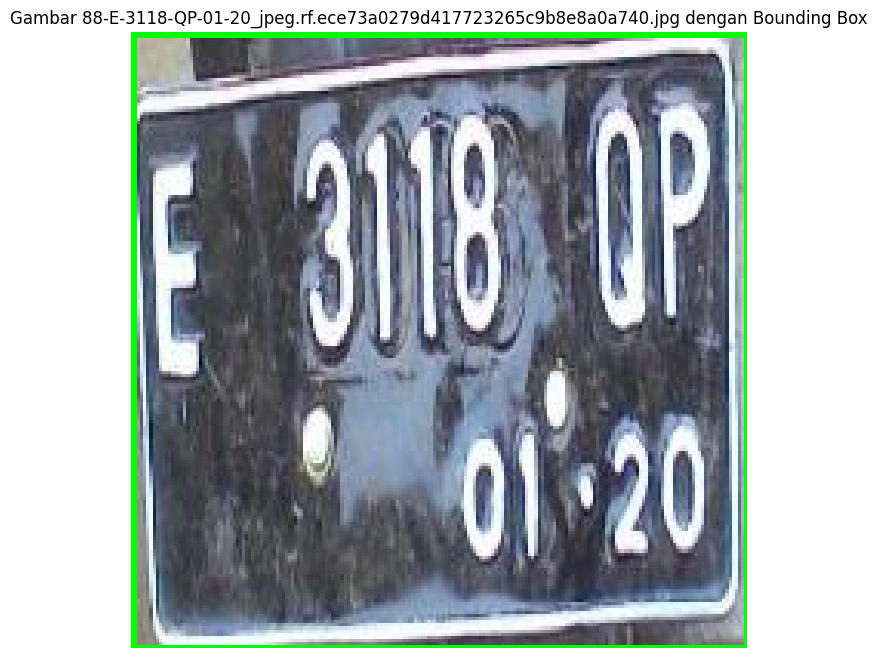

Label ditemukan untuk license-31-_jpg.rf.3ab898fa9ecbfb33decb360f6ceeeffe.jpg


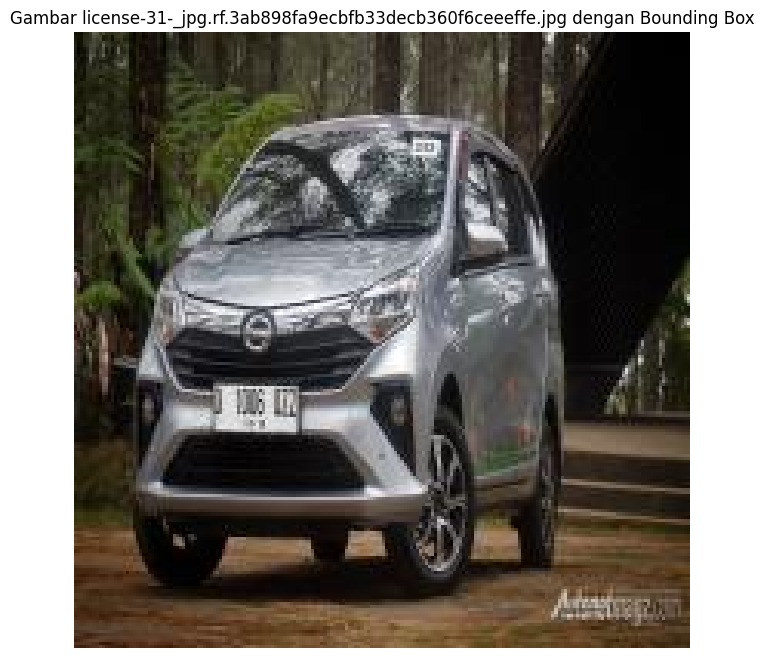

Label ditemukan untuk 1-E-3977-QM-09-19_jpeg.rf.45e5a5a6738c329c202f5f2c5ac87372.jpg


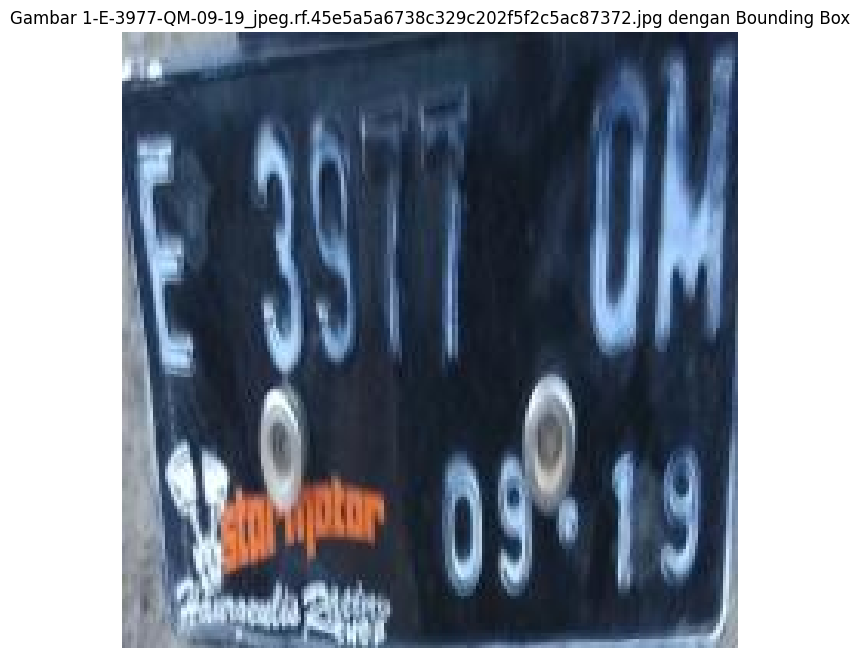

Label ditemukan untuk IMG-20180108-WA0019_jpg.rf.763f97d03379cd76ef1217cdabd915ba.jpg


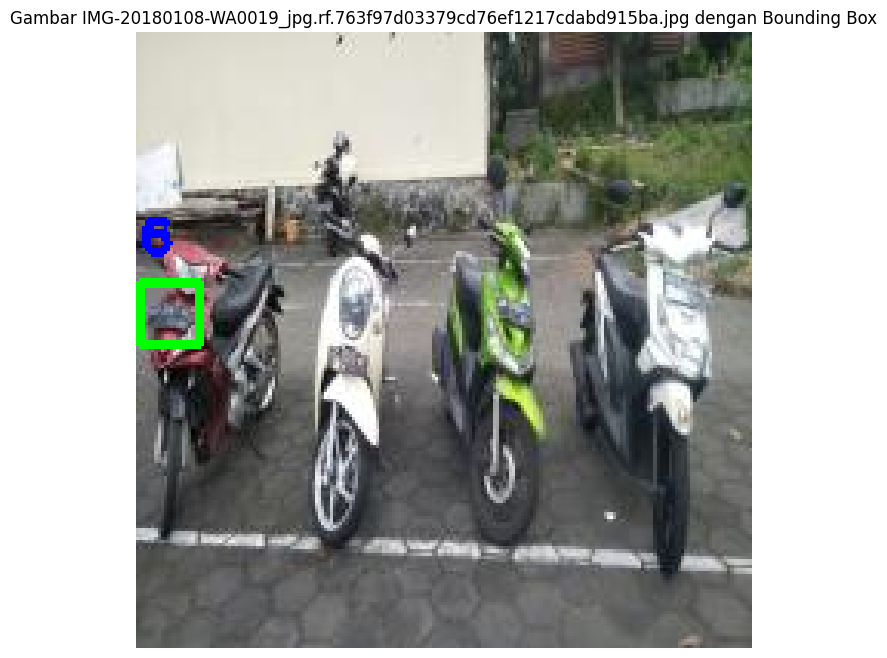

Label ditemukan untuk license-34-_jpg.rf.f8a65ab8b0faa1c8370b792af65515b6.jpg


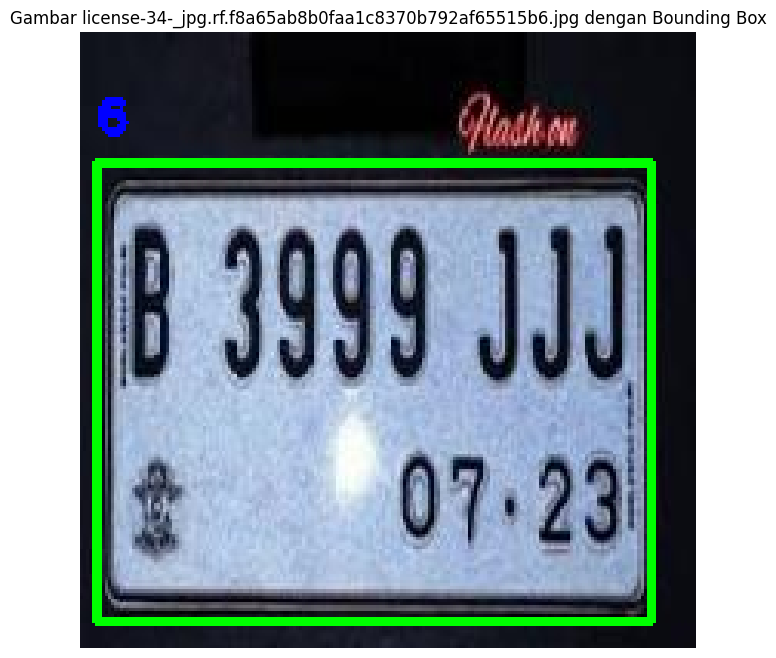

Label ditemukan untuk IMG-20180108-WA0102_jpg.rf.3eb6ac1821c5fecf882b3ec2408fec1b.jpg


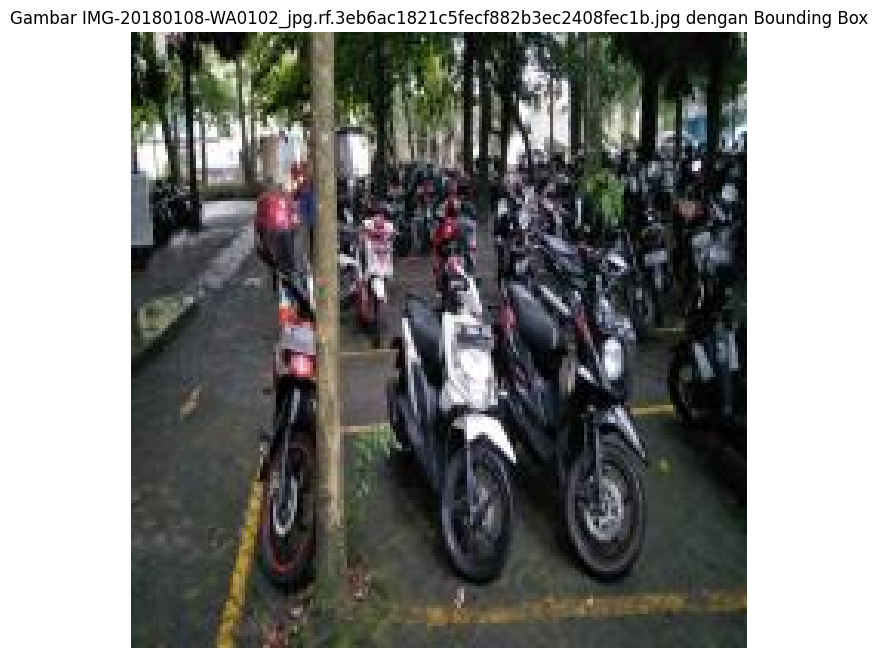

Label ditemukan untuk 101-E-4604-PS-09-17_jpeg.rf.78963f06c79b94ea72e5133311a332ed.jpg


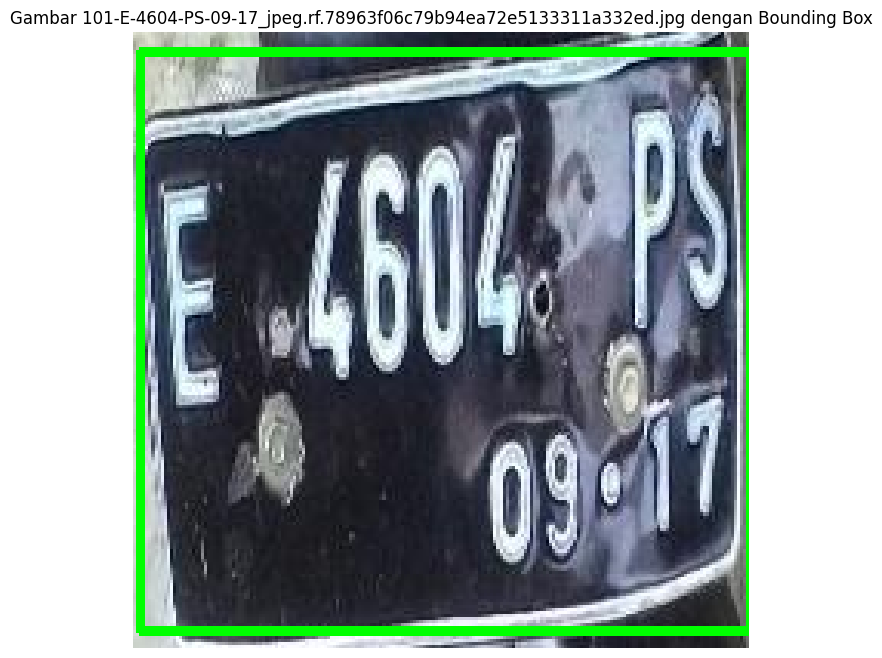

Label ditemukan untuk 358-E-3438-SJ-10-19_jpg.rf.6bfe2170634d258b6a38b6a83c4cb20b.jpg


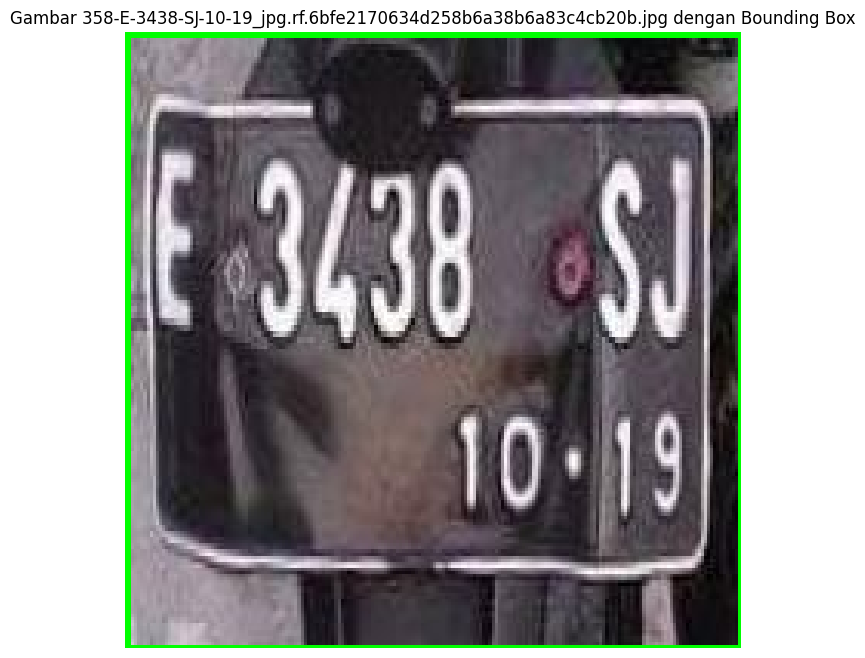

Label ditemukan untuk license-29-_jpg.rf.5050a0ae783e37e639c676d3cdd017c3.jpg


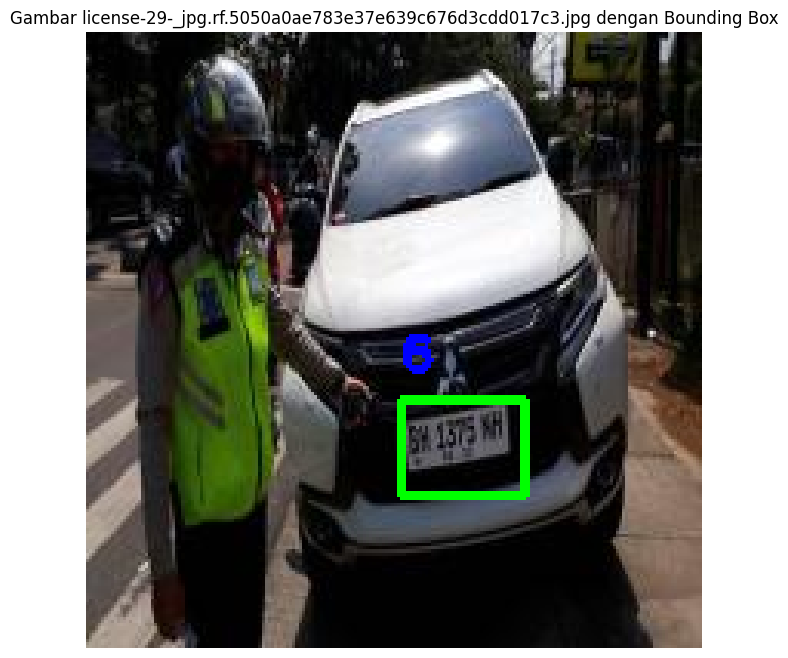

Label ditemukan untuk IMG-20180108-WA0121_jpg.rf.5435ef7a35d0b18260844c885dce6d57.jpg


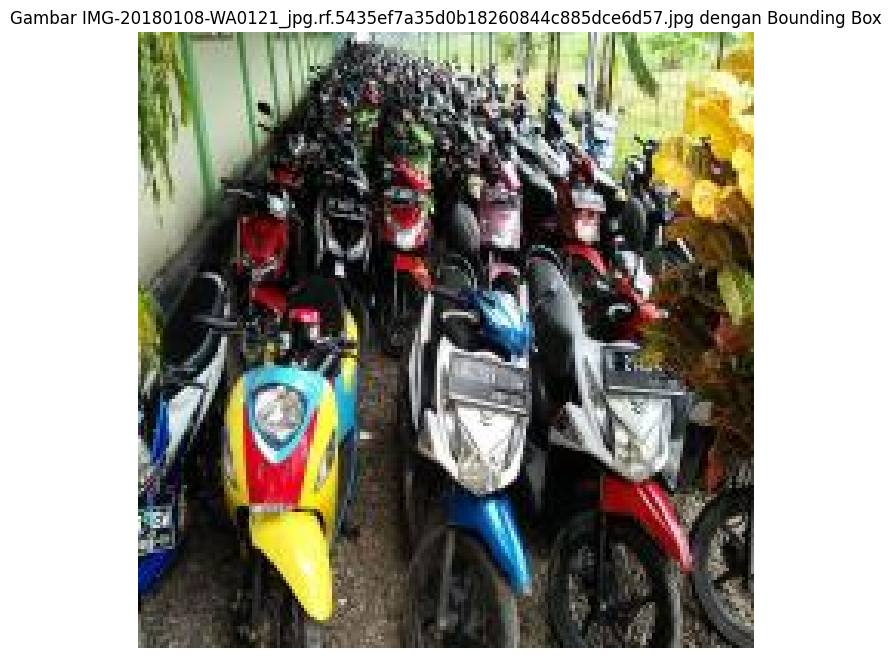

Label ditemukan untuk 98-E-2521-RQ-04-19_jpg.rf.9c7709163878414e85c7fb852292c50c.jpg


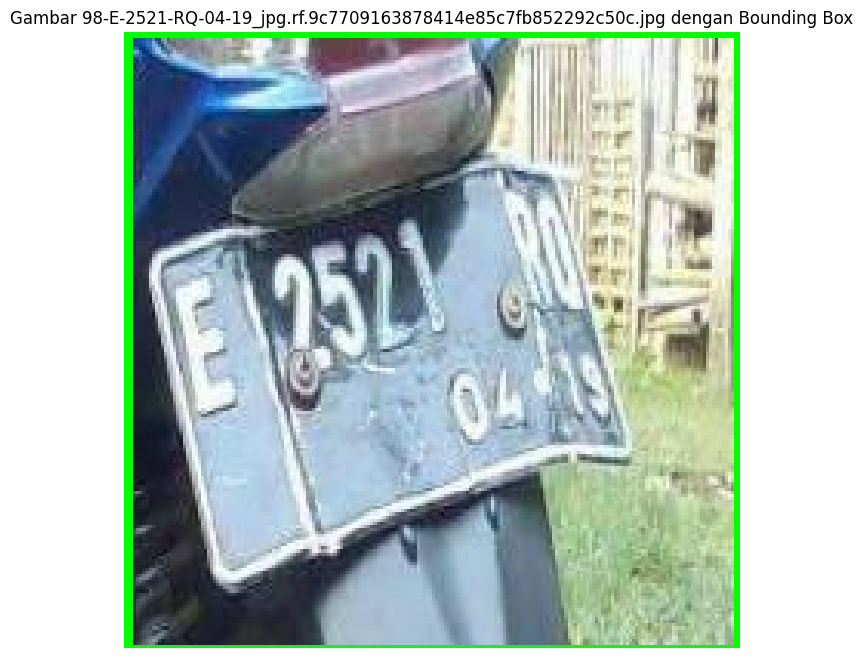

Label ditemukan untuk 255-E-6527-OD-02-20_jpeg.rf.880eb0cceba2661829b1774ebebbb3c5.jpg


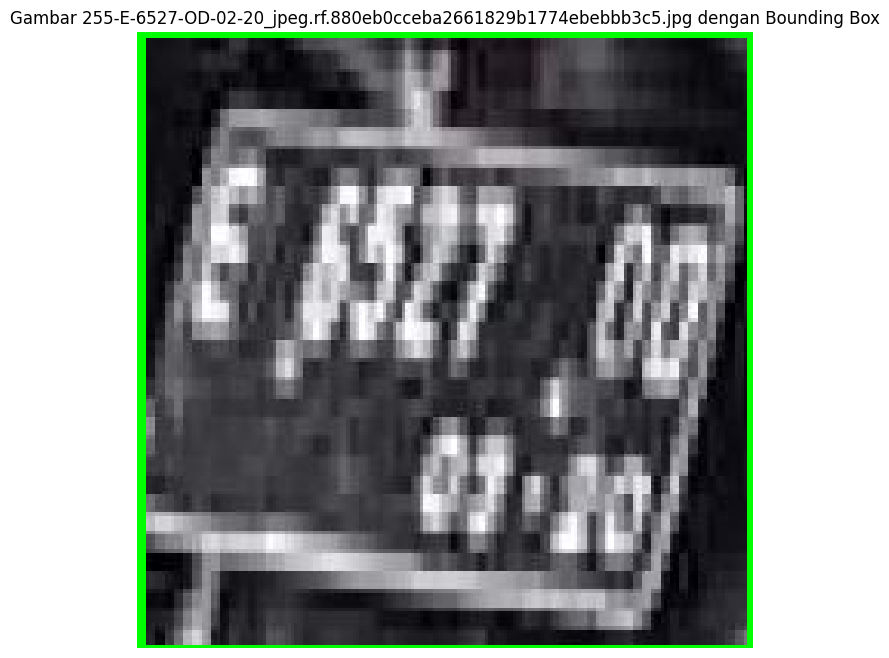

Label ditemukan untuk IMG-20180108-WA0023_jpg.rf.eda1d3a5fa1e875f2f5c86aedaef55c0.jpg


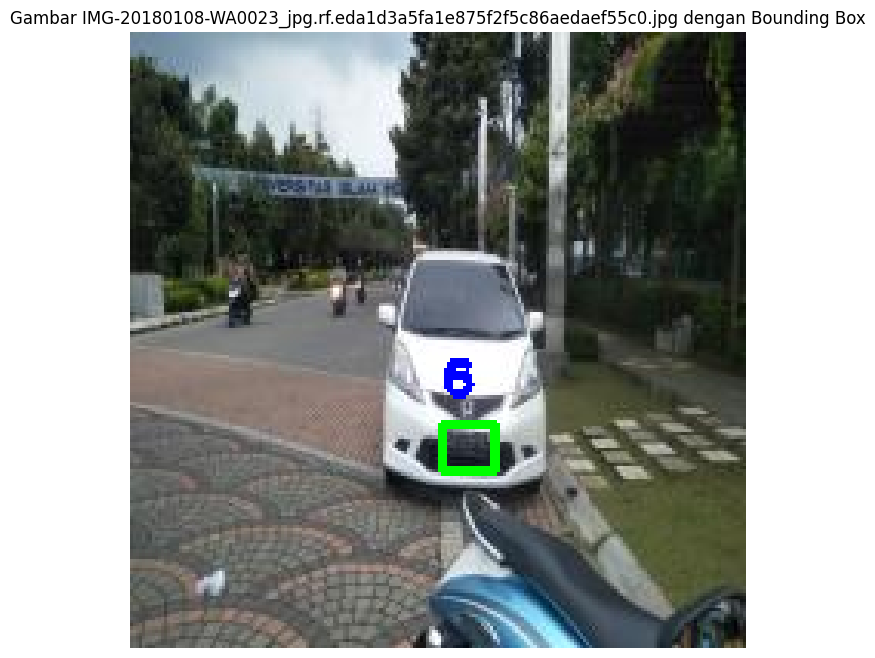

Label ditemukan untuk IMG-20180108-WA0104_jpg.rf.5d74fdc8101747837696771015d1f048.jpg


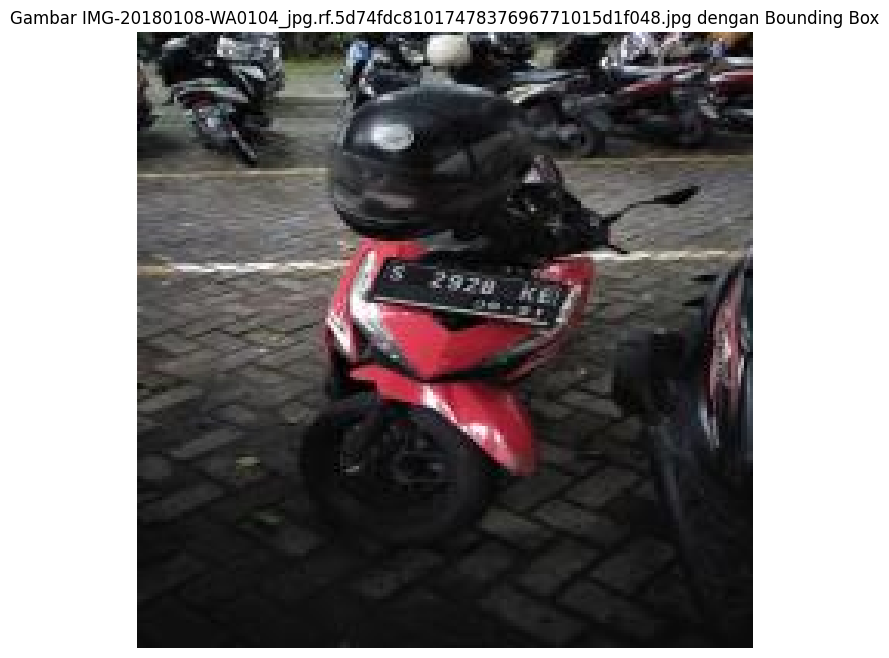

Label ditemukan untuk IMG_20230519_082853_jpg.rf.2b3c073c2b1c8d5fdce116552b18ad4a.jpg


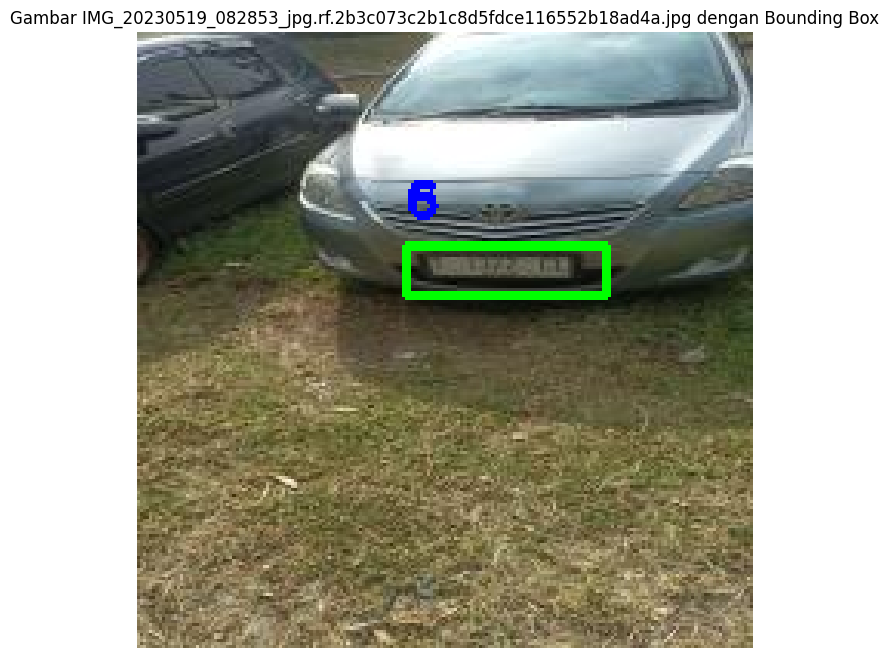

Label ditemukan untuk 20171212_141155_jpg.rf.0cee52b9212a2cba0dfe9865653b01f3.jpg


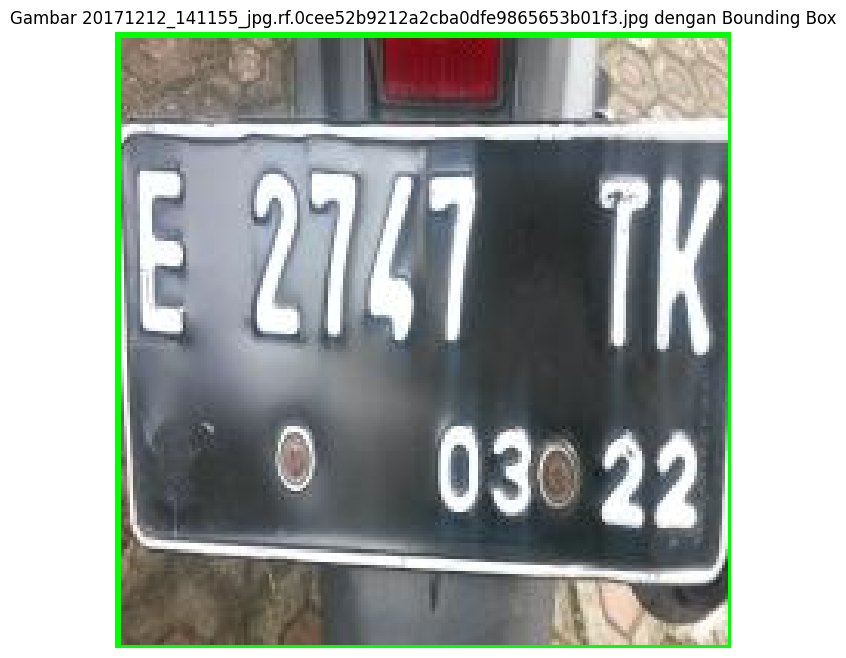

Label ditemukan untuk IMG-20180108-WA0084_jpg.rf.79faf6b35a4878d99ac29c41035a246e.jpg


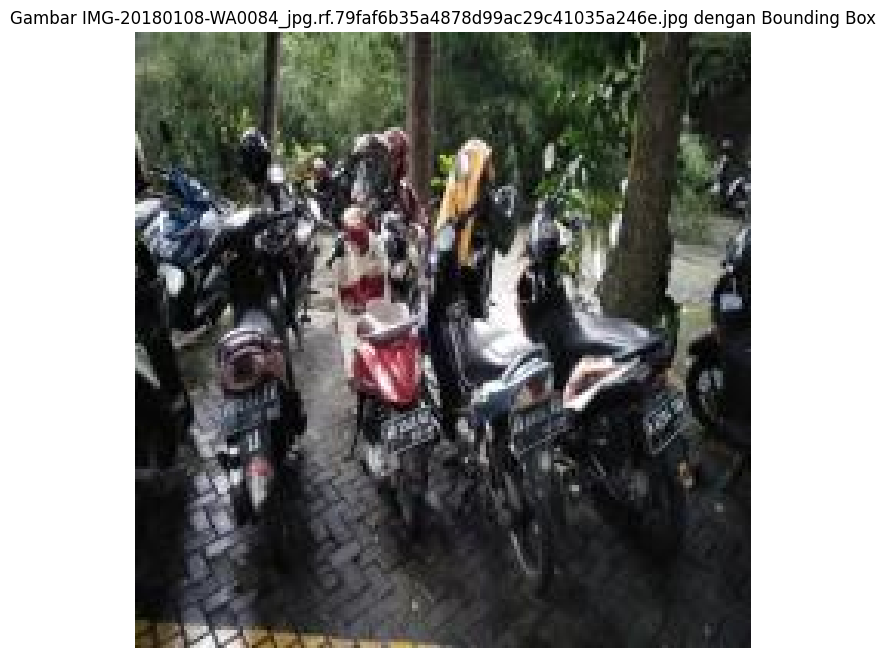

Label ditemukan untuk 315-E-6091-TV-04-18_jpg.rf.78a3e215a570b0b376b37abb3f524547.jpg


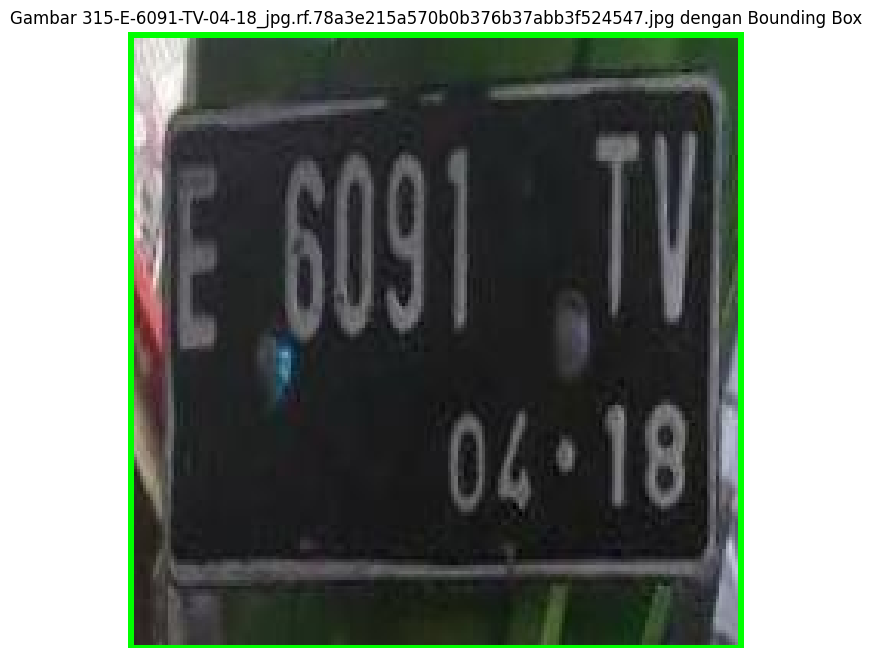

Label ditemukan untuk 20171210_212912_jpg.rf.c6d1ab719b3336890638e67be19176cc.jpg


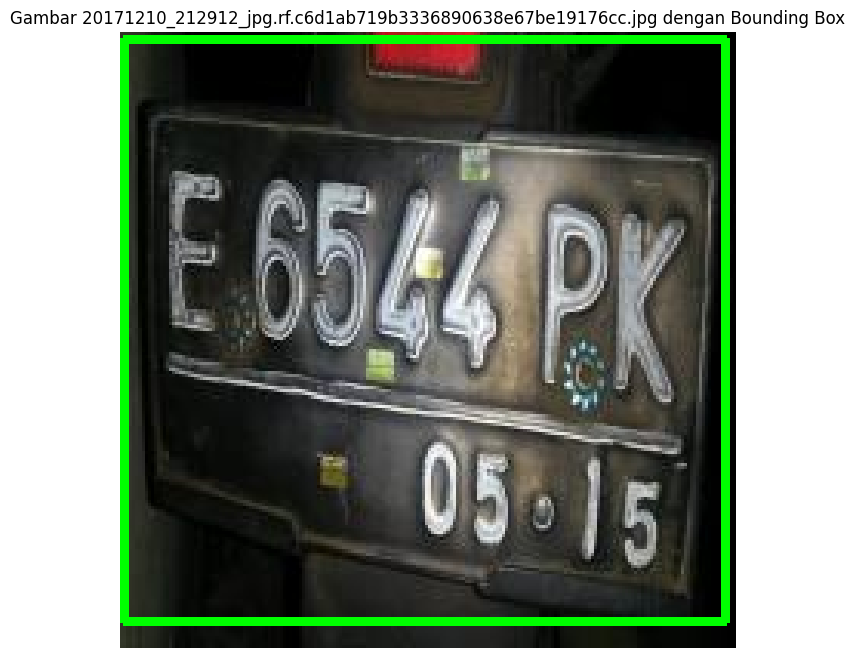

Label ditemukan untuk 167-E-4314-RP-01-22_jpeg.rf.3927a36ebe544e76953c92de9a3fa10d.jpg


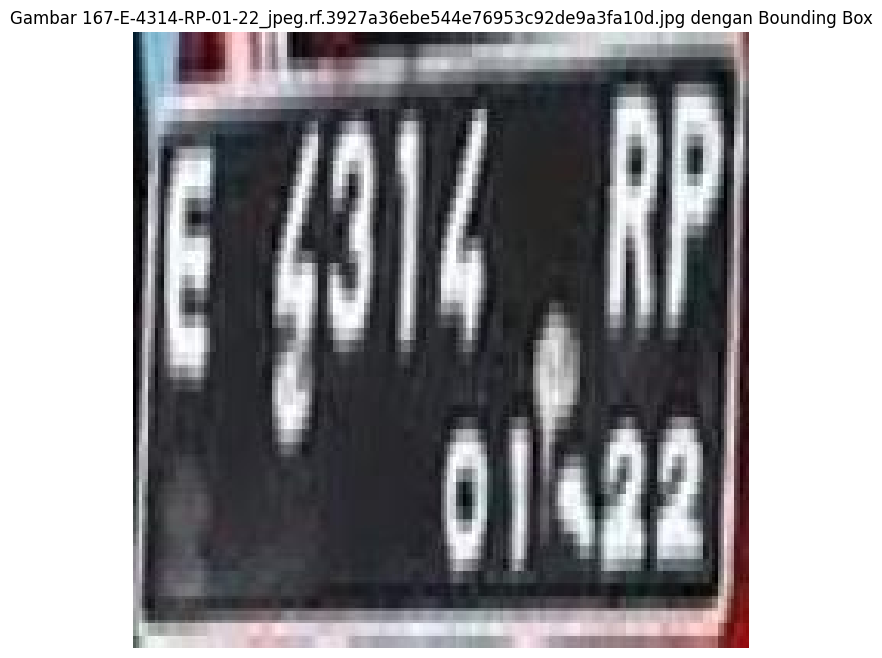

Label ditemukan untuk 346-E-6511-QV-09-20_jpg.rf.d6a1e320a3f8f2de494d683aab35fb9e.jpg


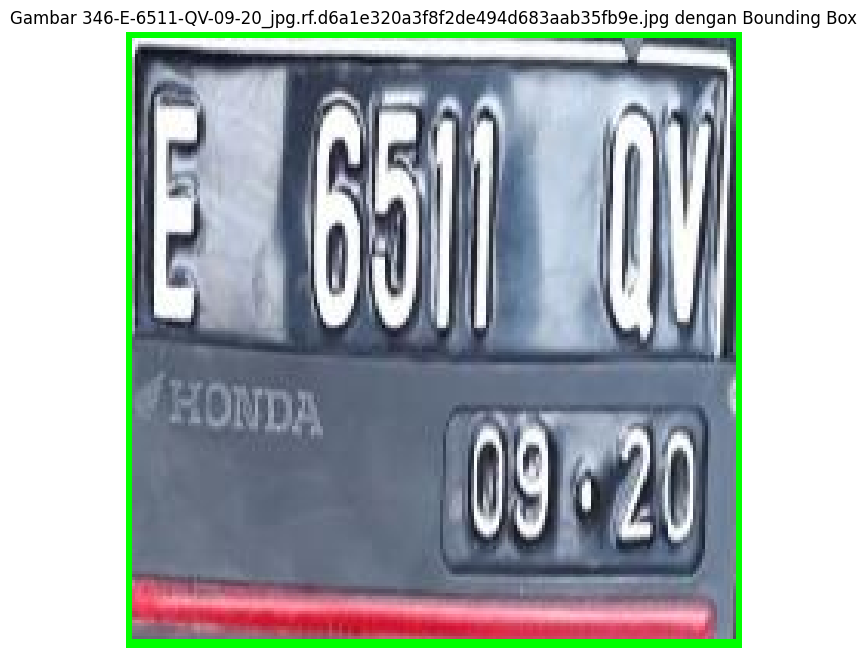

Label ditemukan untuk license-2-_jpeg.rf.ca13986c761899b4bcf55cfcc1cc5a45.jpg


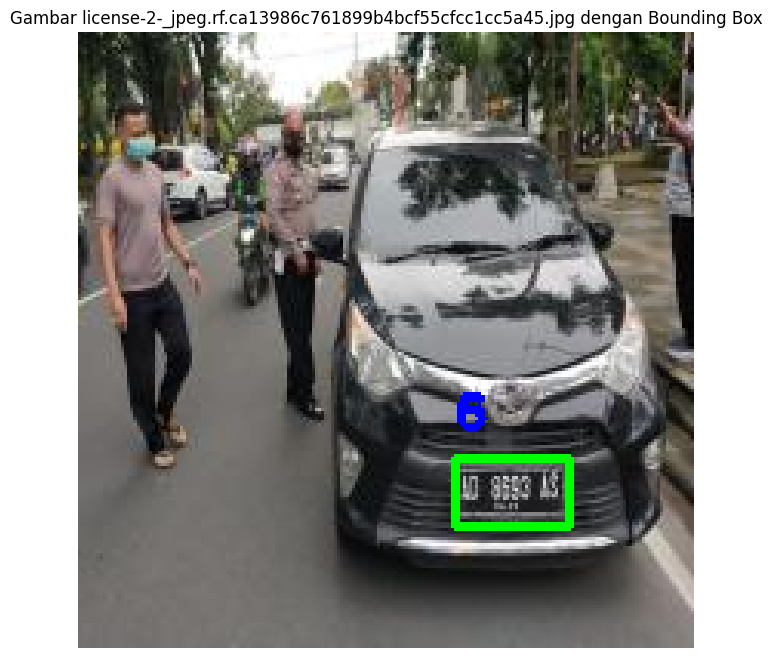

Label ditemukan untuk 147-E-2881-QAA-10-22_jpg.rf.7a131b1dcb9320da635fe0ba281ce64b.jpg


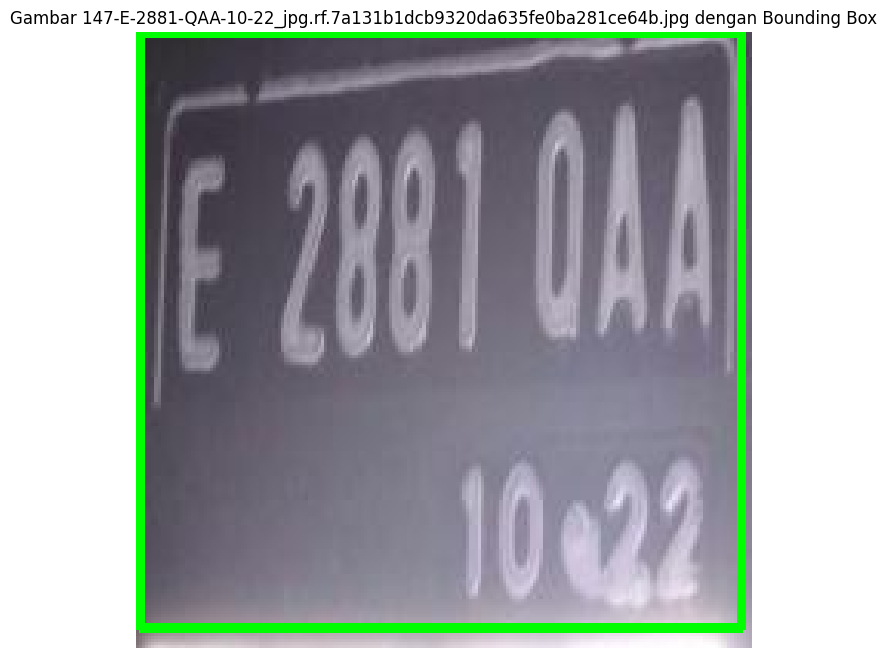

Label ditemukan untuk 202-E-2965-TO-07-22_jpeg.rf.27f9319ca2ebbb4901b77e5ba85945be.jpg


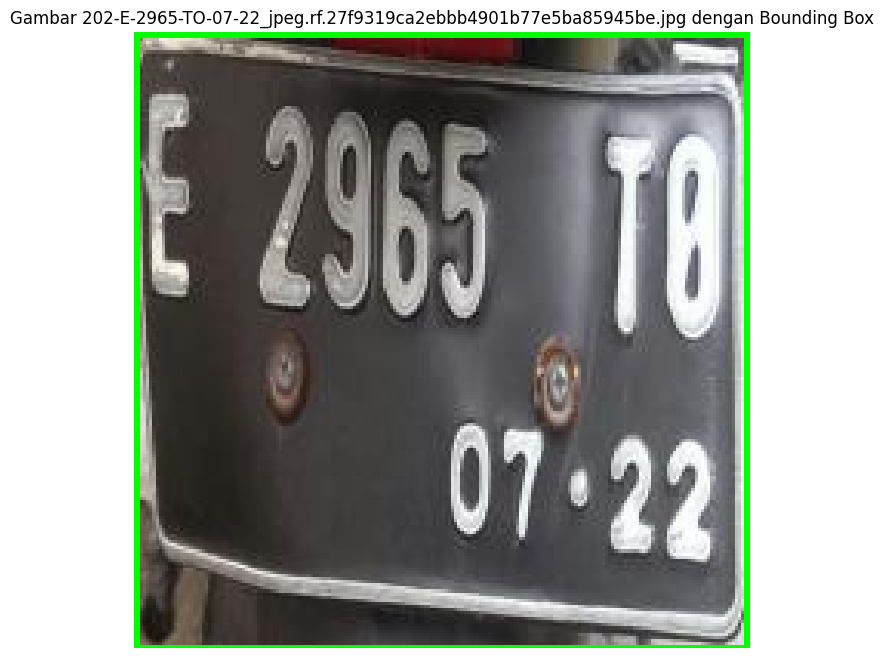

Label ditemukan untuk 103-E-6387-PL-04-20_jpeg.rf.6a6f8fb9363af186d6c84216eecb88cf.jpg


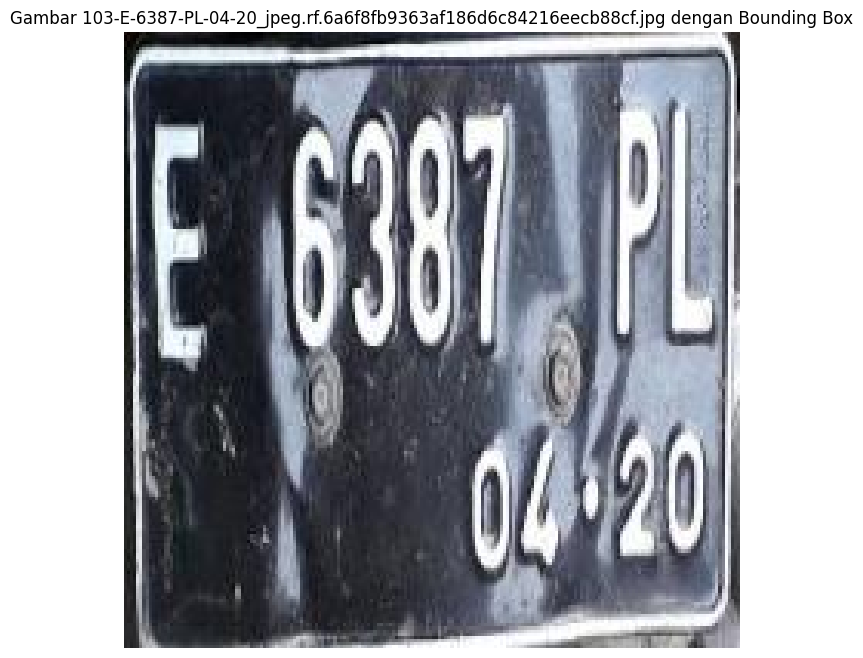

Label ditemukan untuk 24-E-6520-PAC-05-21_jpeg.rf.01a0d430f9f495ece7761c19a8c85273.jpg


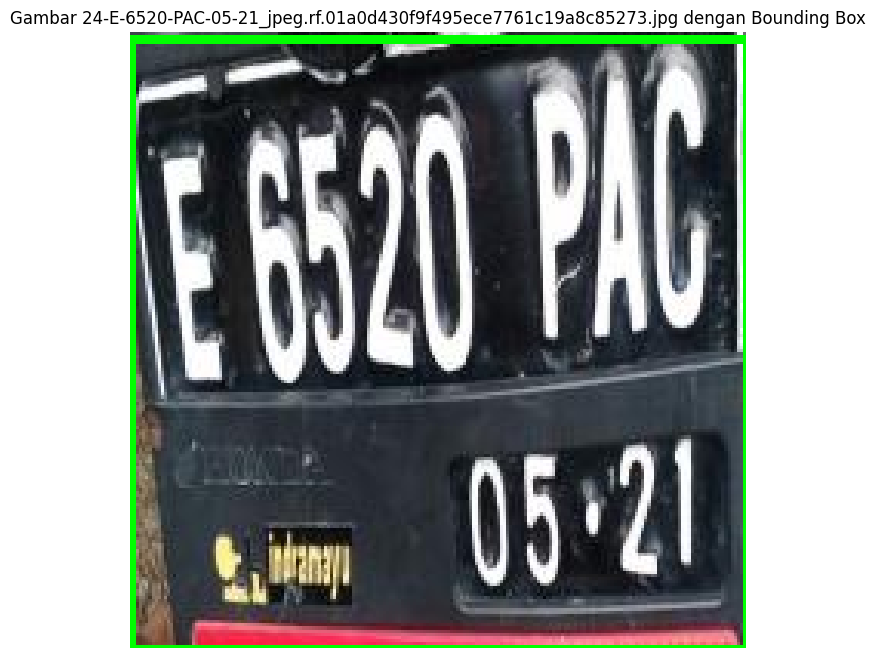

Label ditemukan untuk 62-E-3977-TH-12-18_jpg.rf.893eecea98bd359e6f42f09e9e90c1d0.jpg


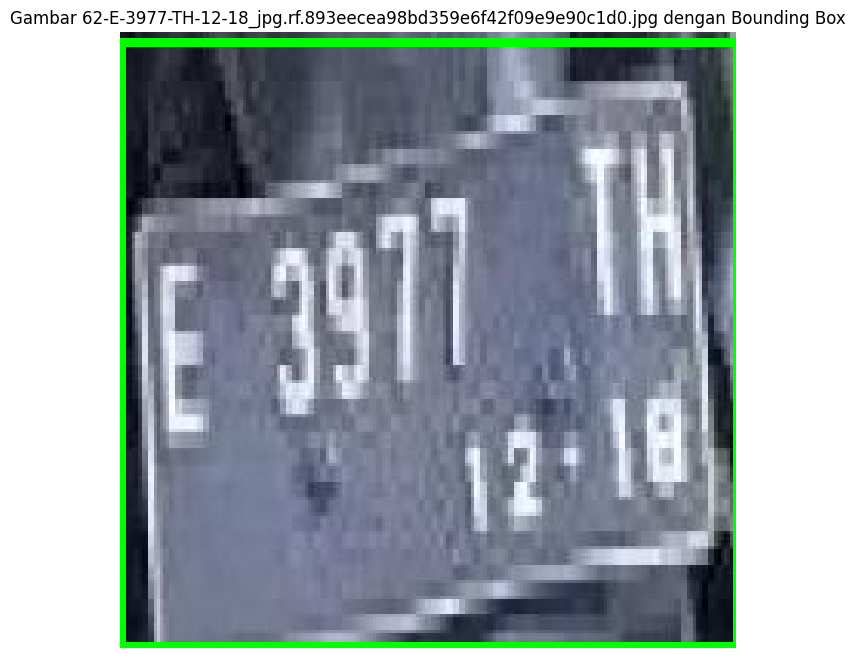

Label ditemukan untuk IMG-20180108-WA0092_jpg.rf.87f15dcdb6183348d271a707fc271700.jpg


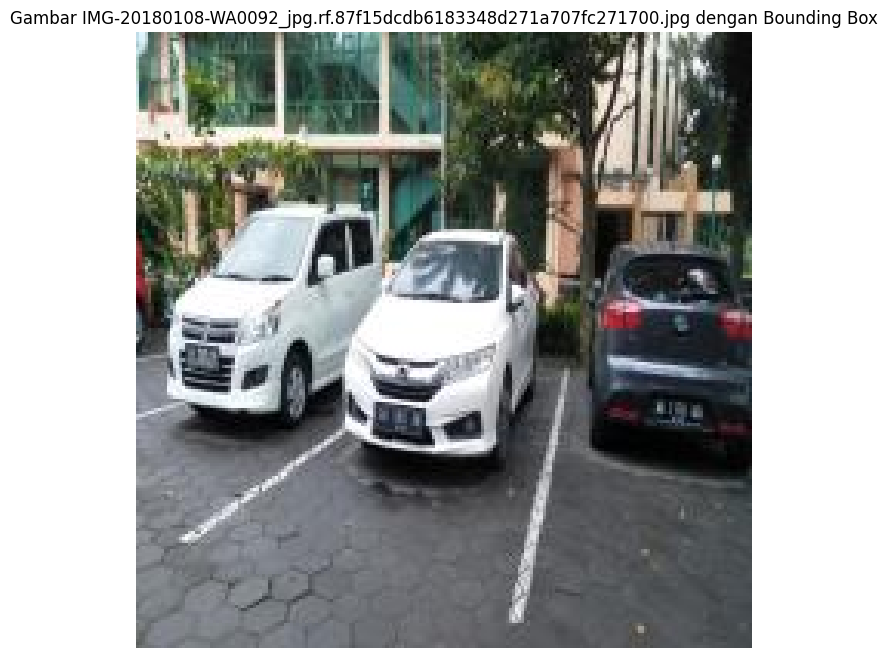

Label ditemukan untuk 34-E-2987-QC-10-18_jpeg.rf.d96a6f1c8c004de90f972ffc1829a4a3.jpg


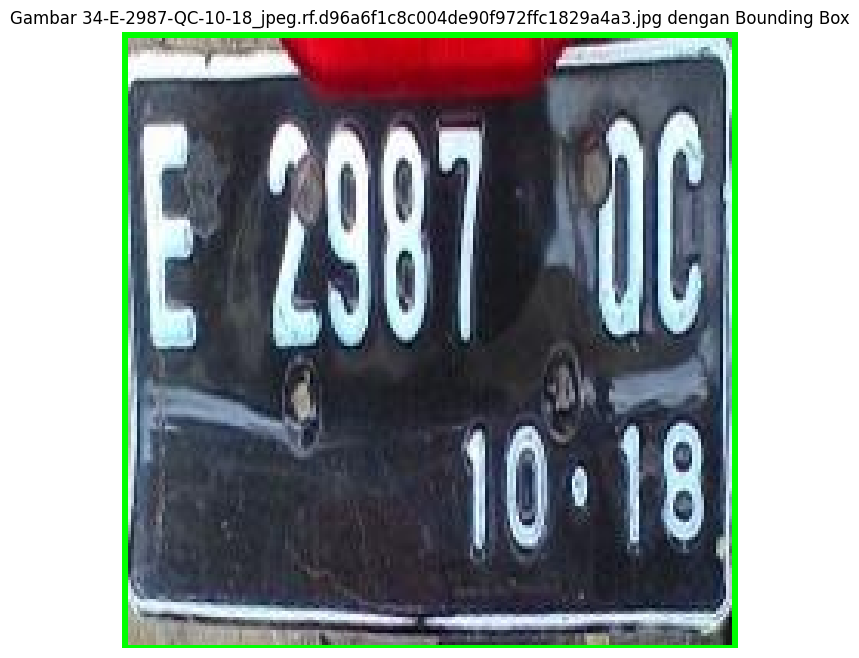

Label ditemukan untuk IMG-20180108-WA0120_jpg.rf.d5a441657323e950f714426cd7c75486.jpg


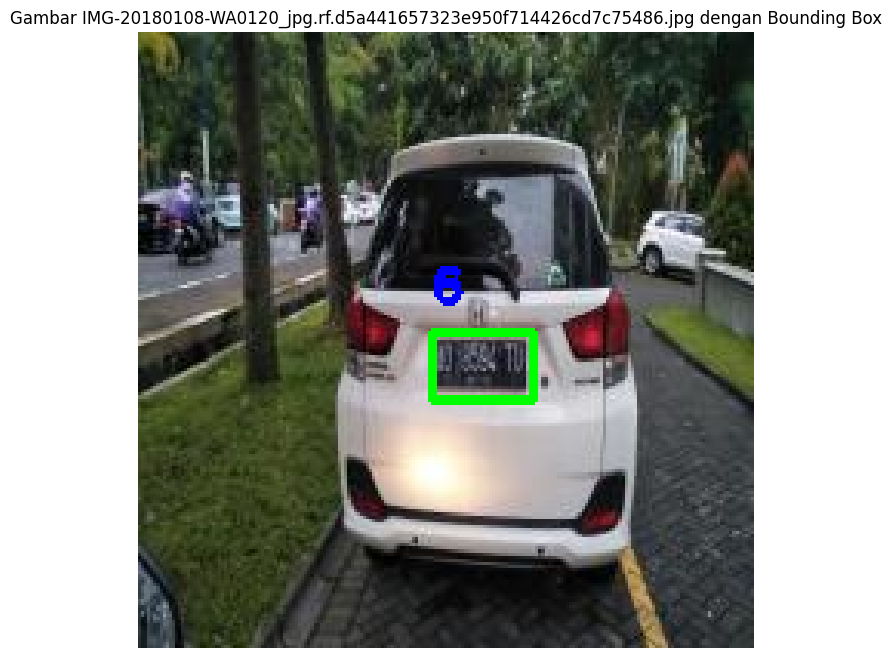

Label ditemukan untuk 320-E-3796-PY-05-20_jpg.rf.54487ce202f8d80d45462b8fdd9a26f2.jpg


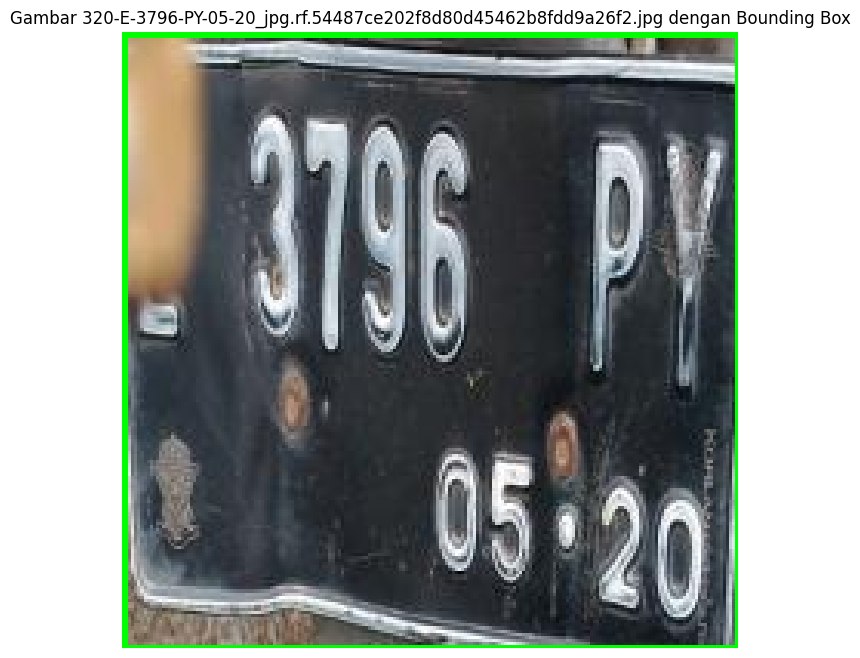

Label ditemukan untuk 2-E-6223-PAC-05-21_jpeg.rf.4903f9aba5772e8ed07ef7a1e2066cff.jpg


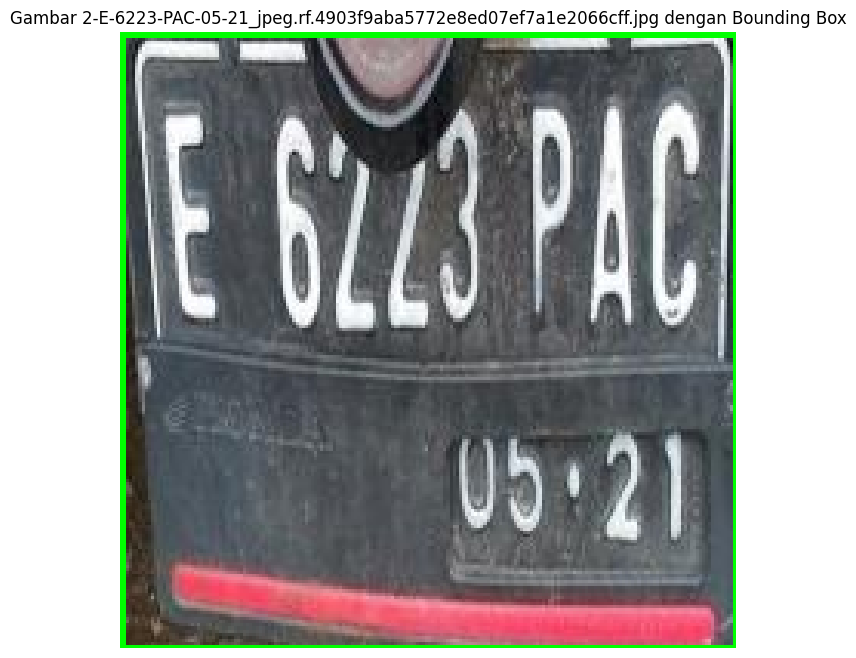

Label ditemukan untuk IMG-20180108-WA0109_jpg.rf.4cb216490958d273866cd5af9e8bf0df.jpg


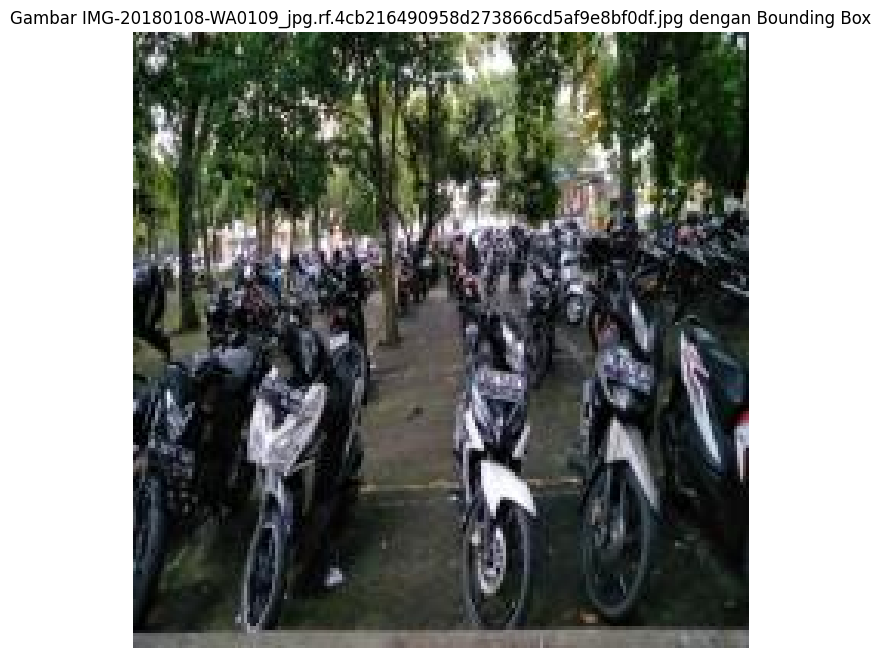

Label ditemukan untuk 204-E-6936-TF-10-21_jpg.rf.7093a8e73fa10d1da1513a6a0e3b1ed2.jpg


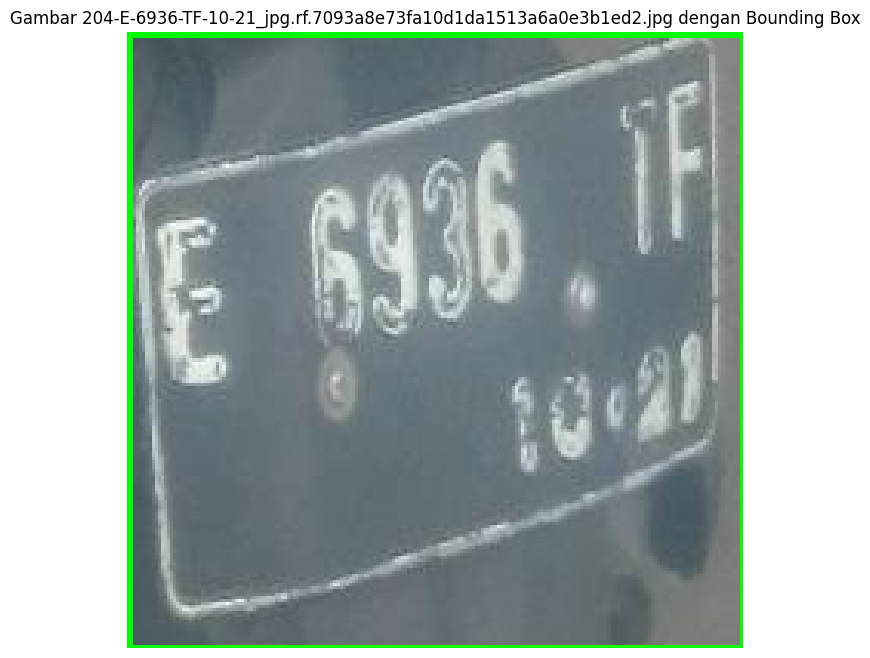

Label ditemukan untuk 58-E-5158-TP-09-17_jpg.rf.447ee8fec7cbab9e98c25feaf7402ac7.jpg


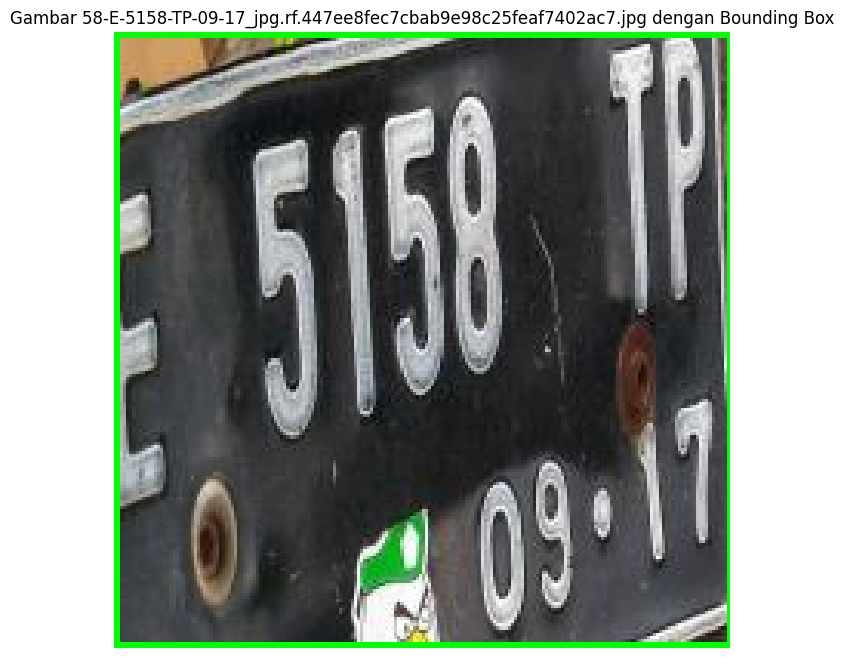

Label ditemukan untuk 92-E-3912-P-05-21_jpg.rf.e6af77e4bad3f2118b511034f1460434.jpg


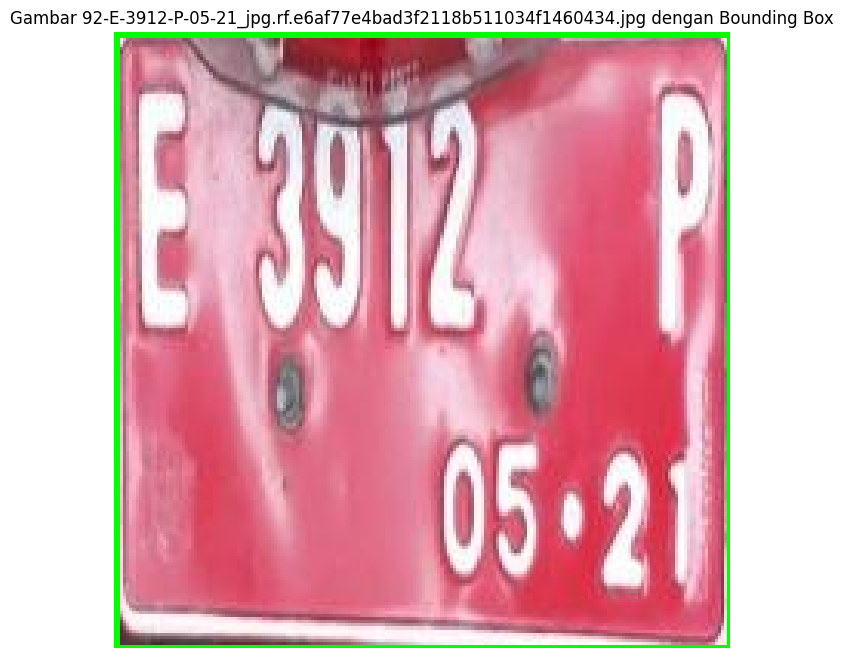

Label ditemukan untuk 351-E-6730-RC-07-19_jpeg.rf.e2737fc115717a9685b48585fb910112.jpg


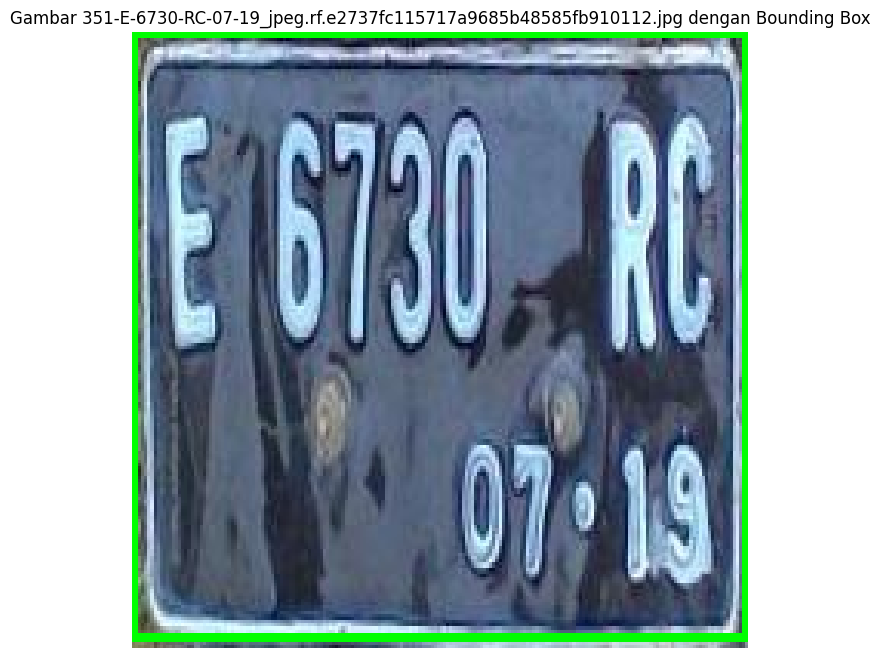

Label ditemukan untuk 116-E-5241-TP-09-22_jpeg.rf.14ae7de32f1ca702436ec333f5ebf158.jpg


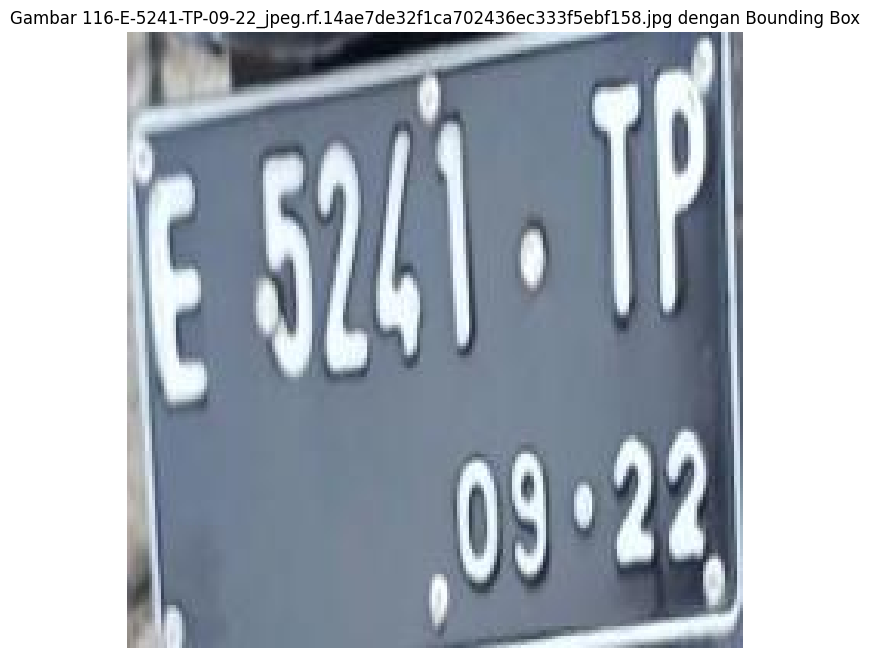

Label ditemukan untuk 341-E-6047-QT-07-20_jpg.rf.ac320a443aa256d5614fe30bdab59518.jpg


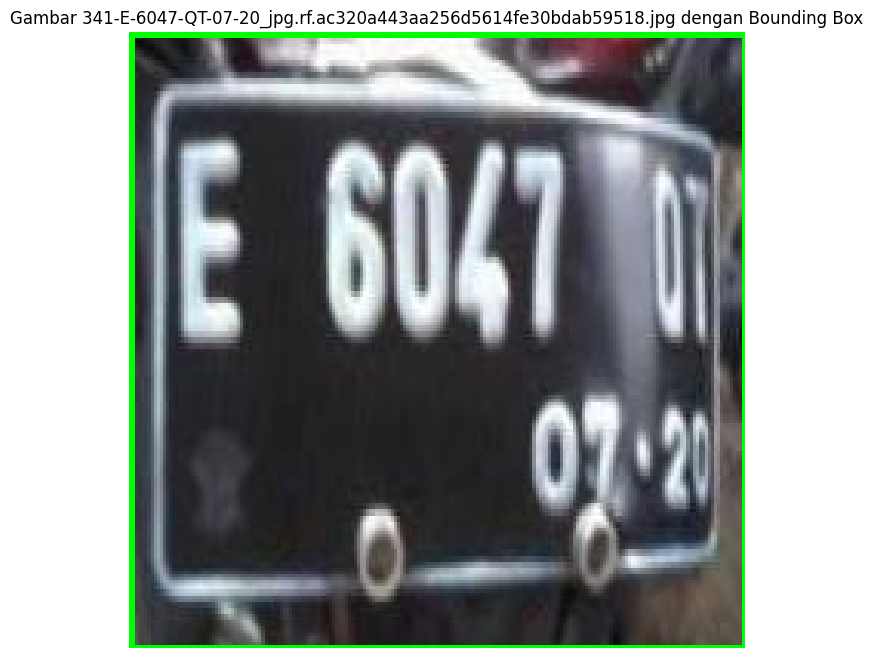

Label ditemukan untuk 36-E-4092-TJ-03-18_jpeg.rf.e5fd3321ccea38c95d0d17fe8dd8382d.jpg


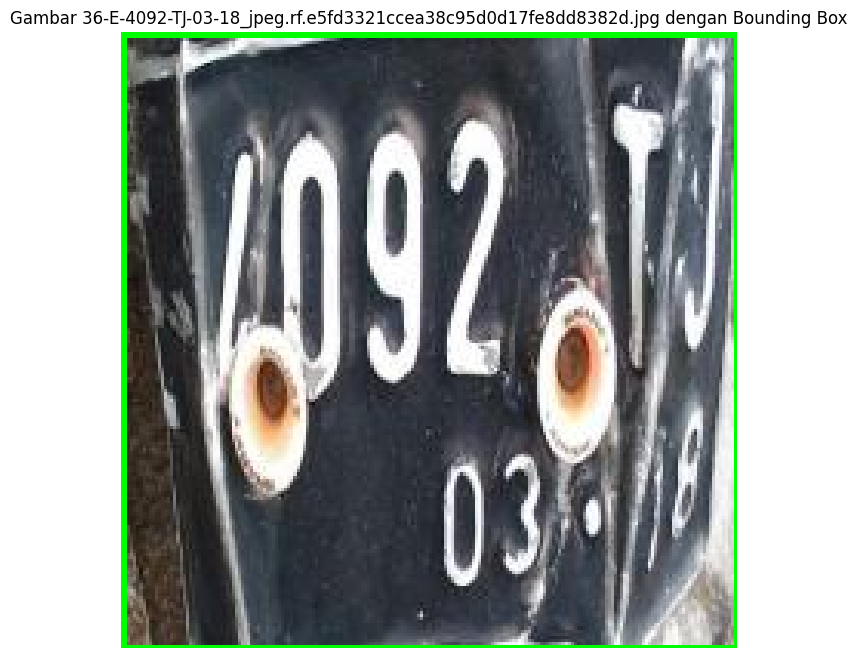

Label ditemukan untuk 258-E-2895-NB-10-13_jpg.rf.584c037efb68361f4f5d9d70a1a718e1.jpg


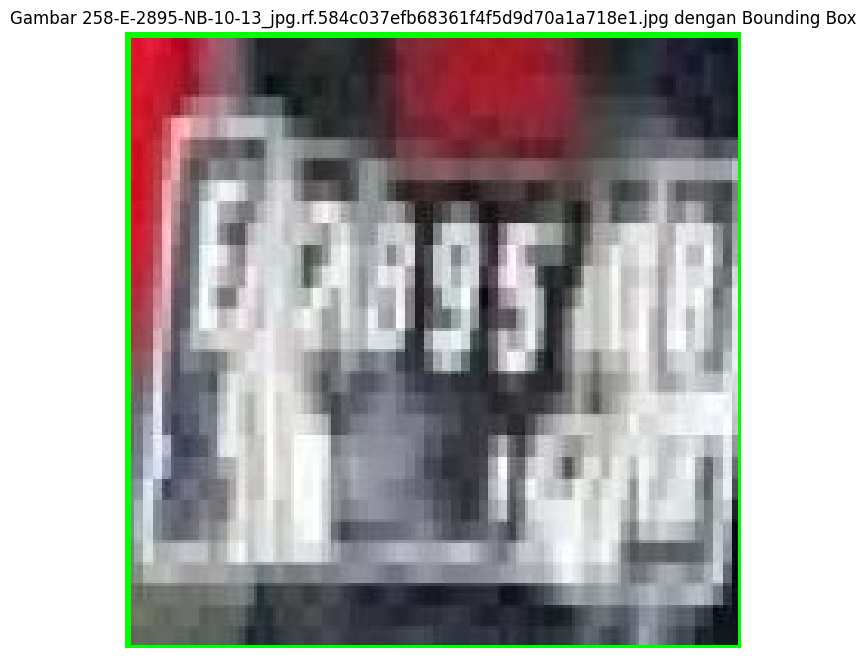

Label ditemukan untuk 89-E-6099-QS-05-20_jpeg.rf.ff92c1a14550c22a069240a82e4b9e58.jpg


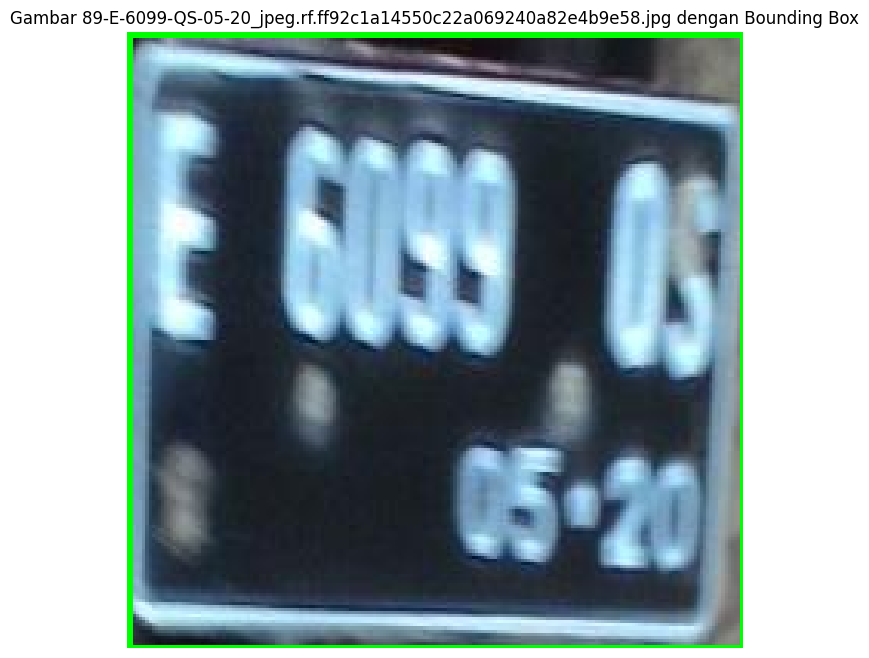

Label ditemukan untuk 74-E-2393-TT-01-18_jpg.rf.bd68aaca666d612ce1083eafd342d512.jpg


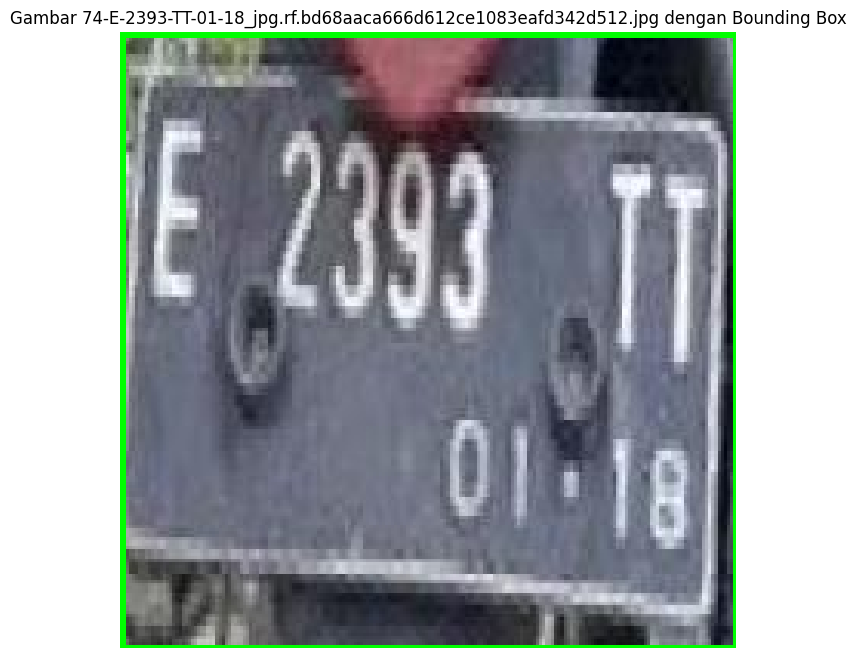

Label ditemukan untuk 82-E-4993-TI-01-22_jpg.rf.0ab49bf60cef91a7ce22683d44cae777.jpg


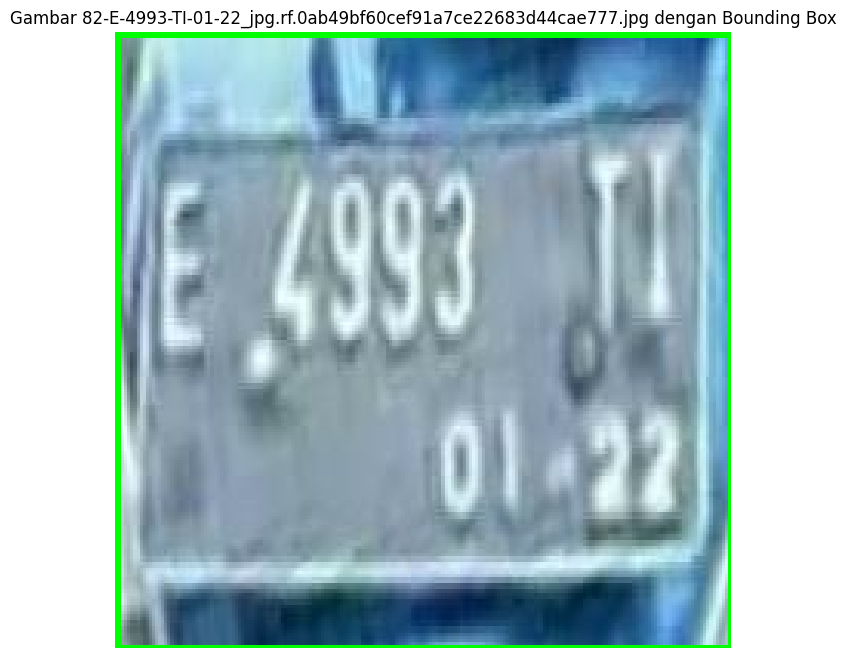

Label ditemukan untuk license-22-_jpg.rf.39af7f5b0895aeecd3aae79dead7bd9b.jpg


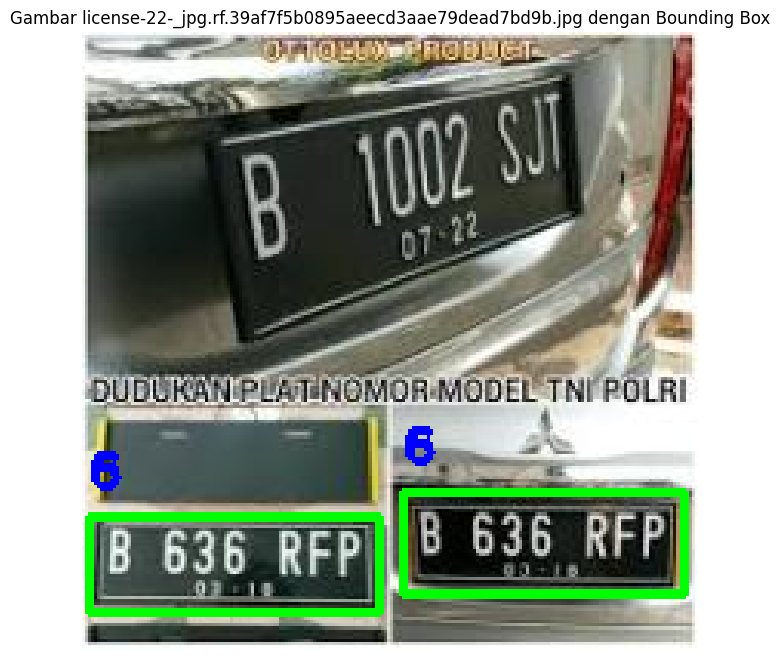

Label ditemukan untuk 194-E-6037-SF-06-19_jpeg.rf.186f93eab543d39dc5dc5bc0f8f6bdf8.jpg


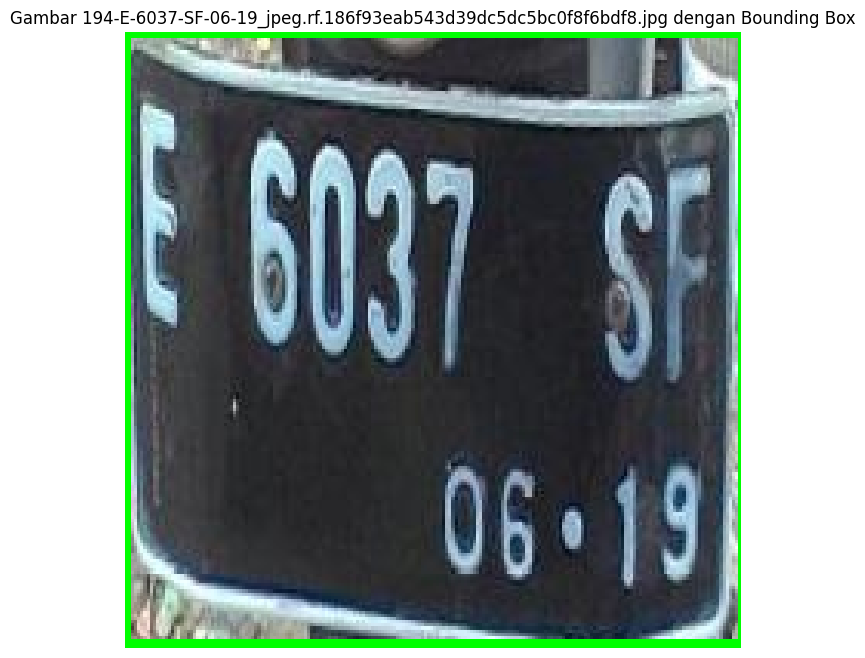

Label ditemukan untuk IMG-20180108-WA0067_jpg.rf.14de0641e160b4db4808bffa6c4443fa.jpg


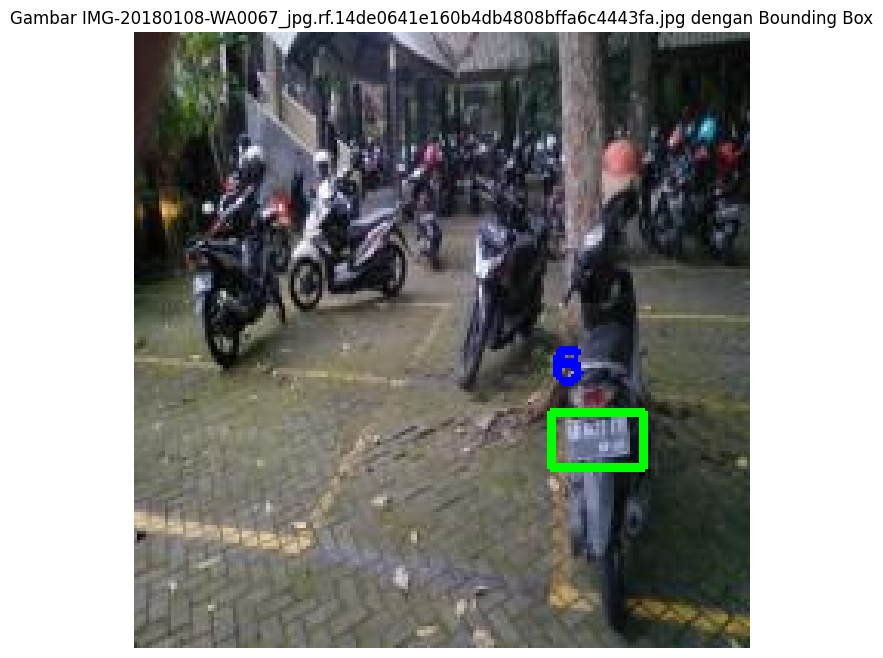

Label ditemukan untuk 342-E-2544-QD-11-18_jpeg.rf.76c5a88f0927395cfbc4e2e9cb2f9f29.jpg


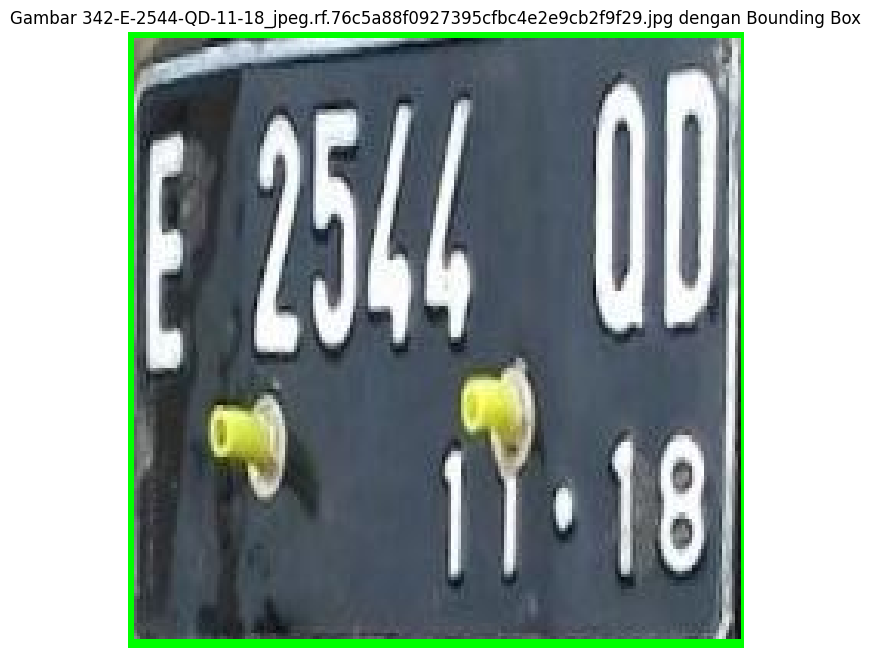

Label ditemukan untuk 331-E-2843-HB-08-21_jpeg.rf.80eb22dcd7638d804961ea7978bc3d84.jpg


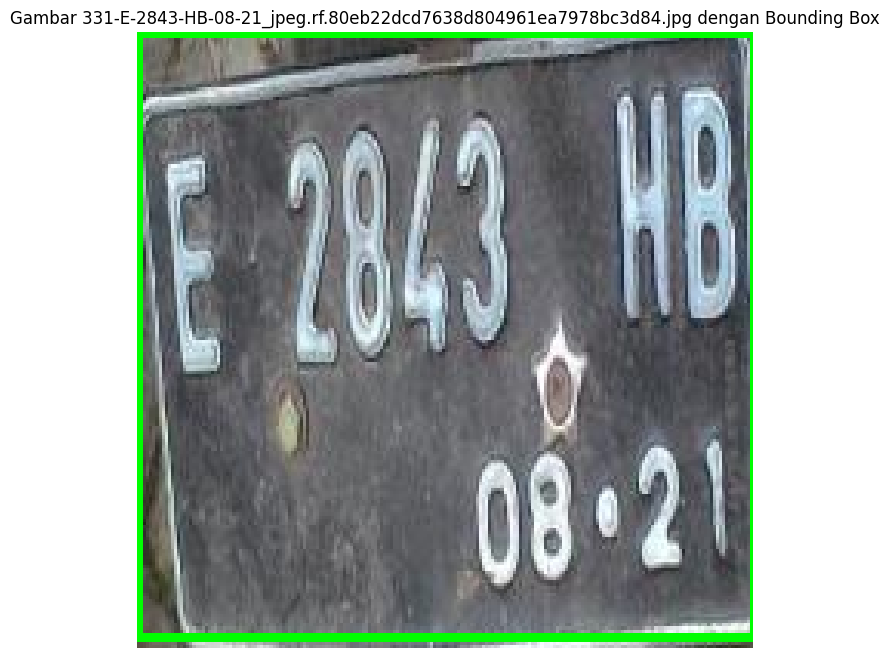

Label ditemukan untuk IMG-20180108-WA0054_jpg.rf.9fb7b465c8a8489fca526b558c825616.jpg


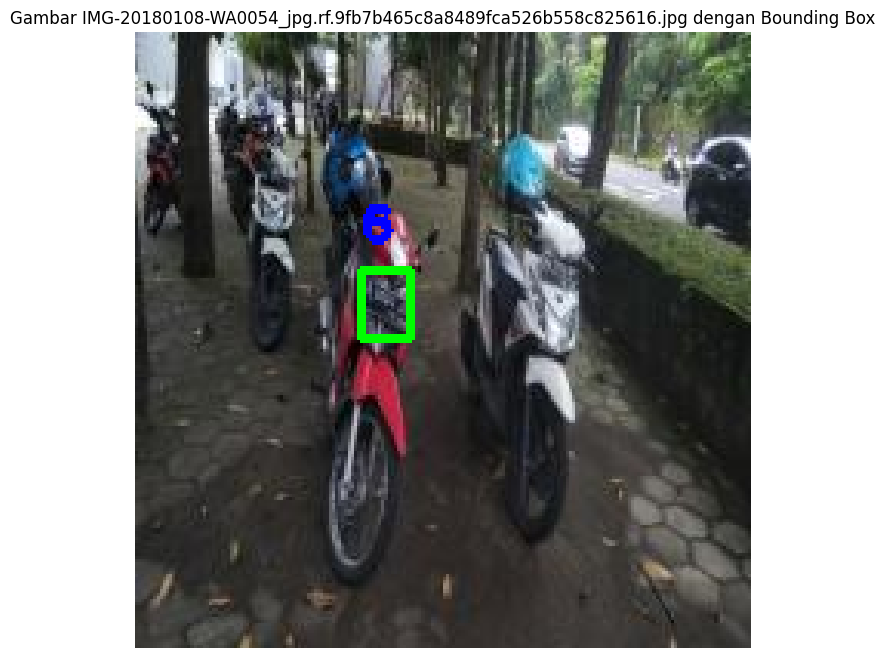

Label ditemukan untuk 20171211_084300_jpg.rf.b2100aa6f5ba9ede38b8532e44645944.jpg


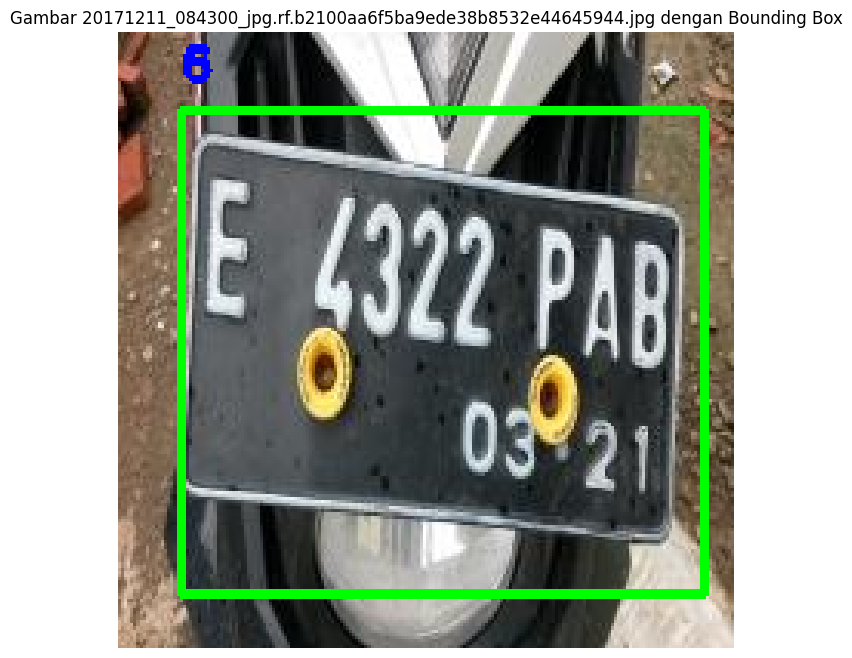

Label ditemukan untuk license-10-_jpg.rf.978e17eae23c21e70bbfe047bf7189b3.jpg


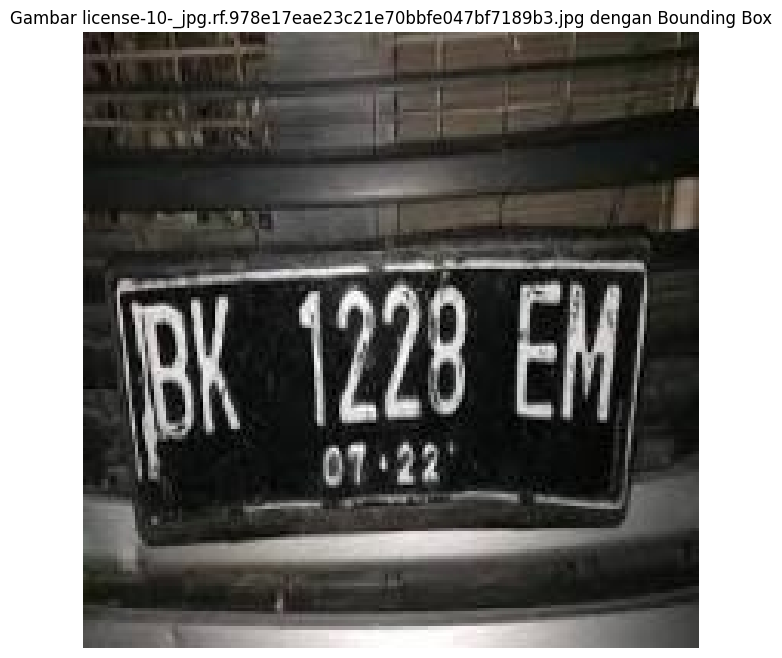

Label ditemukan untuk license-52-_jpg.rf.f278f300c6266ad3ac36b0c0798c4a89.jpg


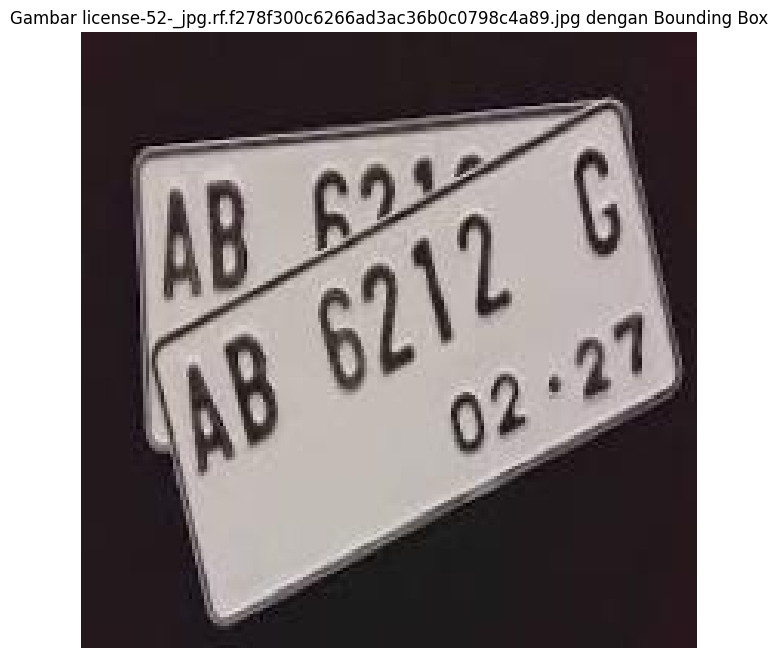

Label ditemukan untuk IMG-20180108-WA0044_jpg.rf.77bcc5ea53bfcb26531d25299c95286c.jpg


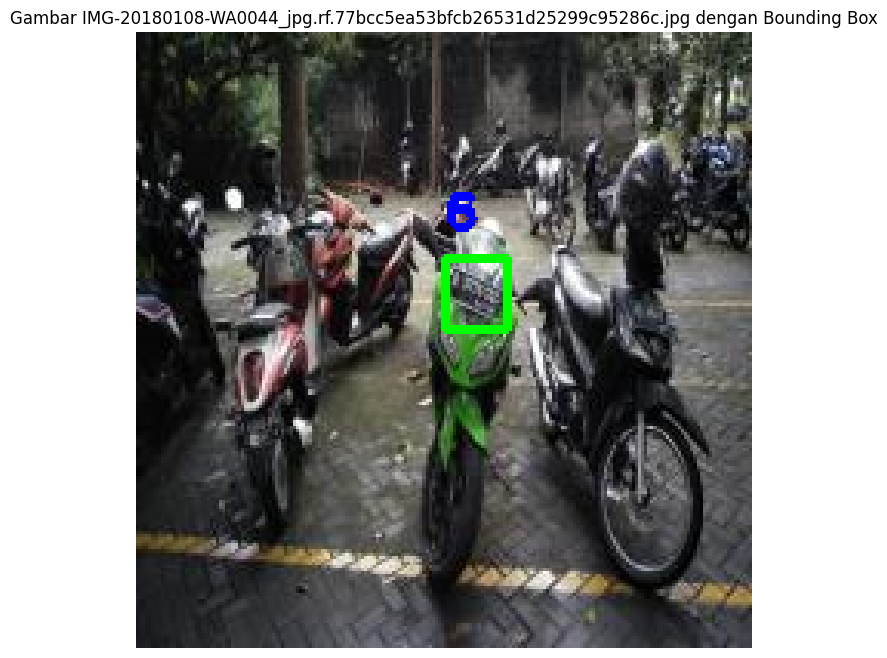

Label ditemukan untuk 203-E-3071-TC-10-21_jpg.rf.163ba779e77c798ad3dbaecead53bb74.jpg


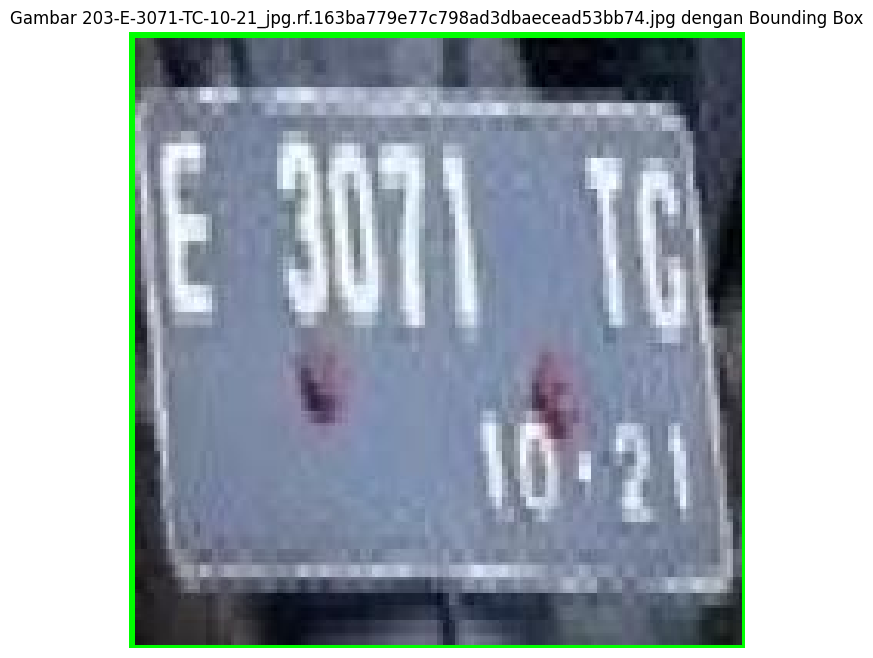

In [29]:
def read_yolo_label(label_path): #Fungsi ini mengambil argumen label_path, yaitu jalur file label YOLO
    boxes = [] #Variabel boxes adalah list kosong yang digunakan untuk menyimpan informasi bounding box yang ditemukan
    with open(label_path, 'r') as file: #File label di jalur label_path dibuka dalam mode baca ('r')
        for line in file: #Iterasi membaca setiap baris dalam file.
            data = line.strip().split() #Fungsi strip() menghapus karakter spasi atau newline (\n) di awal/akhir baris
            if len(data) == 5: #Baris valid dalam file YOLO harus memiliki 5 elemen, Jika baris tidak memenuhi syarat ini, fungsi akan mengabaikannya tanpa menambahkan ke list
                class_id, center_x, center_y, width, height = map(float, data) #Fungsi map(float, data) mengonversi setiap elemen data ke tipe data float
                boxes.append((class_id, center_x, center_y, width, height)) #Tuple (class_id, center_x, center_y, width, height) ditambahkan ke list boxes
    return boxes #Fungsi mengembalikan seluruh daftar bounding box yang sudah dikumpulkan.

def yolo_to_bbox(image, bbox):
    h, w, _ = image.shape  #h adalah tinggi objek, w adalah lebar objek,_ adalah jumlah kanal, image.shape= mengembalikan (tinggi, lebar, jumlah_channel).
    center_x, center_y, box_width, box_height = bbox  # Koordinat pusat bounding box . Lebar dan tinggi bounding box
    x_min = int((center_x - box_width / 2) * w)  #Kode ini menghitung koordinat x kiri atas bounding box dari pusat dan lebarnya.
    y_min = int((center_y - box_height / 2) * h)  #Kode ini menghitung y teratas dari kotak berdasarkan pusat dan tinggi gambar.
    x_max = int((center_x + box_width / 2) * w)  #Kode ini menghitung x terjauh (kanan) dari kotak berdasarkan pusat dan lebar gambar.
    y_max = int((center_y + box_height / 2) * h)  #Kode ini menghitung y terbawah dari kotak berdasarkan pusat dan tinggi gambar.
    return (x_min, y_min, x_max, y_max)  #mengembalikan hasil perhitungan bounding bo dalam format koordinat absolut

for image_file in image_files:  #Kode ini berarti melakukan perulangan untuk setiap file dalam daftar `image_files`.
    image_path = os.path.join(image_dir, image_file)  #Kode ini menggabungkan folder dan nama file untuk membentuk path lengkap gambar.
    label_path = os.path.join(label_dir, image_file.replace('.jpg', '.txt')) #Membuat path file label dengan mengganti ekstensi `.jpg` pada nama file gambar menjadi `.txt` lalu menggabungkannya dengan folder label.

    if not os.path.exists(label_path):#Pernyataan ini memeriksa apakah path yang ada di variabel `label_path` tidak ada di sistem file, dan menjalankan kode jika path tersebut tidak ditemukan.
        print(f"Label tidak ditemukan untuk {image_file}") #Ini akan mencetak pesan yang memberitahukan bahwa label untuk file gambar yang disebutkan tidak ditemukan.
        continue #Melanjutkan ke iterasi berikutnya, melewati proses gambar tersebut tanpa error

    print(f"Label ditemukan untuk {image_file}") #Mencetak pesan yang menampilkan bahwa label telah ditemukan untuk file gambar tertentu.

    image = cv2.imread(image_path) #digunakan untuk membaca gambar dari file yang terletak di path yang diberikan (image_path) dan menyimpannya ke dalam variabel image.
    if image is None:  #Memeriksa apakah variabel image kosong atau tidak berisi objek gambar.
        print(f"Gambar {image_file} tidak dapat dibaca.") #Menampilkan pesan kesalahan yang memberitahukan bahwa gambar yang disebutkan dalam variabel image_file tidak bisa dibaca.
        continue  #Melanjutkan ke iterasi berikutnya, melewati proses gambar tersebut tanpa error

    labels = read_yolo_label(label_path) #Membaca file label YOLO dari path yang ada pada variabel label_path dan menyimpannya dalam variabel labels.

    for label in labels: #Melakukan iterasi atau perulangan pada setiap elemen yang ada dalam list atau koleksi labels.
        class_id, center_x, center_y, width, height = label  #Membagi nilai dari label ke dalam variabel class_id, center_x, center_y, width, dan height untuk menyimpan informasi tentang objek dalam gambar.
        bbox_coords = yolo_to_bbox(image, (center_x, center_y, width, height)) #Pernyataan ini mengonversi koordinat bounding box dalam format YOLO (pusat dan ukuran) ke dalam format koordinat kotak pembatas pada gambar.
        cv2.rectangle(image, (bbox_coords[0], bbox_coords[1]), (bbox_coords[2], bbox_coords[3]), (0, 255, 0), 2) #Menggambar persegi panjang pada gambar menggunakan koordinat bbox_coords, dengan warna hijau (0, 255, 0) dan ketebalan garis 2 piksel.
        cv2.putText(image, str(int(class_id)), (bbox_coords[0], bbox_coords[1] - 10),  #menambahkan teks yang berisi class_id pada gambar di posisi sedikit di atas koordinat awal bounding box.
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)  #Menambahkan teks di gambar dengan font "HERSHEY_SIMPLEX", ukuran 0.5, warna merah, dan ketebalan garis 2.

    plt.figure(figsize=(8, 8)) #Membuat sebuah figure baru dengan ukuran lebar dan tinggi 8 inci pada plot menggunakan Matplotlib.
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  #Mengubah format warna gambar dari BGR ke RGB dan menampilkannya menggunakan plt.imshow.
    plt.axis('off')  #Menyembunyikan axis (garis pengukur) pada gambar
    plt.title(f"Gambar {image_file} dengan Bounding Box")  #Memberikan judul pada gambar yang akan ditampilkan
    plt.show() #Menampilkan grafik atau plot yang telah dibuat dengan Matplotlib di jendela visualisasi.

In [30]:
def validate_bbox(image, bbox):  #Memeriksa apakah bounding box (bbox) valid dan berada dalam area gambar (image).
    """Pastikan bounding box berada dalam dimensi gambar."""
    h, w, _ = image.shape #h adalah tinggi objek, w adalah lebar objek,_ adalah jumlah kanal, image.shape= mengembalikan (tinggi, lebar, jumlah_channel).
    x_min, y_min, x_max, y_max = bbox #Membagi nilai bounding box bbox menjadi empat variabel: x_min, y_min, x_max, dan y_max yang mewakili koordinat batas.
    x_min = max(0, x_min)  #Memastikan bahwa nilai x_min tidak kurang dari 0, sehingga jika x_min lebih kecil dari 0, nilainya akan diubah menjadi 0.
    y_min = max(0, y_min)  #Memastikan bahwa nilai y_min tidak akan kurang dari 0, menggantinya dengan 0 jika nilainya lebih kecil dari 0.
    x_max = min(w, x_max)  #Menetapkan nilai x_max sebagai nilai terkecil antara w dan x_max.
    y_max = min(h, y_max)  #mengatur nilai y_max menjadi nilai terkecil antara h dan y_max, sehingga y_max tidak akan melebihi h.
    return (x_min, y_min, x_max, y_max)  #Mengembalikan nilai berupa tuple yang berisi koordinat batas minimum dan maksimum pada sumbu x dan y.

def yolo_to_bbox(image, yolo_coords):
    """Mengonversi koordinat YOLO menjadi bounding box."""
    h, w, _ = image.shape  # Ambil dimensi gambar
    center_x, center_y, width, height = yolo_coords  # Ambil koordinat YOLO
    x_min = int((center_x - width / 2) * w)  # Hitung x_min absolut
    y_min = int((center_y - height / 2) * h)  # Hitung y_min absolut
    x_max = int((center_x + width / 2) * w)  # Hitung x_max absolut
    y_max = int((center_y + height / 2) * h)  # Hitung y_max absolut
    return (x_min, y_min, x_max, y_max)  # Kembalikan koordinat bounding box

def validate_bbox(image, bbox):
    """Pastikan bounding box berada dalam dimensi gambar."""
    h, w, _ = image.shape  # Ambil dimensi gambar
    x_min, y_min, x_max, y_max = bbox  # Pisahkan koordinat bounding box
    x_min = max(0, x_min)  # Pastikan x_min >= 0. koordinat horizontal paling kiri
    y_min = max(0, y_min)  # Pastikan y_min >= 0. koordinat vertikal paling atas
    x_max = min(w, x_max)  # Pastikan x_max <= lebar gambar. koordinat horizontal paling kanan
    y_max = min(h, y_max)  # Pastikan y_max <= tinggi gambar. koordinat horizontal paling bawah
    return (x_min, y_min, x_max, y_max)  # Kembalikan bounding box yang tervalidasi

def preprocess_image(image):
    """Melakukan preprocessing pada gambar sebelum OCR."""
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Konversi gambar ke grayscale
    return cv2.threshold(gray_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]  #line ini mengonversi gambar grayscale menjadi gambar biner (hitam-putih)
    #THRESH_BINARY : Piksel di atas threshold diubah menjadi putih (255), dan di bawah threshold menjadi hitam (0), 255 adalah nilai maksimum yang diberikan pada piksel yang memenuhi kriteria threshold.
    #THRES_OTSU : Menentukan threshold secara otomatis berdasarkan distribusi intensitas piksel pada gambar.
def extract_plate_number(image, bbox, debug_dir, image_file, bbox_index):
    """Menggunakan OCR untuk mengekstrak teks dari area bounding box."""
    bbox = validate_bbox(image, bbox)  # Validasi bounding box
    x_min, y_min, x_max, y_max = bbox  # Pisahkan koordinat bounding box
    cropped_image = image[y_min:y_max, x_min:x_max]  # Potong gambar sesuai bounding box

    if cropped_image.size == 0:  # Cek apakah hasil crop kosong
        return "Bounding Box Kosong"

    debug_crop_path = os.path.join(debug_dir, f"cropped_{image_file}_{bbox_index}.jpg")  # Path untuk hasil debug
    cv2.imwrite(debug_crop_path, cropped_image)  # Simpan hasil crop untuk debugging

    preprocessed_image = preprocess_image(cropped_image)  # Lakukan preprocessing
    try:
        # Gunakan OCR untuk membaca teks dari gambar
        plate_number = pytesseract.image_to_string(preprocessed_image, config='--psm 7 -c tessedit_char_whitelist=0123456789ABCDEFGHIJKLMNOPQRSTUVWXYZ') #psm7 untuk mengonsumsikan gambar hanya memiliki satu baris teks dan cocok untuk mendeteksi plat nomor
        print(f"OCR Result for {image_file}, BBox {bbox_index}: {plate_number.strip()}")  # Debugging hasil OCR
        return plate_number.strip()  # Kembalikan hasil OCR
    except Exception as e:
        print(f"Error OCR pada bounding box: {e}")  # Tangkap kesalahan OCR
        return "OCR Error"

# Direktori dataset
image_dir = '/content/ANPR-test-2/valid/images'  # Folder gambar input
label_dir = '/content/ANPR-test-2/valid/labels'  # Folder label YOLO
debug_dir = './debug_crops'  # Folder untuk hasil debug

os.makedirs(debug_dir, exist_ok=True)  # Buat folder debug jika belum ada

image_files = [f for f in os.listdir(image_dir) if f.endswith('.jpg')]  # Ambil semua file gambar .jpg
results = []  # List untuk menyimpan hasil

for image_file in image_files:  # Loop untuk setiap file gambar
    image_path = os.path.join(image_dir, image_file)  # Path gambar
    label_path = os.path.join(label_dir, image_file.replace('.jpg', '.txt'))  # Path label

    if not os.path.exists(label_path):  # Jika label tidak ditemukan
        print(f"Label tidak ditemukan untuk {image_file}")  # Pesan error
        continue

    print(f"Memproses {image_file}")  # Debugging proses

    image = cv2.imread(image_path)  # Baca gambar
    if image is None:  # Jika gambar gagal dibaca
        print(f"Gambar {image_file} tidak dapat dibaca.")  # Pesan error
        continue

    labels = read_yolo_label(label_path)  # Baca file label YOLO
    for bbox_index, label in enumerate(labels):  # Loop setiap label
        class_id, center_x, center_y, width, height = label  # Pisahkan label
        bbox_coords = yolo_to_bbox(image, (center_x, center_y, width, height))  # Konversi YOLO ke bbox
        plate_number = extract_plate_number(image, bbox_coords, debug_dir, image_file, bbox_index)  # Ekstraksi nomor plat

        results.append({  # Tambahkan hasil ke dalam list
            'File Gambar': image_file,
            'ID Kelas': class_id,
            'Tengah X': center_x,
            'Tengah Y': center_y,
            'Lebar': width,
            'Tinggi': height,
            'X_min': bbox_coords[0],
            'Y_min': bbox_coords[1],
            'X_max': bbox_coords[2],
            'Y_max': bbox_coords[3],
            'Nomor Plat': plate_number
        })

df = pd.DataFrame(results)  # Buat DataFrame dari hasil
output_excel_path = "output_plate_numbers.xlsx"  # Path untuk file output
df.to_excel(output_excel_path, index=False, engine='openpyxl')  # Simpan DataFrame ke Excel

print(f"Hasil telah disimpan ke {output_excel_path}")  # Debugging output
print(f"Hasil crop disimpan di folder {debug_dir}")  # Debugging hasil crop

Memproses 141-E-3860-PAK-02-22_jpeg.rf.354dfd47611f965c7f2f17d34b120e5e.jpg
OCR Result for 141-E-3860-PAK-02-22_jpeg.rf.354dfd47611f965c7f2f17d34b120e5e.jpg, BBox 0: 
Memproses 294-E-2381-QAA-10-22_jpeg.rf.e5535c862ed012c724d1d824efce2ee9.jpg
OCR Result for 294-E-2381-QAA-10-22_jpeg.rf.e5535c862ed012c724d1d824efce2ee9.jpg, BBox 0: 
Memproses 344-E-6393-TZ-07-18_jpeg.rf.929eb4ce4557f1d0b7cc139231421c4c.jpg
OCR Result for 344-E-6393-TZ-07-18_jpeg.rf.929eb4ce4557f1d0b7cc139231421c4c.jpg, BBox 0: 6389
Memproses 357-E-4679-PAD-06-21_jpg.rf.eb065d4dfef48e7a3d4aec0a52969428.jpg
OCR Result for 357-E-4679-PAD-06-21_jpg.rf.eb065d4dfef48e7a3d4aec0a52969428.jpg, BBox 0: 
Memproses 154-E-6151-PAL-04-22_jpg.rf.9786b8a7ba41a4779e368dbfdbf0d97f.jpg
Memproses license-5-_jpg.rf.6c5fdf0d740a7859ebe451116015b62c.jpg
OCR Result for license-5-_jpg.rf.6c5fdf0d740a7859ebe451116015b62c.jpg, BBox 0: 
Memproses IMG-20180108-WA0069_jpg.rf.d59315a2c4227f20b2b3a57f2a481f37.jpg
Memproses 196-E-6843-SV-06-21_jpeg.rf.